# Rainfall Prediction - Weather Forecasting


### Problem Statement:

Rain Prediction –Weather forecasting

Weather forecasting is the application of science and technology to predict the conditions of the atmosphere for a given location and time. Weather forecasts are made by collecting quantitative data about the current state of the atmosphere at a given place and using meteorology to project how the atmosphere will change.

Rain Dataset is to predict whether or not it will rain tomorrow. The Dataset contains about 10 years of daily weather observations of different locations in Australia. Here, predict two things:
 
### 1. Problem Statement: 

#### a) Design a predictive model with the use of machine learning algorithms to forecast whether or not it will rain tomorrow.

#### b)  Design a predictive model with the use of machine learning algorithms to predict how much rainfall could be there.


### Dataset Description:

### Number of columns: 23


#### Date  - The date of observation

#### Location  -The common name of the location of the weather station

#### MinTemp  -The minimum temperature in degrees celsius

#### MaxTemp -The maximum temperature in degrees celsius

#### Rainfall  -The amount of rainfall recorded for the day in mm

#### Evaporation  -The so-called Class A pan evaporation (mm) in the 24 hours to 9am

#### Sunshine  -The number of hours of bright sunshine in the day.

#### WindGustDi r- The direction of the strongest wind gust in the 24 hours to midnight

#### WindGustSpeed -The speed (km/h) of the strongest wind gust in the 24 hours to midnight

#### WindDir9am -Direction of the wind at 9am

#### WindDir3pm -Direction of the wind at 3pm

#### WindSpeed9am -Wind speed (km/hr) averaged over 10 minutes prior to 9am

#### WindSpeed3pm -Wind speed (km/hr) averaged over 10 minutes prior to 3pm

#### Humidity9am -Humidity (percent) at 9am

#### Humidity3pm -Humidity (percent) at 3pm

#### Pressure9am -Atmospheric pressure (hpa) reduced to mean sea level at 9am

#### Pressure3pm -Atmospheric pressure (hpa) reduced to mean sea level at 3pm

#### Cloud9am - Fraction of sky obscured by cloud at 9am. 

#### Cloud3pm -Fraction of sky obscured by cloud 

#### Temp9am-Temperature (degrees C) at 9am

#### Temp3pm -Temperature (degrees C) at 3pm

#### RainToday -Boolean: 1 if precipitation (mm) in the 24 hours to 9am exceeds 1mm, otherwise 0

#### RainTomorrow -The amount of next day rain in mm. Used to create response variable . A kind of measure of the "risk".

In [82]:
# Importing the libraries
import numpy as np 
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.stats as st
%matplotlib inline

import warnings
warnings.filterwarnings('ignore')

In [83]:
# SETTING A customized plot style,font, figure and color
sns.set_style('darkgrid')
plt.rcParams['font.size'] = 15
plt.rcParams['figure.figsize'] = (10,7)
plt.rcParams['figure.facecolor'] = '#FFE554'

In [84]:
# loading the data
rain = pd.read_csv('https://raw.githubusercontent.com/dsrscientist/dataset3/main/weatherAUS.csv')
# importing data from github directly

In [85]:
# looking at the shape
rain.shape

# There are more than 7000 rows and 21 columns

(8425, 23)

In [86]:
# Inorder to view all the columns while printing we are setting an option to display the maximum columns and rows
pd.set_option('display.max_columns',None)
pd.set_option('display.max_rows',None)

In [87]:
# looking at the first 20 rows
rain.head(20)

# We can observe that categorical variables are more compared to the continuous ones

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,WNW,20.0,24.0,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No
1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,WSW,4.0,22.0,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No
2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,WSW,19.0,26.0,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No
3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,E,11.0,9.0,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,No
4,2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,NW,7.0,20.0,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No
5,2008-12-06,Albury,14.6,29.7,0.2,NaN,NaN,WNW,56.0,W,W,19.0,24.0,55.0,23.0,1009.2,1005.4,NaN,NaN,20.6,28.9,No,No
6,2008-12-07,Albury,14.3,25.0,0.0,NaN,NaN,W,50.0,SW,W,20.0,24.0,49.0,19.0,1009.6,1008.2,1.0,NaN,18.1,24.6,No,No
7,2008-12-08,Albury,7.7,26.7,0.0,NaN,NaN,W,35.0,SSE,W,6.0,17.0,48.0,19.0,1013.4,1010.1,NaN,NaN,16.3,25.5,No,No
8,2008-12-09,Albury,9.7,31.9,0.0,NaN,NaN,NNW,80.0,SE,NW,7.0,28.0,42.0,9.0,1008.9,1003.6,NaN,NaN,18.3,30.2,No,Yes
9,2008-12-10,Albury,13.1,30.1,1.4,NaN,NaN,W,28.0,S,SSE,15.0,11.0,58.0,27.0,1007.0,1005.7,NaN,NaN,20.1,28.2,Yes,No


In [88]:
# looking at the last 20 rows
rain.tail(20)

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
8405,2017-06-06,Uluru,1.2,20.8,0.0,NaN,NaN,E,43.0,ESE,E,13.0,28.0,29.0,6.0,1029.8,1025.9,NaN,NaN,7.9,19.9,No,No
8406,2017-06-07,Uluru,0.5,21.7,0.0,NaN,NaN,E,43.0,ESE,ENE,13.0,20.0,27.0,19.0,1029.0,1025.0,NaN,NaN,9.5,20.5,No,No
8407,2017-06-08,Uluru,4.0,20.0,0.0,NaN,NaN,SE,39.0,ESE,ESE,13.0,26.0,58.0,26.0,1030.2,1026.7,NaN,NaN,9.1,19.0,No,No
8408,2017-06-09,Uluru,3.4,19.8,0.0,NaN,NaN,E,43.0,ESE,E,19.0,24.0,54.0,23.0,1031.8,1027.7,NaN,NaN,8.7,18.9,No,No
8409,2017-06-10,Uluru,3.2,18.6,0.0,NaN,NaN,E,46.0,ESE,E,15.0,20.0,56.0,29.0,1031.0,1027.2,NaN,NaN,8.2,17.4,No,No
8410,2017-06-11,Uluru,2.4,19.1,0.0,NaN,NaN,E,33.0,SE,E,17.0,17.0,59.0,24.0,1030.0,1026.2,NaN,NaN,8.0,18.8,No,No
8411,2017-06-12,Uluru,5.1,19.7,0.0,NaN,NaN,E,46.0,ESE,E,13.0,17.0,56.0,29.0,1028.5,1025.8,NaN,NaN,8.5,19.2,No,No
8412,2017-06-13,Uluru,2.5,21.2,0.0,NaN,NaN,ENE,35.0,ESE,E,17.0,19.0,57.0,32.0,1027.2,1023.0,NaN,NaN,10.3,20.3,No,No
8413,2017-06-14,Uluru,2.3,21.4,0.0,NaN,NaN,SE,22.0,SE,SSE,11.0,7.0,60.0,28.0,1026.9,1022.8,NaN,NaN,8.9,20.3,No,No
8414,2017-06-15,Uluru,2.6,22.5,0.0,NaN,NaN,S,19.0,S,E,9.0,7.0,59.0,24.0,1025.0,1021.4,NaN,NaN,8.8,22.1,No,No


In [89]:
# looking at random rows now
rain.sample(20)

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
1452,2010-09-06,CoffsHarbour,14.2,19.7,0.0,5.8,9.0,WSW,28.0,WSW,E,19.0,13.0,35.0,37.0,1020.7,1017.5,1.0,1.0,18.0,19.1,No,No
1721,2013-12-29,Newcastle,18.1,23.5,0.0,NaN,NaN,NaN,NaN,SE,SE,37.0,37.0,78.0,54.0,NaN,NaN,8.0,7.0,22.3,23.0,No,No
8144,2012-03-14,Darwin,24.1,29.8,142.2,NaN,0.5,WNW,78.0,WNW,NW,33.0,28.0,98.0,84.0,1005.9,1002.5,8.0,8.0,24.5,28.3,Yes,Yes
1286,2010-03-24,CoffsHarbour,16.0,26.7,0.0,2.6,10.6,ESE,22.0,WSW,E,7.0,15.0,75.0,65.0,1020.2,1019.2,1.0,2.0,22.1,26.2,No,No
4713,2010-04-16,Melbourne,13.2,25.9,0.0,1.6,9.8,NNE,44.0,NNE,NNE,7.0,20.0,74.0,32.0,1026.1,1022.0,4.0,2.0,15.3,24.7,No,No
1170,2009-11-28,CoffsHarbour,19.2,29.8,0.0,5.2,9.9,N,52.0,ESE,NE,9.0,24.0,61.0,57.0,1008.0,1004.9,1.0,1.0,27.7,28.4,No,Yes
4480,2009-06-10,Wollongong,8.2,13.8,0.0,NaN,NaN,W,80.0,WSW,W,35.0,26.0,46.0,40.0,1010.0,1012.6,NaN,NaN,9.5,12.9,No,No
7438,2012-05-17,PerthAirport,6.8,21.4,0.0,2.0,5.1,ENE,22.0,NE,WSW,9.0,9.0,82.0,45.0,1020.4,1017.8,6.0,7.0,13.8,20.6,No,No
7710,2013-04-13,PerthAirport,19.3,27.4,1.8,1.6,0.4,NNE,31.0,SSW,SE,9.0,19.0,76.0,47.0,1016.4,1013.9,7.0,7.0,22.0,27.1,Yes,No
5073,2011-05-11,Melbourne,6.9,12.2,4.2,2.0,7.0,WSW,59.0,W,W,28.0,30.0,71.0,76.0,1010.5,1009.1,7.0,7.0,8.4,9.9,Yes,Yes


In [90]:
# looking at the info of the data
rain.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8425 entries, 0 to 8424
Data columns (total 23 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Date           8425 non-null   object 
 1   Location       8425 non-null   object 
 2   MinTemp        8350 non-null   float64
 3   MaxTemp        8365 non-null   float64
 4   Rainfall       8185 non-null   float64
 5   Evaporation    4913 non-null   float64
 6   Sunshine       4431 non-null   float64
 7   WindGustDir    7434 non-null   object 
 8   WindGustSpeed  7434 non-null   float64
 9   WindDir9am     7596 non-null   object 
 10  WindDir3pm     8117 non-null   object 
 11  WindSpeed9am   8349 non-null   float64
 12  WindSpeed3pm   8318 non-null   float64
 13  Humidity9am    8366 non-null   float64
 14  Humidity3pm    8323 non-null   float64
 15  Pressure9am    7116 non-null   float64
 16  Pressure3pm    7113 non-null   float64
 17  Cloud9am       6004 non-null   float64
 18  Cloud3pm

In [91]:
# descriptive summary of the data
rain.describe().T

# We can obsereve there can be alot of outliers in the data
# And the data is highly skewed

,count,mean,std,min,25%,50%,75%,max
MinTemp,8350.0,13.193305,5.403596,-2.0,9.20,13.3,17.4,28.5
MaxTemp,8365.0,23.859976,6.136408,8.2,19.30,23.3,28.0,45.5
Rainfall,8185.0,2.805913,10.459379,0.0,0.00,0.0,1.0,371.0
Evaporation,4913.0,5.389395,5.044484,0.0,2.60,4.6,7.0,145.0
Sunshine,4431.0,7.632205,3.896235,0.0,4.75,8.7,10.7,13.9
WindGustSpeed,7434.0,40.174469,14.665721,7.0,30.00,39.0,50.0,107.0
WindSpeed9am,8349.0,13.847646,10.174579,0.0,6.00,13.0,20.0,63.0
WindSpeed3pm,8318.0,18.533662,9.766986,0.0,11.00,19.0,24.0,83.0
Humidity9am,8366.0,67.822496,16.833283,10.0,56.00,68.0,80.0,100.0
Humidity3pm,8323.0,51.249790,18.423774,6.0,39.00,51.0,63.0,99.0


In [92]:
# looking at the categorical variables as well
rain.describe(include='O').T

,count,unique,top,freq
Date,8425,3004,2011-01-31,5
Location,8425,12,Melbourne,1622
WindGustDir,7434,16,N,713
WindDir9am,7596,16,N,906
WindDir3pm,8117,16,SE,813
RainToday,8185,2,No,6195
RainTomorrow,8186,2,No,6195


## CHECKING THE NULL VALUES

In [93]:
rain.isnull().sum()

# We can observe there are null value in almost all the columns

Date                0
Location            0
MinTemp            75
MaxTemp            60
Rainfall          240
Evaporation      3512
Sunshine         3994
WindGustDir       991
WindGustSpeed     991
WindDir9am        829
WindDir3pm        308
WindSpeed9am       76
WindSpeed3pm      107
Humidity9am        59
Humidity3pm       102
Pressure9am      1309
Pressure3pm      1312
Cloud9am         2421
Cloud3pm         2455
Temp9am            56
Temp3pm            96
RainToday         240
RainTomorrow      239
dtype: int64

In [94]:
# checking duplicates first
duplicates = rain[rain.duplicated()]
duplicates.shape

# We cannot drop the duplicates now because as there are plenty of null values 
#dropping them doesn't make any sense now
# However we can deal with them after imputing the null values

(1663, 23)

In [95]:
# checking if any other column has blank values(' '),special characters(?,-,_) etc to make sure the data is clean

chars =[" ","?","-"," ?"," -","? ","- "," ? "," - ","NA","N/A"," NA"," N/A"]

for i in rain.columns:
    for j in chars:
        print(f"{j} in {i} = ",end= " ")
        print((rain[i] == j).sum())

  in Date =  0
? in Date =  0
- in Date =  0
 ? in Date =  0
 - in Date =  0
?  in Date =  0
-  in Date =  0
 ?  in Date =  0
 -  in Date =  0
NA in Date =  0
N/A in Date =  0
 NA in Date =  0
 N/A in Date =  0
  in Location =  0
? in Location =  0
- in Location =  0
 ? in Location =  0
 - in Location =  0
?  in Location =  0
-  in Location =  0
 ?  in Location =  0
 -  in Location =  0
NA in Location =  0
N/A in Location =  0
 NA in Location =  0
 N/A in Location =  0
  in MinTemp =  0
? in MinTemp =  0
- in MinTemp =  0
 ? in MinTemp =  0
 - in MinTemp =  0
?  in MinTemp =  0
-  in MinTemp =  0
 ?  in MinTemp =  0
 -  in MinTemp =  0
NA in MinTemp =  0
N/A in MinTemp =  0
 NA in MinTemp =  0
 N/A in MinTemp =  0
  in MaxTemp =  0
? in MaxTemp =  0
- in MaxTemp =  0
 ? in MaxTemp =  0
 - in MaxTemp =  0
?  in MaxTemp =  0
-  in MaxTemp =  0
 ?  in MaxTemp =  0
 -  in MaxTemp =  0
NA in MaxTemp =  0
N/A in MaxTemp =  0
 NA in MaxTemp =  0
 N/A in MaxTemp =  0
  in Rainfall =  0
? in Ra

In [96]:
# total no.of null values
rain.isnull().sum().sum()

# There are total around 19500 null values

19472

In [97]:
# checking the % of null values in each column
for i in rain.columns:
    print('% of null values in',i,': ',round(rain[i].isnull().sum()/8425*100,1),'dtype: ',rain[i].dtype)
    print('\n')
    
# We can see Sunshine, Evaporation are having almost 48% and 41% null values,Cloud9am,Cloud3pm has 28% and 29% respectively
# And Pressure9am,Pressure3pm,WindgustDir and Speed are having more than 10% of null values.
# Rest of the columns are less than 5% of null values 

% of null values in Date :  0.0 dtype:  object


% of null values in Location :  0.0 dtype:  object


% of null values in MinTemp :  0.9 dtype:  float64


% of null values in MaxTemp :  0.7 dtype:  float64


% of null values in Rainfall :  2.8 dtype:  float64


% of null values in Evaporation :  41.7 dtype:  float64


% of null values in Sunshine :  47.4 dtype:  float64


% of null values in WindGustDir :  11.8 dtype:  object


% of null values in WindGustSpeed :  11.8 dtype:  float64


% of null values in WindDir9am :  9.8 dtype:  object


% of null values in WindDir3pm :  3.7 dtype:  object


% of null values in WindSpeed9am :  0.9 dtype:  float64


% of null values in WindSpeed3pm :  1.3 dtype:  float64


% of null values in Humidity9am :  0.7 dtype:  float64


% of null values in Humidity3pm :  1.2 dtype:  float64


% of null values in Pressure9am :  15.5 dtype:  float64


% of null values in Pressure3pm :  15.6 dtype:  float64


% of null values in Cloud9am :  28.7 dtype:  float64

<AxesSubplot:>

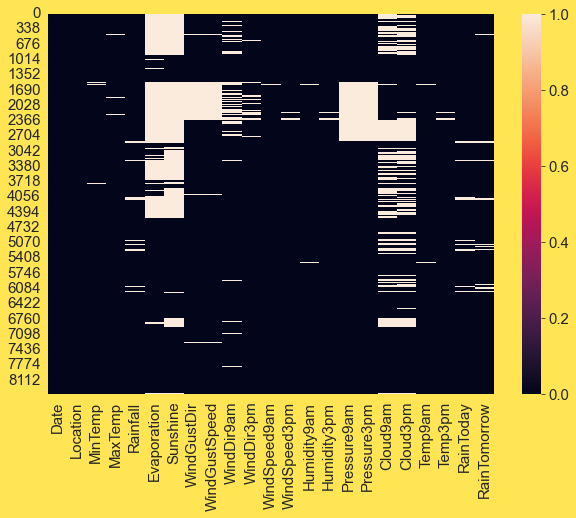

In [98]:
# plottimg a heatmap
sns.heatmap(rain.isnull())

# We can see there isn't any pattern in mising values
# Although some columns are affecting the preceding next column value to be null

In [99]:
# We can see that our target columns have 2.8% of null values respectively
# looking at the unique values of classification target Rain_tomorrow
rain['RainTomorrow'].value_counts()

# We can see that target is imbalanced we have to treat it before model building

No     6195
Yes    1991
Name: RainTomorrow, dtype: int64

In [100]:
# getting the info about the cat and continuous columns

# getting the numerical features
numerical_features = [feature for feature in rain.columns if rain[feature].dtypes != 'O']

# discrete features means which are like integers without any floating values
discrete_features = [feature for feature in numerical_features if len(rain[feature].unique())<25]

# continuous features
continuous_features = [feature for feature in numerical_features if feature not in discrete_features]

# Categorcal
categorical_features = [feature for feature in rain.columns if feature not in numerical_features]

# Columns which are having two categorical values
binary_categorical_features = [feature for feature in categorical_features if len(rain[feature].unique()) <=3]

print("Numerical Features Count {}".format(len(numerical_features)))
print("Discrete features Count {}".format(len(discrete_features)))
print("Continuous features Count {}".format(len(continuous_features)))
print("Categorical features Count {}".format(len(categorical_features)))
print("Binary Categorical features Count {}".format(len(binary_categorical_features)))

Numerical Features Count 16
Discrete features Count 2
Continuous features Count 14
Categorical features Count 7
Binary Categorical features Count 2


In [101]:
#Imputing the null values

In [102]:
# Before imputing the values let's go ahead and plot the continous variables and look at the distribution
def cont_cols_distribution(rain,continuous_features):
    # creating a  copy of dataframe
    data = rain[continuous_features].copy()
    # subplots 
    fig, axes = plt.subplots(nrows=len(data.columns)//2, ncols=2,figsize=(15,20))
    fig.subplots_adjust(hspace=0.7)
    
    # our main distplot
    for ax, feature in zip(axes.flatten(), data.columns):
        sns.distplot(data[feature],ax=ax)
        ax.set_title(f'Analysis of {feature}')
    plt.show()

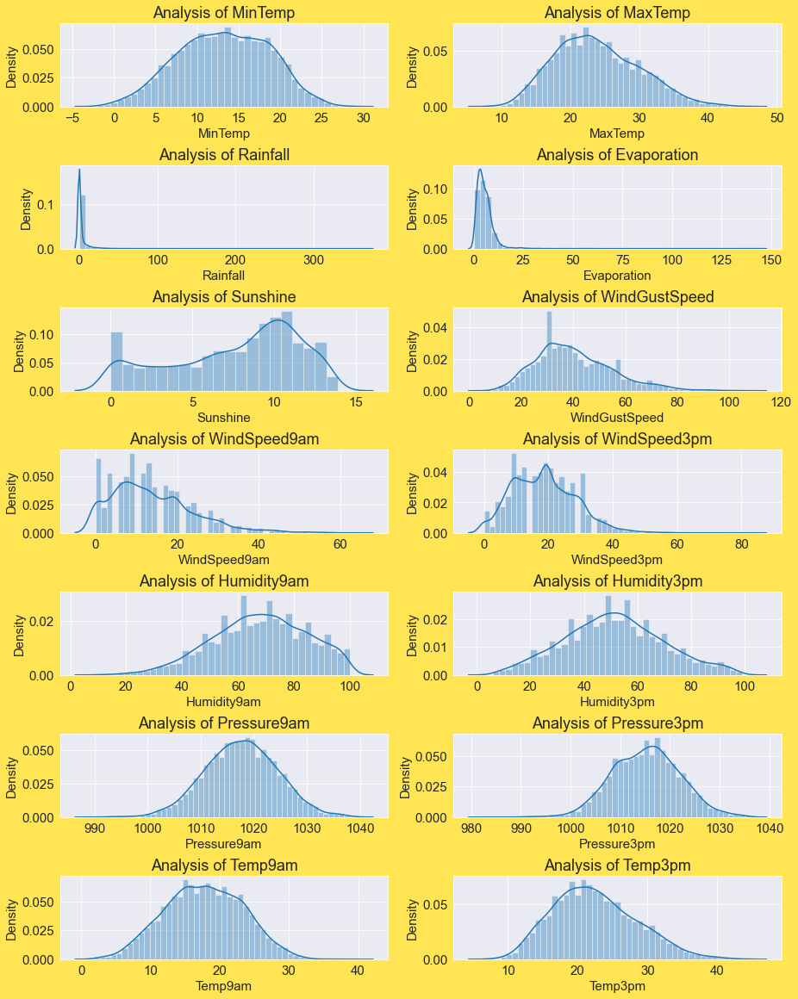

In [103]:
cont_cols_distribution(rain, continuous_features)

Observations:-
    
-> We can see most of the continuous columns are almost Normally distributed.

-> However there are few columns which are highly skewed Evaporation, Sunshine and WindSpeed.

-> We will not consider Rainfall here as it is our target variable

In [104]:
# seperating the columns which are having more than 25% missing values
# lets use randomsampling technique on these columns
random_sampling_cols = [col for col in rain.columns if (rain.isnull().sum()[col] > 2000)]

In [105]:
random_sampling_cols

['Evaporation', 'Sunshine', 'Cloud9am', 'Cloud3pm']

In [106]:
# Random Sampling for high number of missing values features-
# Random sampling will `randomly fill the null values of a column, from the non-null values
def randomsampleimputation(rain,columns):
    data = rain.copy()
    for column in columns:
        random_sample = data[column].dropna().sample(data[column].isnull().sum(),random_state=0)
        random_sample.index = data[data[column].isnull()].index
        data.loc[data[column].isnull(),column] = random_sample
    return data

In [107]:
rain = randomsampleimputation(rain,random_sampling_cols)

In [108]:
rain.head()

# We can see that the null values are filled with random values from the non-null values of those columns

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,3.0,13.8,W,44.0,W,WNW,20.0,24.0,71.0,22.0,1007.7,1007.1,8.0,8.0,16.9,21.8,No,No
1,2008-12-02,Albury,7.4,25.1,0.0,2.2,7.6,WNW,44.0,NNW,WSW,4.0,22.0,44.0,25.0,1010.6,1007.8,1.0,4.0,17.2,24.3,No,No
2,2008-12-03,Albury,12.9,25.7,0.0,4.6,7.7,WSW,46.0,W,WSW,19.0,26.0,38.0,30.0,1007.6,1008.7,2.0,2.0,21.0,23.2,No,No
3,2008-12-04,Albury,9.2,28.0,0.0,1.8,8.0,NE,24.0,SE,E,11.0,9.0,45.0,16.0,1017.6,1012.8,8.0,7.0,18.1,26.5,No,No
4,2008-12-05,Albury,17.5,32.3,1.0,3.8,11.9,W,41.0,ENE,NW,7.0,20.0,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No


In [109]:
# list of continuous columns with null values 
null_cont_cols  = [col for col in rain.columns if (rain.isnull().sum()[col] > 0) & (rain[col].dtypes != 'object')]

In [110]:
null_cont_cols

['MinTemp',
 'MaxTemp',
 'Rainfall',
 'WindGustSpeed',
 'WindSpeed9am',
 'WindSpeed3pm',
 'Humidity9am',
 'Humidity3pm',
 'Pressure9am',
 'Pressure3pm',
 'Temp9am',
 'Temp3pm']

In [111]:
# Checking the outliers in these columns
def cont_cols_outlier_check(rain,null_cont_cols):
    # creating a  copy of dataframe
    data = rain[null_cont_cols].copy()
    # subplots 
    fig, axes = plt.subplots(nrows=len(data.columns)//2, ncols=2,figsize=(15,20))
    fig.subplots_adjust(hspace=0.7)
    
    # our main distplot
    for ax, feature in zip(axes.flatten(), data.columns):
        sns.boxplot(data[feature],ax=ax)
        ax.set_title(f'Outliers in {feature}')
    plt.show()

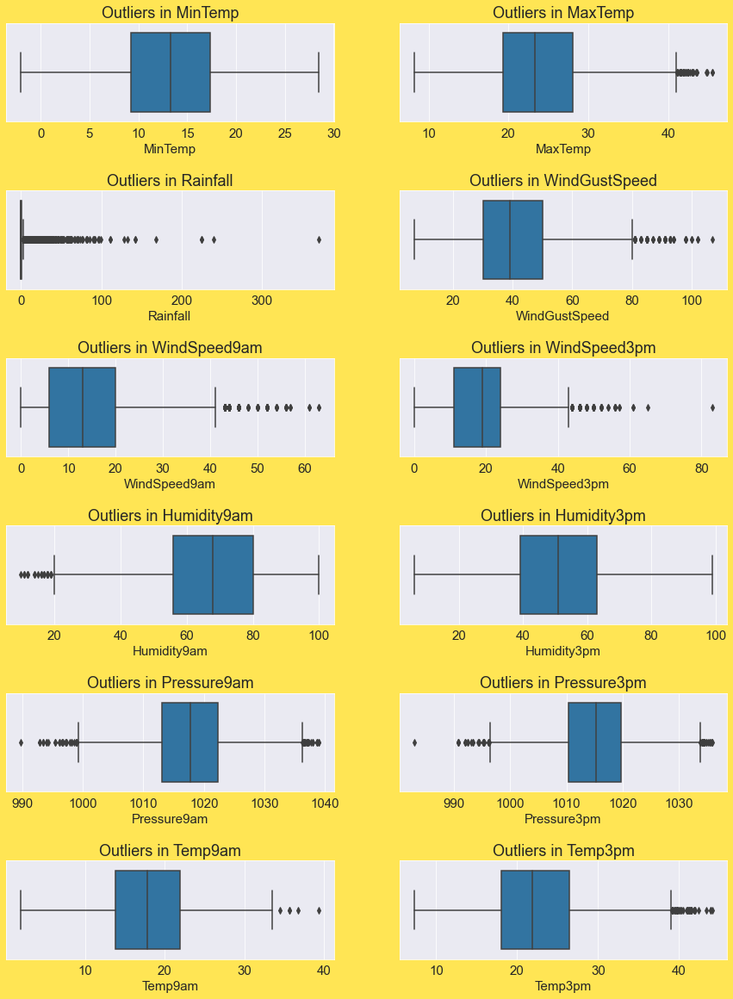

In [112]:
cont_cols_outlier_check(rain,null_cont_cols)

-> We can see there isn't many outliers in these columns, Although We have to exclude Rainfall


In [113]:
# Checking the null values of these columns once again
round(rain[null_cont_cols].isnull().sum()/8425*100,1)

# We can see the % null values are less in these columns 

# So we are going to replace them with their mean values

MinTemp           0.9
MaxTemp           0.7
Rainfall          2.8
WindGustSpeed    11.8
WindSpeed9am      0.9
WindSpeed3pm      1.3
Humidity9am       0.7
Humidity3pm       1.2
Pressure9am      15.5
Pressure3pm      15.6
Temp9am           0.7
Temp3pm           1.1
dtype: float64

In [114]:
# writing a function for mean imputation
def mean_imputation(rain,null_cont_cols):
    data = rain.copy()
    for col in null_cont_cols:
        data[col] = data[col].fillna(data[col].mean())
        
    return data

In [115]:
# running the function
rain = mean_imputation(rain,null_cont_cols)

In [116]:
# Now let's check the null values
rain.isnull().sum()

Date               0
Location           0
MinTemp            0
MaxTemp            0
Rainfall           0
Evaporation        0
Sunshine           0
WindGustDir      991
WindGustSpeed      0
WindDir9am       829
WindDir3pm       308
WindSpeed9am       0
WindSpeed3pm       0
Humidity9am        0
Humidity3pm        0
Pressure9am        0
Pressure3pm        0
Cloud9am           0
Cloud3pm           0
Temp9am            0
Temp3pm            0
RainToday        240
RainTomorrow     239
dtype: int64

In [117]:
# Now we have to impute the categorical columns
# lets check the missing value percentage in them
categorical_features

['Date',
 'Location',
 'WindGustDir',
 'WindDir9am',
 'WindDir3pm',
 'RainToday',
 'RainTomorrow']

In [118]:
# We are removing date and location as there aren't any null values 
categorical_features.remove('Date')
categorical_features.remove('Location')

In [119]:
categorical_features

['WindGustDir', 'WindDir9am', 'WindDir3pm', 'RainToday', 'RainTomorrow']

In [120]:
rain[categorical_features].isnull().sum()/8425*100

# We can see these null values % is adequate 
# We can fill them with most frequent value or mode

WindGustDir     11.762611
WindDir9am       9.839763
WindDir3pm       3.655786
RainToday        2.848665
RainTomorrow     2.836795
dtype: float64

In [121]:
# lets check the mode of these columns
for i in categorical_features:
    print('Mode of',i,'is ',rain[i].mode()[0])
    

Mode of WindGustDir is  N
Mode of WindDir9am is  N
Mode of WindDir3pm is  SE
Mode of RainToday is  No
Mode of RainTomorrow is  No


In [122]:
# imputing them with mode using Simple Imputer
# since our data is categorical and the null values are upto 5% we are going to fill the null values with mode of the columns
from sklearn.impute import SimpleImputer
si = SimpleImputer(missing_values = np.nan,strategy = 'most_frequent',verbose=0)

In [123]:
for i in categorical_features:
    # fitting the imputer
    si = si.fit(rain[[i]])
    # transforming the values to mode
    rain[[i]] = si.transform(rain[[i]]) 
    

In [124]:
# Now checking the Null values Again
rain.isnull().sum()

# We can see that the null values are removed

Date             0
Location         0
MinTemp          0
MaxTemp          0
Rainfall         0
Evaporation      0
Sunshine         0
WindGustDir      0
WindGustSpeed    0
WindDir9am       0
WindDir3pm       0
WindSpeed9am     0
WindSpeed3pm     0
Humidity9am      0
Humidity3pm      0
Pressure9am      0
Pressure3pm      0
Cloud9am         0
Cloud3pm         0
Temp9am          0
Temp3pm          0
RainToday        0
RainTomorrow     0
dtype: int64

In [125]:
# checking duplicates rows
duplicates =   rain[rain.duplicated()]
duplicates.shape

(701, 23)

In [126]:
# shape before dropping
rain.shape

(8425, 23)

In [127]:
# Dropping them beacuse it doesn't add any value to our models
rain.drop_duplicates(inplace=True)

In [128]:
# shape after
rain.shape

# We just lost 701 rows

(7724, 23)

## Univariate Analysis

In [129]:
# we are removing date because there are many unique values in it
cat_cols = rain.dtypes[rain.dtypes == 'object'].index.tolist()
cat_cols.remove('Date')

['Albury' 'CoffsHarbour' 'Newcastle' 'Penrith' 'Williamtown' 'Wollongong'
 'Melbourne' 'Brisbane' 'Adelaide' 'PerthAirport' 'Darwin' 'Uluru']


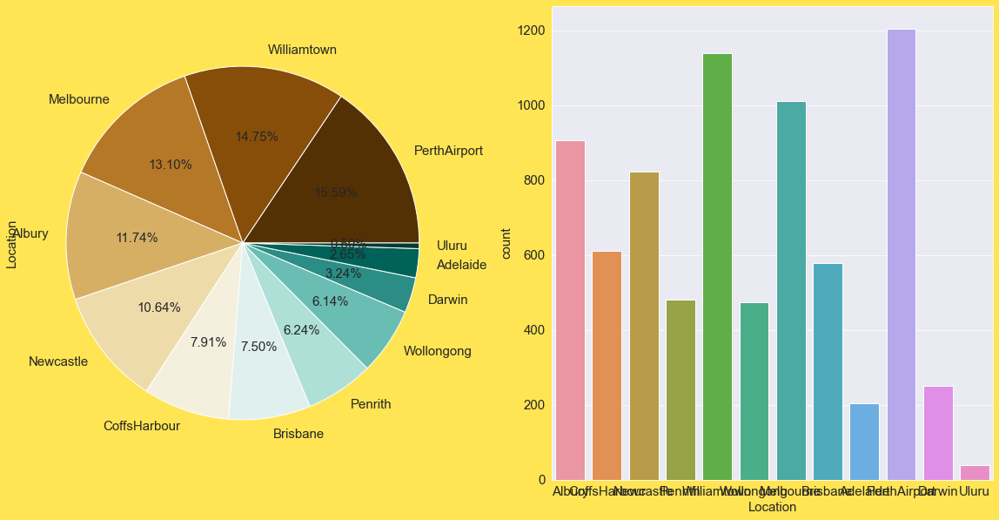

['W' 'WNW' 'WSW' 'NE' 'NNW' 'N' 'NNE' 'SW' 'ENE' 'SSE' 'S' 'NW' 'SE' 'ESE'
 'E' 'SSW']


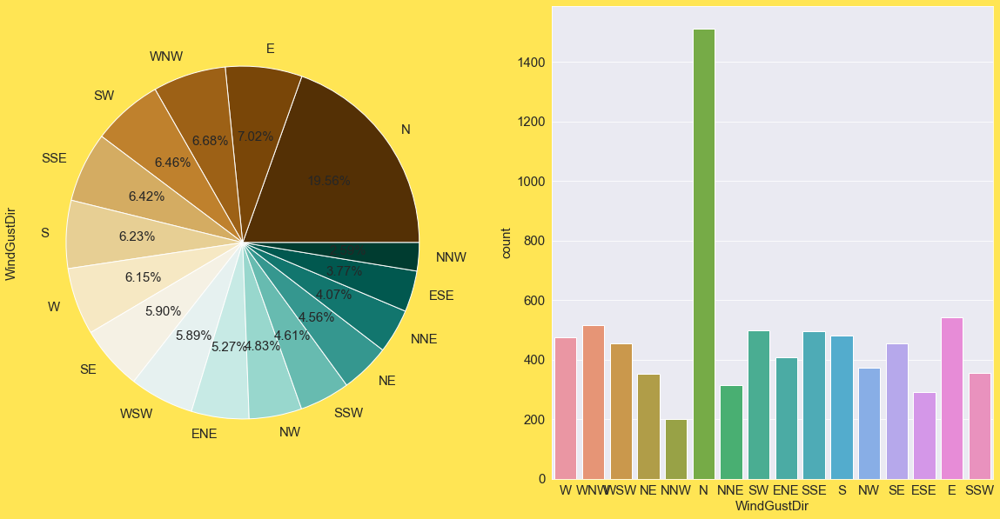

['W' 'NNW' 'SE' 'ENE' 'SW' 'SSE' 'S' 'NE' 'N' 'SSW' 'WSW' 'ESE' 'E' 'NW'
 'WNW' 'NNE']


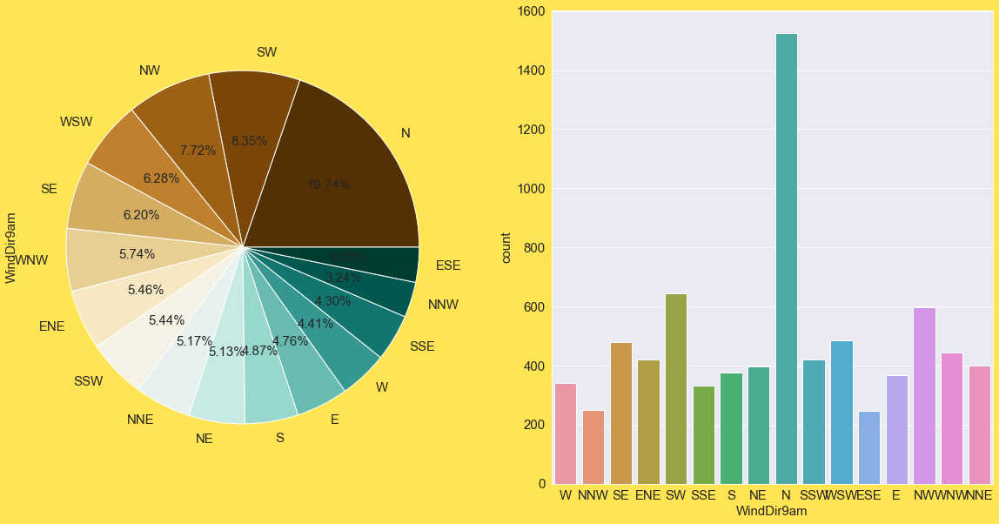

['WNW' 'WSW' 'E' 'NW' 'W' 'SSE' 'ESE' 'ENE' 'NNW' 'SSW' 'SW' 'SE' 'N' 'S'
 'NNE' 'NE']


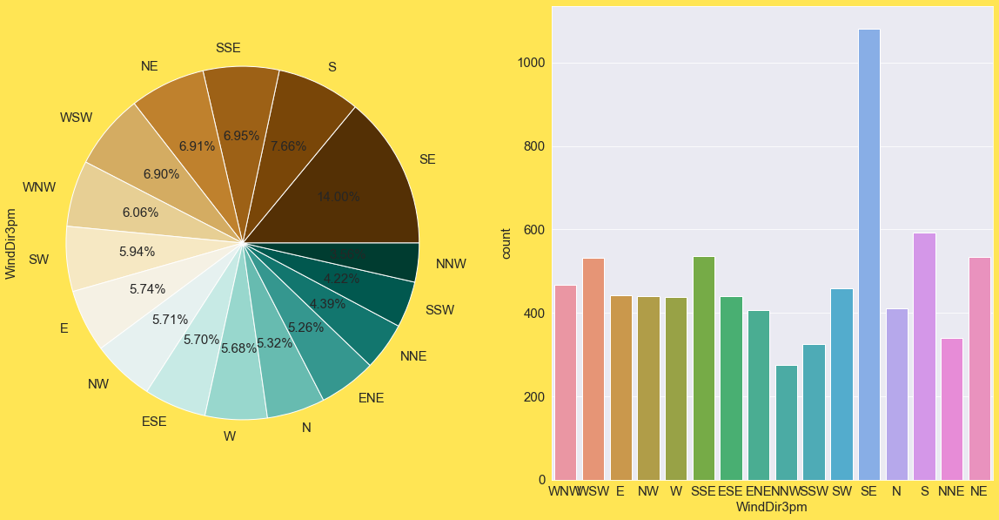

['No' 'Yes']


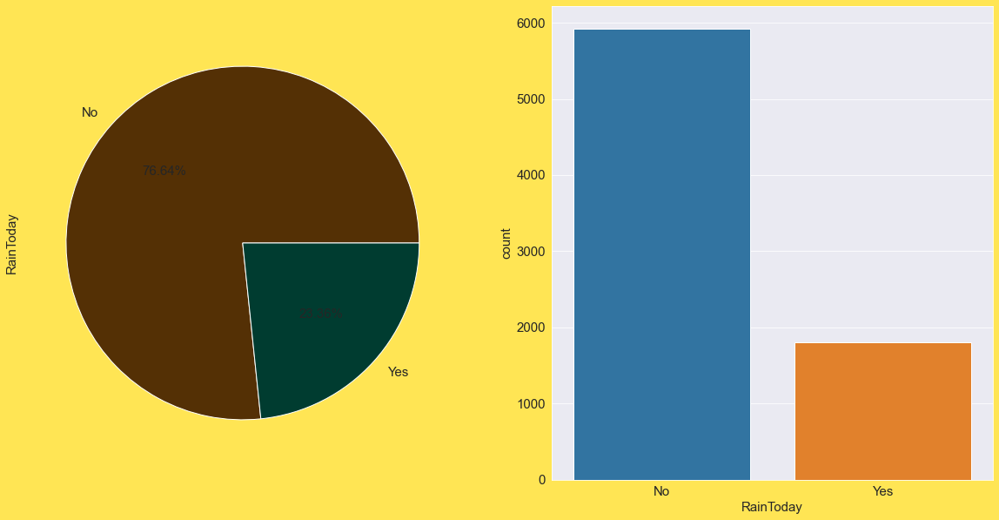

['No' 'Yes']


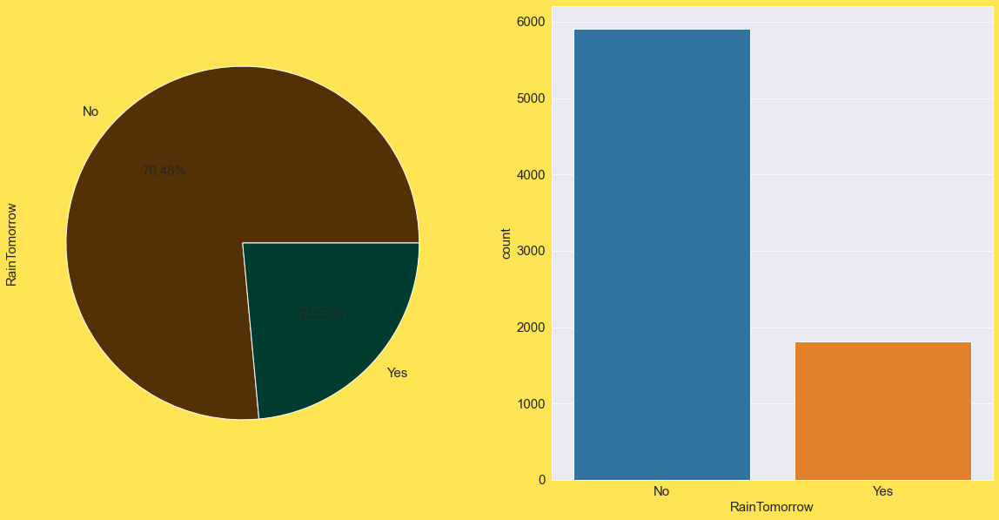

In [130]:
# plotting a bar plot and countplot to look at the catgeories
for i in cat_cols:
    
    plt.figure(figsize=(20,10))
    plt.subplot(1,2,2)
    sns.countplot(i,data=rain)
    plt.subplot(1,2,1)
    rain[i].value_counts().plot.pie(autopct='%1.2f%%',cmap = 'BrBG')
    print(rain[i].unique())
    plt.show()


Observations:-
    
-> Data Related to PerthAirport is more in number followed by Williamtown,Melbourne and Albury.

-> Most of the time WindGusDirection was in North N side.

-> Same case with the wind direction at 9AM

-> Interestingly At 3pm most of the time wind direction is on SE south east side.

-> Rain Chances were significantly low on the respective dates according to the data.

-> As we have discussed there are more No values which means there is likely for rainfall in our target Rain tomorrowcolumn

-> We have to balance that data as we move forward.

In [131]:
# We have some columns which are discrete, means they are like interge encoded and have fewer unique values
discrete_features

['Cloud9am', 'Cloud3pm']

[8. 1. 2. 7. 0. 6. 5. 4. 3.]


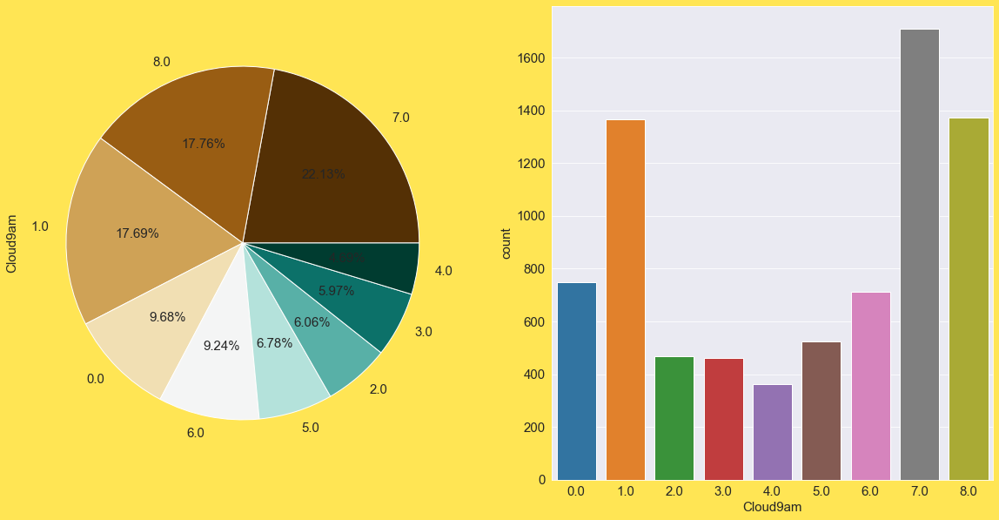

[8. 4. 2. 7. 1. 6. 5. 0. 3.]


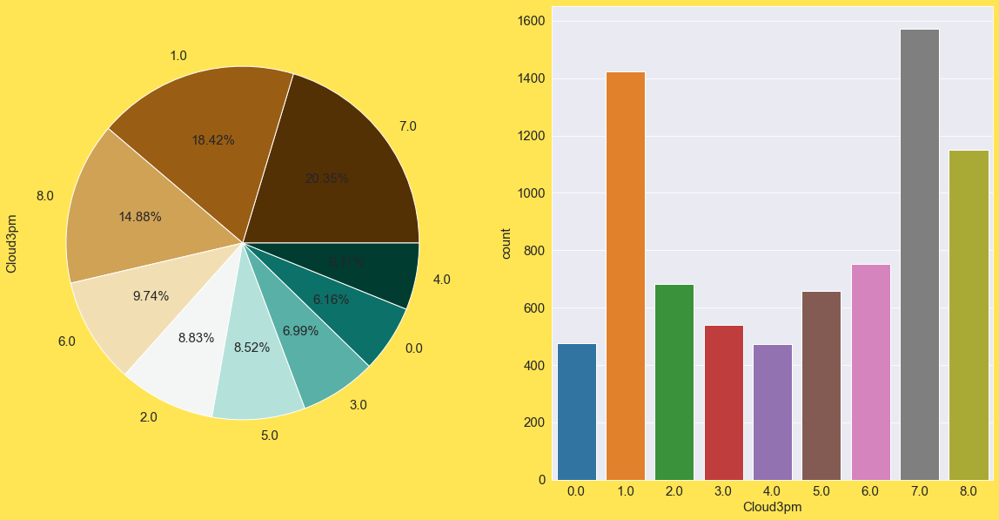

In [132]:
# let's plot for them as well
for i in discrete_features:
    
    plt.figure(figsize=(20,10))
    plt.subplot(1,2,2)
    sns.countplot(i,data=rain)
    plt.subplot(1,2,1)
    rain[i].value_counts().plot.pie(autopct='%1.2f%%',cmap = 'BrBG')
    print(rain[i].unique())
    plt.show()
    

-> 22% of the time the fraction of sky obscurred by cloud is upto 7.0 and 8.0 respectively at 9AM

-> Same with the clouds at 3pm

In [133]:
# sperating continuous columns
cont_cols = rain.dtypes[rain.dtypes != 'object'].index.tolist()
cont_cols

['MinTemp',
 'MaxTemp',
 'Rainfall',
 'Evaporation',
 'Sunshine',
 'WindGustSpeed',
 'WindSpeed9am',
 'WindSpeed3pm',
 'Humidity9am',
 'Humidity3pm',
 'Pressure9am',
 'Pressure3pm',
 'Cloud9am',
 'Cloud3pm',
 'Temp9am',
 'Temp3pm']

In [134]:
# plotting a histogram to check the values and distribution of cont_cols
def histplots(rain,cont_cols):
    # creating a  copy of dataframe
    data = rain[null_cont_cols].copy()
    # subplots 
    fig, axes = plt.subplots(nrows=len(data.columns)//2, ncols=2,figsize=(15,20))
    fig.subplots_adjust(hspace=0.7)
    
    # our main distplot
    for ax, feature in zip(axes.flatten(), data.columns):
        sns.histplot(data[feature],ax=ax)
        ax.set_title(f'Histogram of {feature}')
    plt.show()

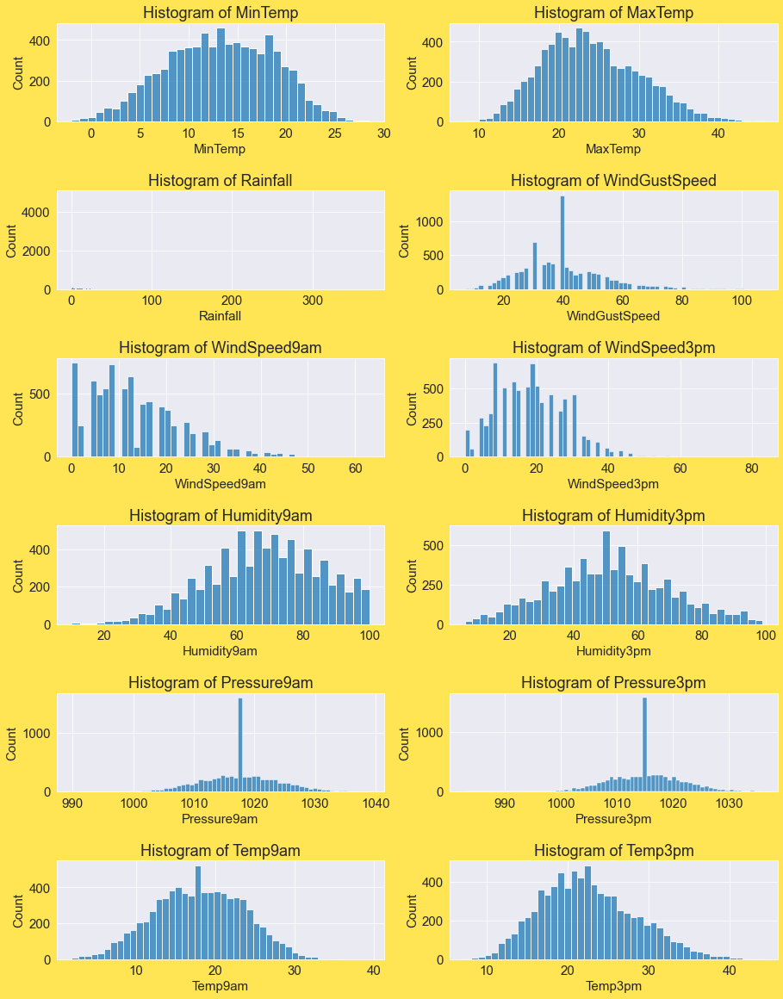

In [135]:
histplots(rain,cont_cols)

Observations:-
    
-> Most of the time Min and Max temperature was between 10-20 degrees Celsius and 20-30 degrees Celsius respectively.

-> Highest recorded rainfall is in the range between 0-20

-> WindgustSpeed was highest with up to 40

-> Windspeed highest range was 0-20km/hr at 9am and 10-30km/hr at 3pm respectively.

-> Mostly humidity was in the range 60-80% at 9am and 40-60% after 3pm.

-> Pressure was similarly fluctuated in the range 1010-1020 hpa at both 9am and 3pm.

-> Temperatire was also uniquely similar in both 9am and 3pm in the range between 5-25 degrees celsius

## Bivariate Analysis

In [136]:
# taking out RainTomorrow from the cat_cols as it is a target
cat_cols.remove('RainTomorrow')
cat_cols

['Location', 'WindGustDir', 'WindDir9am', 'WindDir3pm', 'RainToday']

In [137]:
# Similarly removing Rainfall as well as it is also one of the target
cont_cols.remove('Rainfall')
cont_cols

['MinTemp',
 'MaxTemp',
 'Evaporation',
 'Sunshine',
 'WindGustSpeed',
 'WindSpeed9am',
 'WindSpeed3pm',
 'Humidity9am',
 'Humidity3pm',
 'Pressure9am',
 'Pressure3pm',
 'Cloud9am',
 'Cloud3pm',
 'Temp9am',
 'Temp3pm']

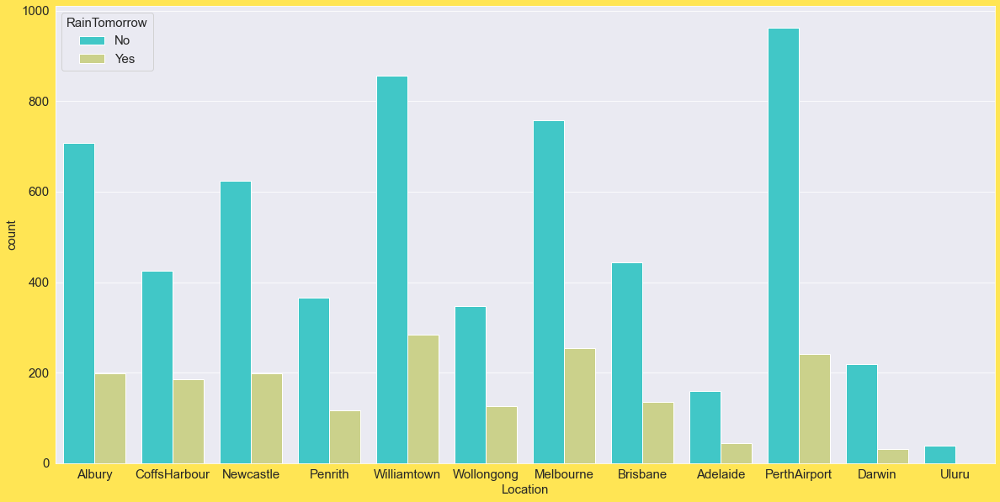

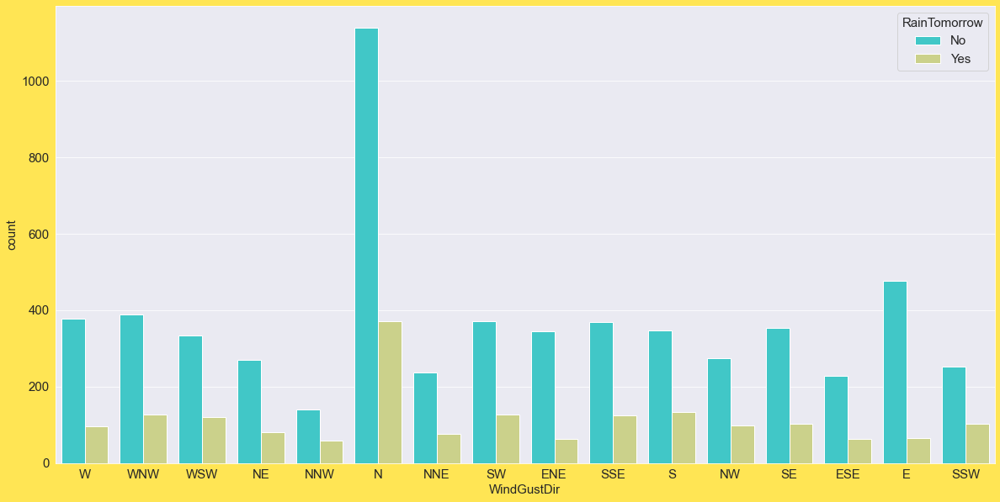

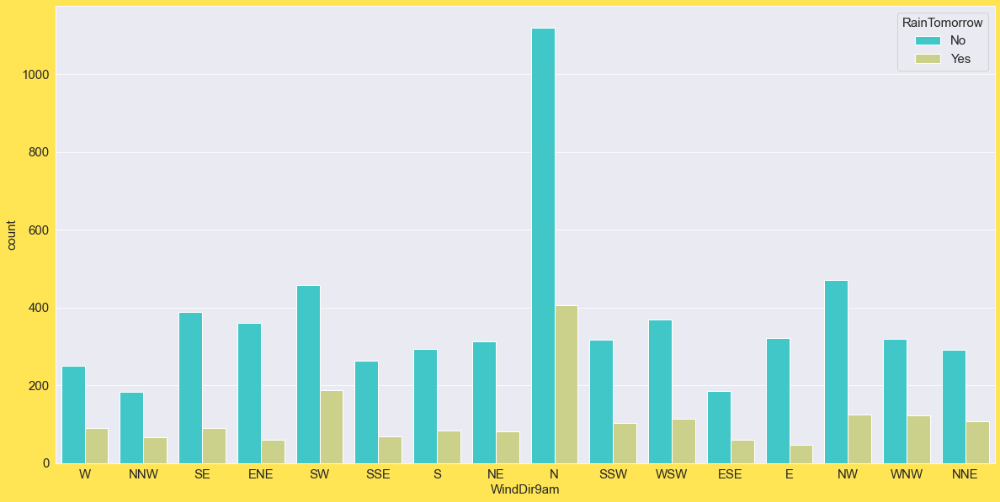

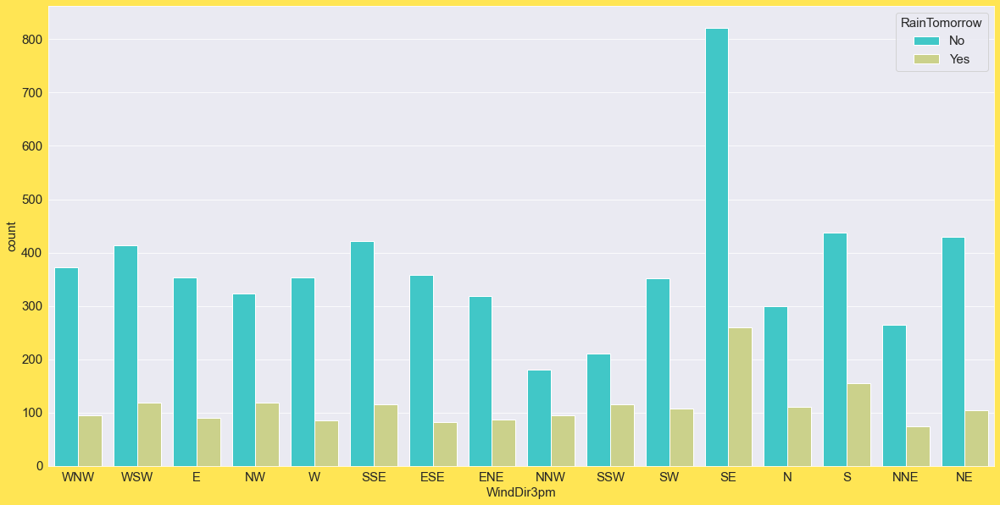

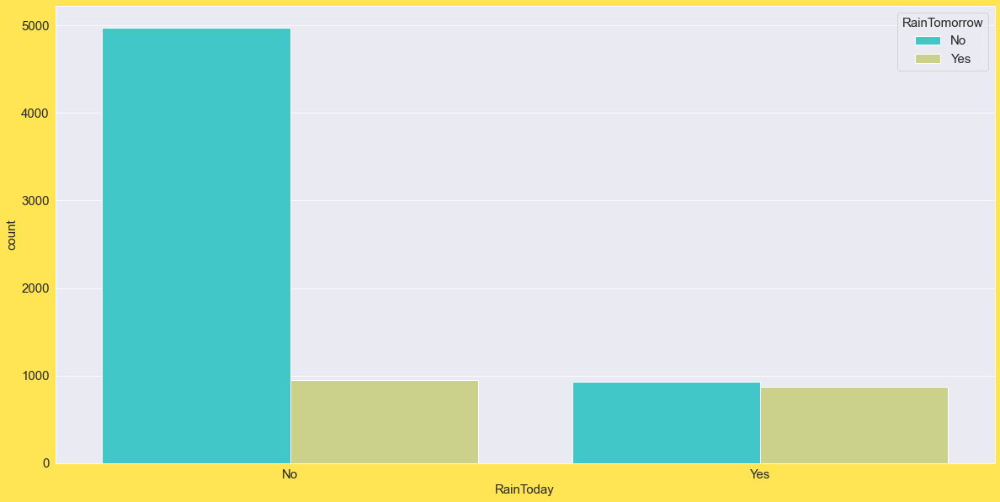

In [138]:
# plotting cat plot to know the relationship of the cat features with its target RainTomorrow
for i in cat_cols:
    plt.figure(figsize=(20,10))
    sns.countplot(rain[i],hue='RainTomorrow',data=rain,palette='rainbow')
    plt.show()

Observations:-
    
-> We can see that Uluru location didn't have record of any rainfall and Williamtown is having more rainfall tomorrow.

-> Most of the times rainfall tomorrow was due to N WindGustDir

-> Same with the Wind direction at 9am as well, however at 3pm SE direction is imapcting more on rainfall tomorrow.

-> There is more chance of NO rainfall tomorrow if it hadn't rained today and there are 50-50 % chances of Rain tomorrow, if it rained today.

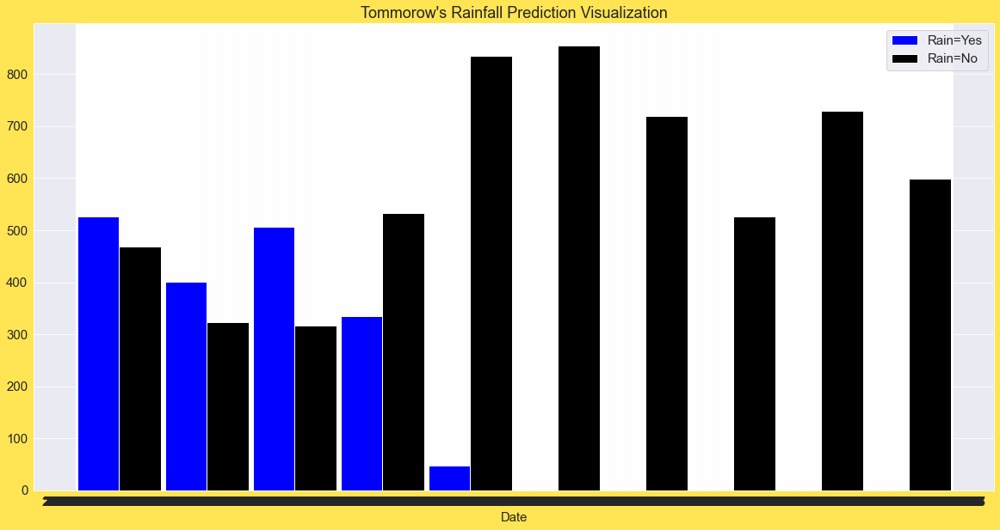

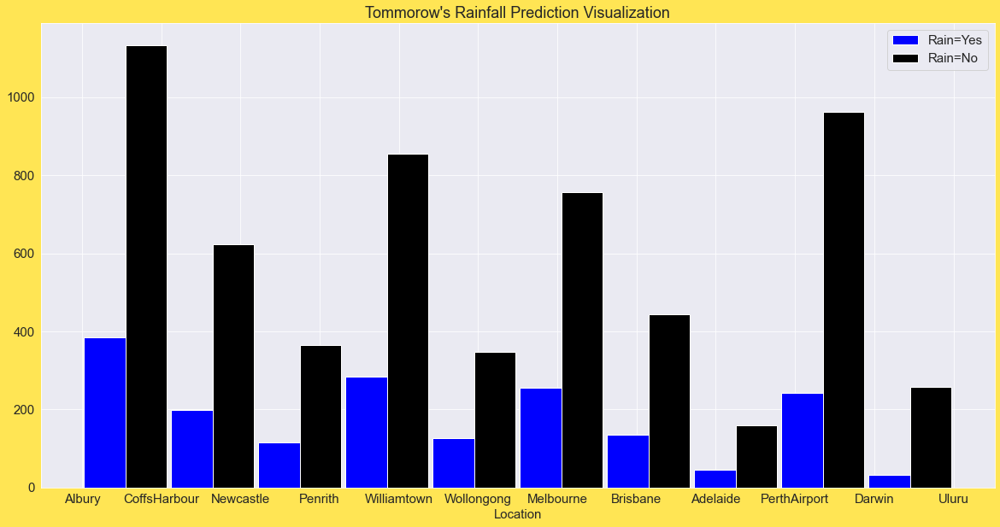

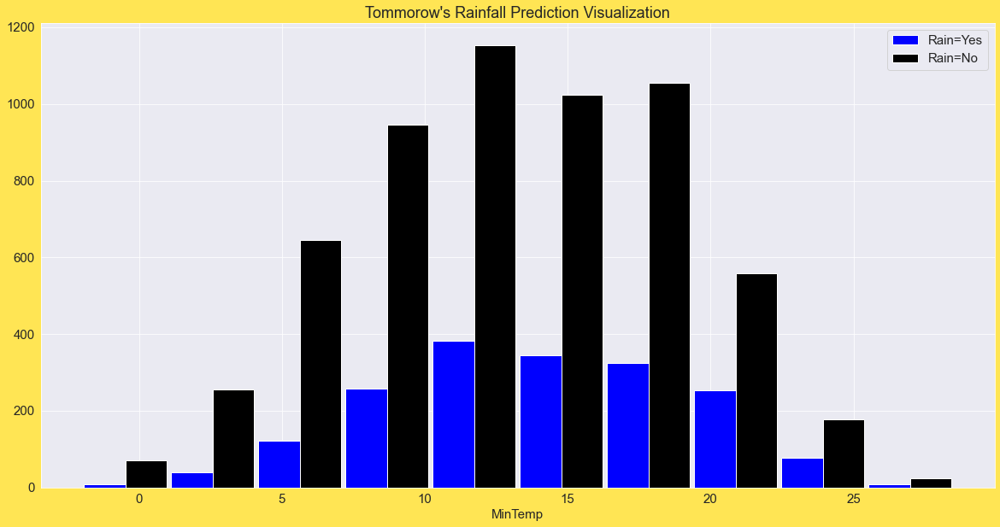

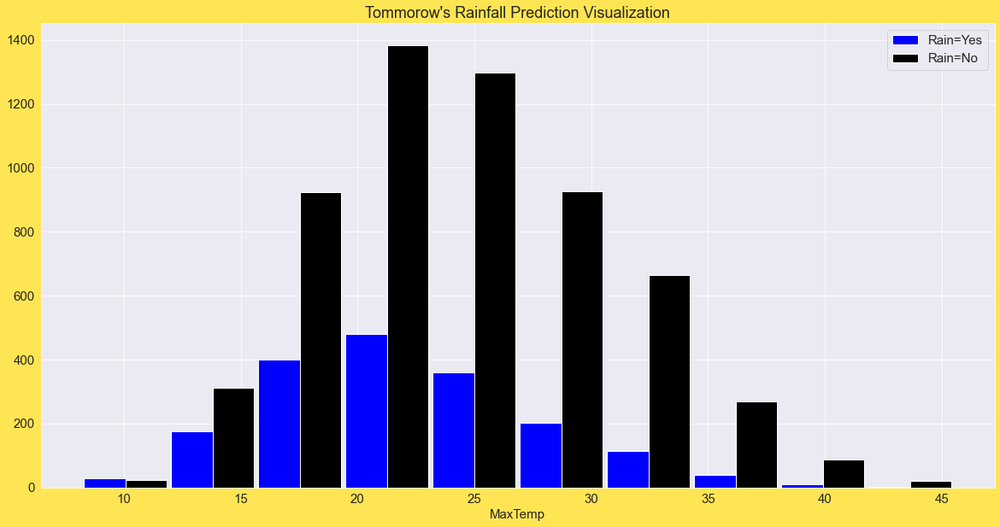

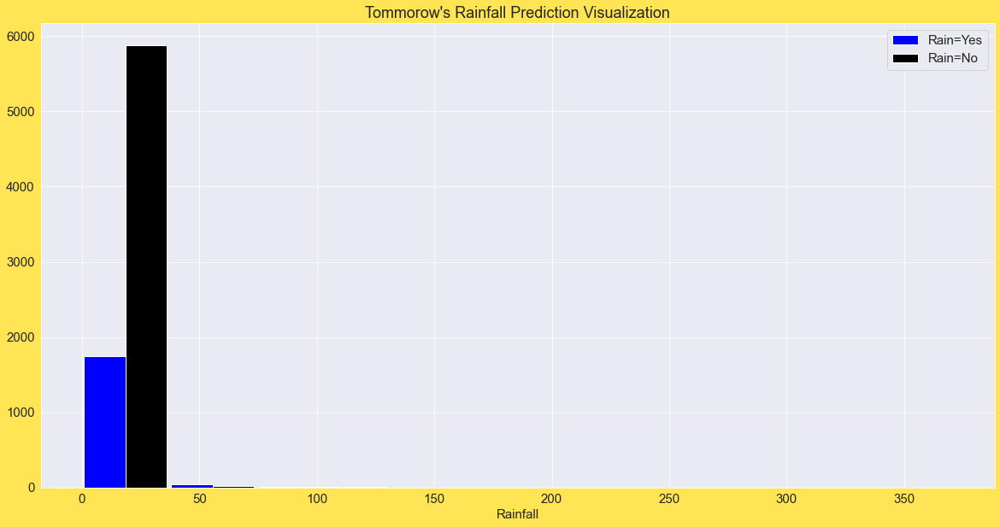

...

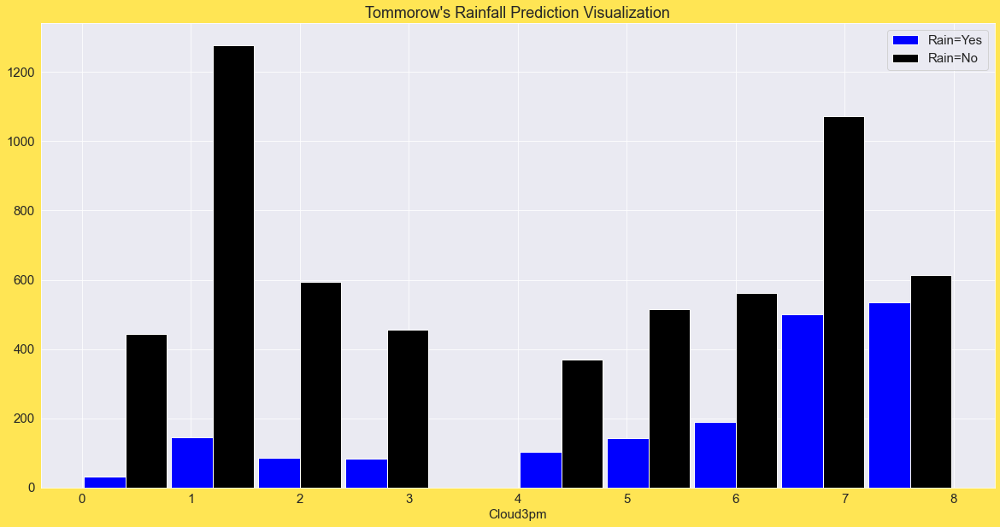

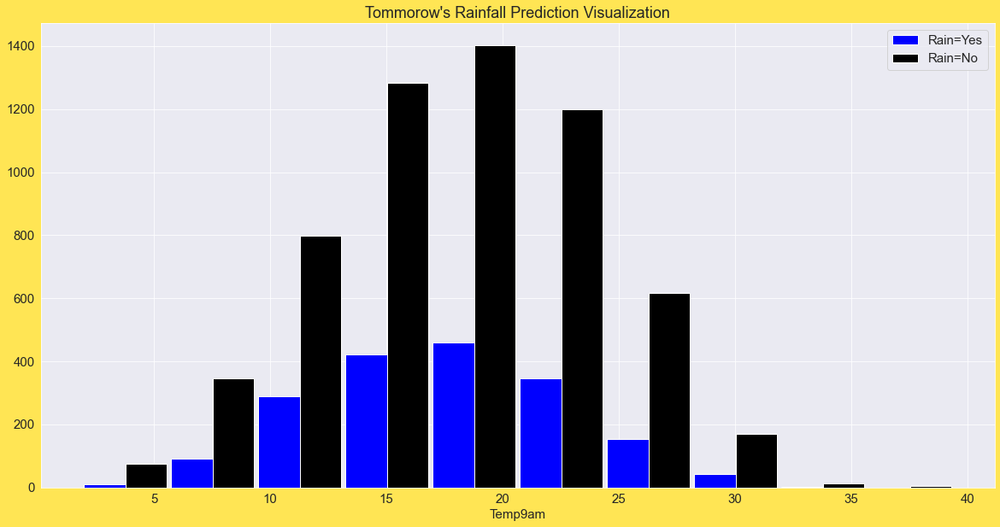

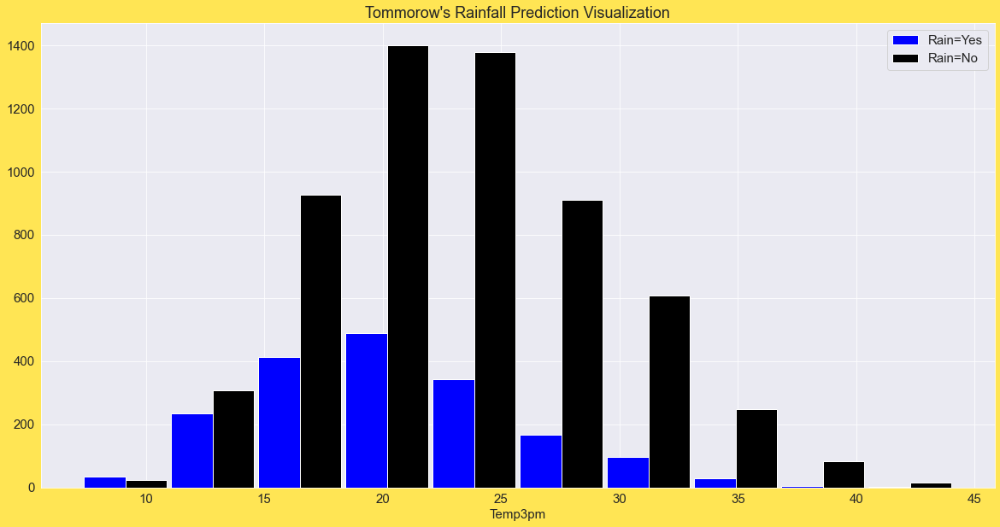

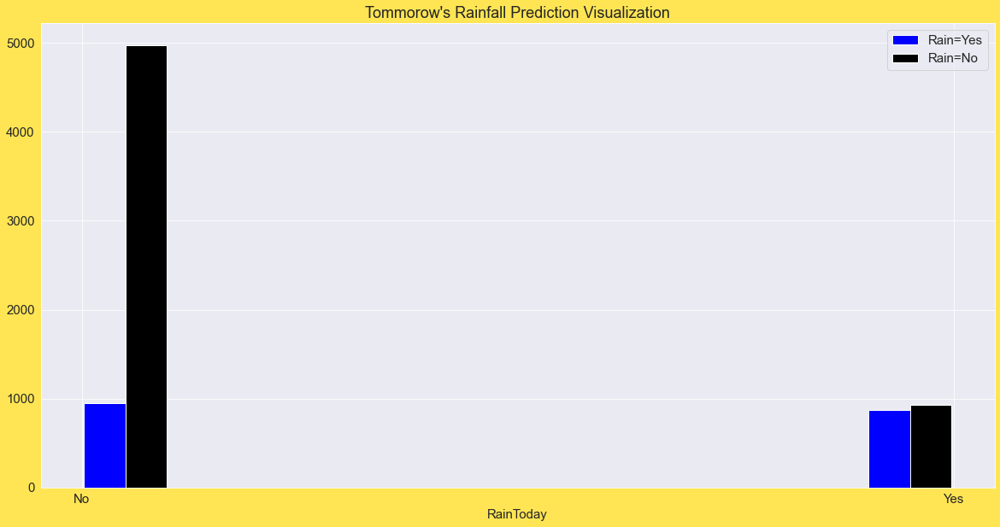

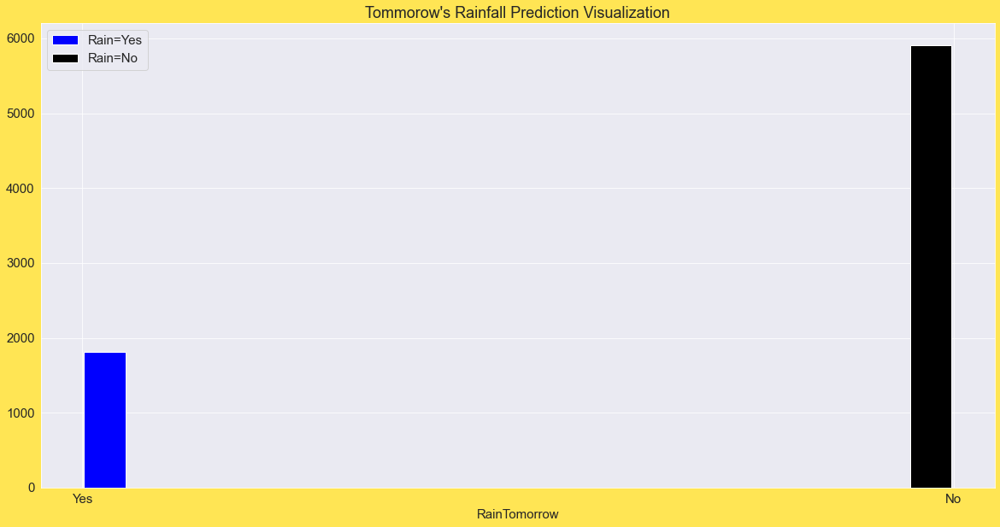

In [139]:
# plotting a histogram to check if it rains tomorrow churn with respect 
for i in rain.columns:
    
    rain_no = rain[rain.RainTomorrow =='No'][i]
    rain_yes = rain[rain.RainTomorrow =='Yes'][i]
    
    plt.figure(figsize=(20,10))
    plt.xlabel(i)
    # plt.ylabel("Number Of Customers")
    plt.title("Tommorow's Rainfall Prediction Visualization")

    plt.hist([rain_yes,rain_no], rwidth=0.95, color=['blue','black'],label=['Rain=Yes','Rain=No'])
    # indicating colour blue if it rains, black if it isn't
    
    plt.legend()
    plt.show()

Observations:-
    
-> The chances of rainfall are significantly low in all the years. However after the year 2014 the chances of rainfall have been risen up.

-> Albury has the highest chance of a rainfall, followed by Williamtown and Melbourne.

-> The chance of rainfall is high if the min temperature is in the rnge 10-15 degrees celsius.

-> Similarly between 15-25 degrees celsius there is more chance of rainfall.

-> Only 0-10 % of the evaporation in the atmosphere accounts for rainfall.

-> There is an extremely higher chance of no rainfall if the sunshine % exceeds 10%

-> NNW wind direction accounts for more rainfall comparitively with the other directions

-> Windspeed in the range 25-50 has major chance of rainfall.

-> There is more chance of rainfall if the direction of wind at 9am is in N direction and at 3pm in SSW direction.

-> The chance of rainfall is decreasing as there is an increase in the windspeed at 9am. And at 3pm if the speed exceeds 20, it results in decrease in chance of rainfall.

-> As the humidity level increases, the chance of rainfall is also increases at both 9am and 3pm. However, at 3pm if the humidity exceeds 65, the chances of rainfall will fall.
 
-> The chances of rainfall is more only if the pressure at 9am or at 3pm is in the range 1010 to 1020.

-> The chances rainfall increases only after the clouds at 9am and 3pm exceeds 4.

-> The probability of rainfall is in the range of temperature between 15-25 degrees celsius at 9am and 3pm respectively.

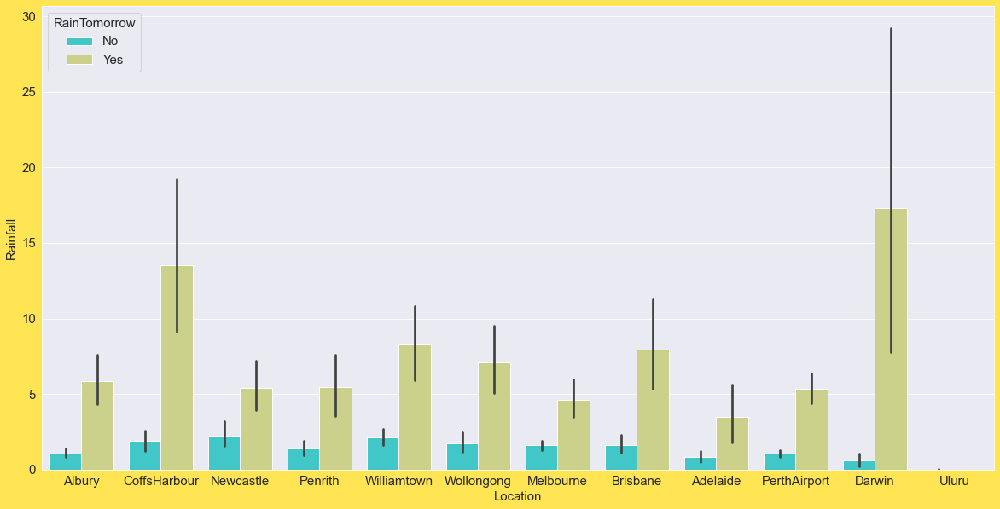

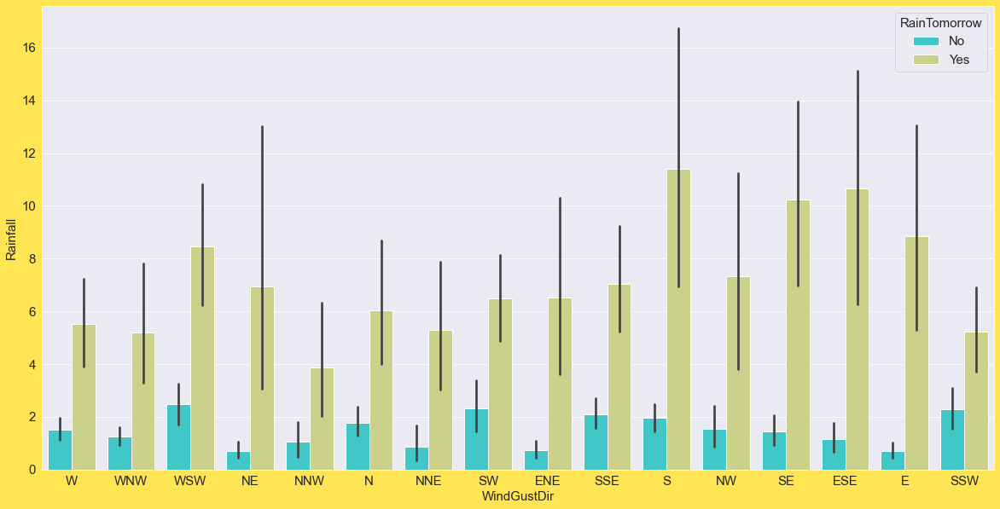

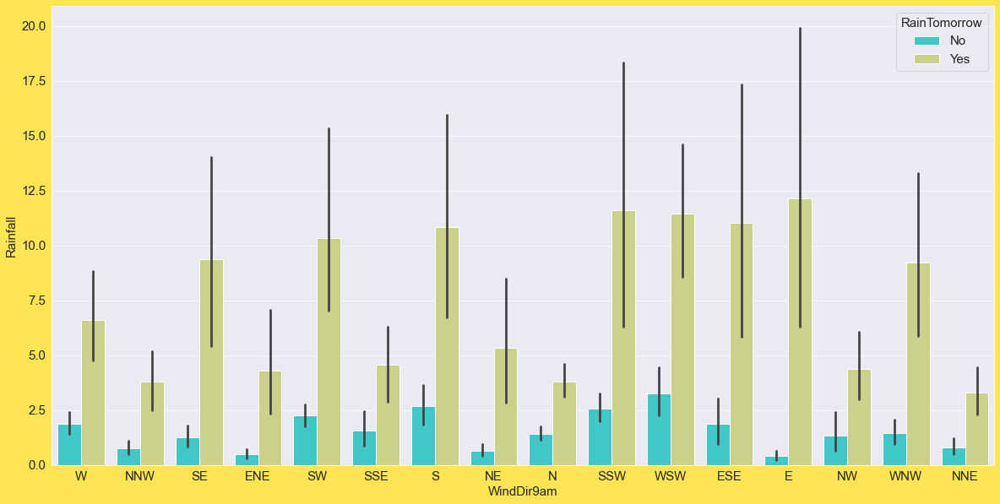

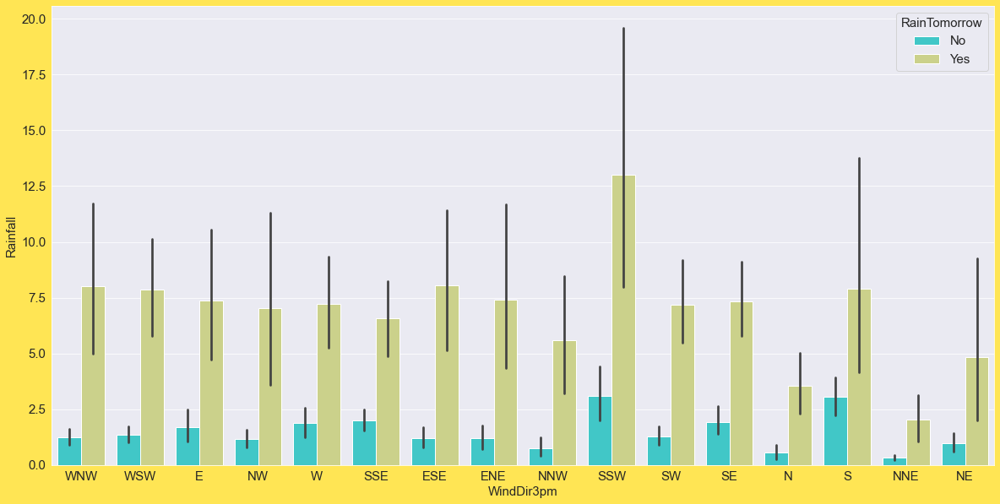

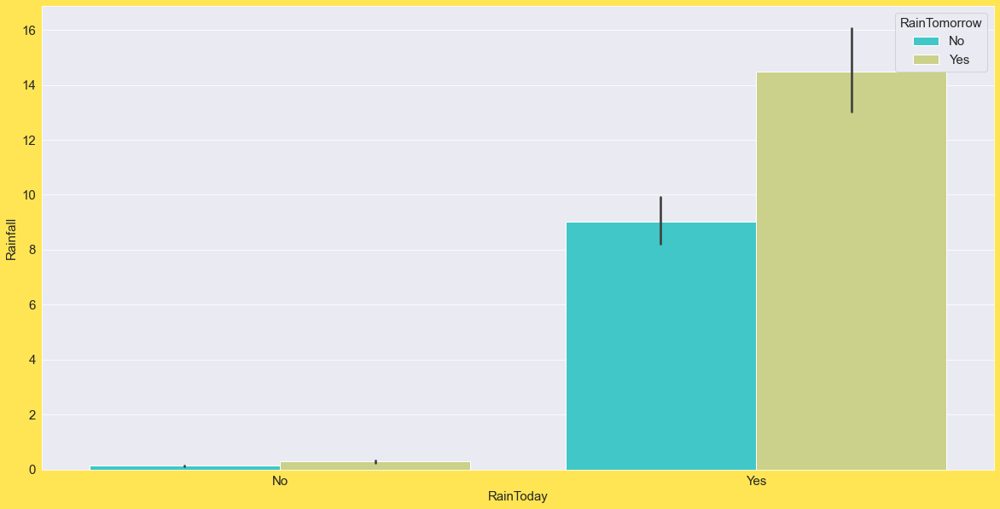

In [140]:
# plotting barplots to see the patterns with both the target columns
for i in cat_cols:
    plt.figure(figsize=(20,10))
    sns.barplot(x=rain[i],y=rain['Rainfall'],hue='RainTomorrow',data=rain,palette='rainbow')
    plt.show()



Observations:-
    
-> The highest ever recorded rainfall in a day was in the Darwin City with more than 17mm followed by CoffsHarbour with 14mm.

-> S direction of wind is having more rainfall with 11mm followed by SSW and WSW with 11mm both.

-> Similarly, rainfall is more with 11.8mm when the wind direction is in E direct and rainfall is siginificantly if the direction of wind is in SSW at 3pm.


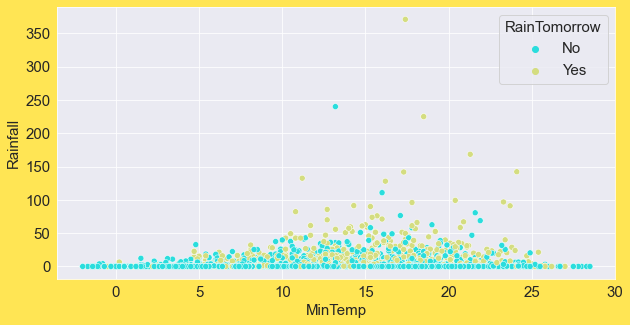

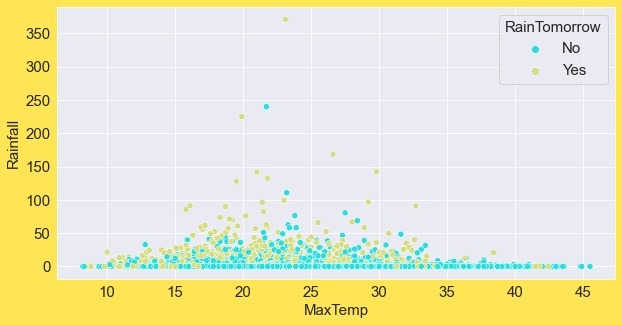

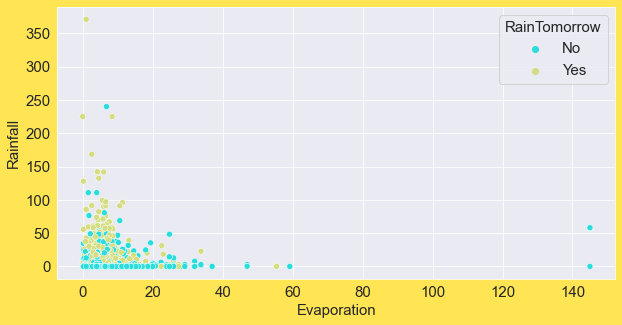

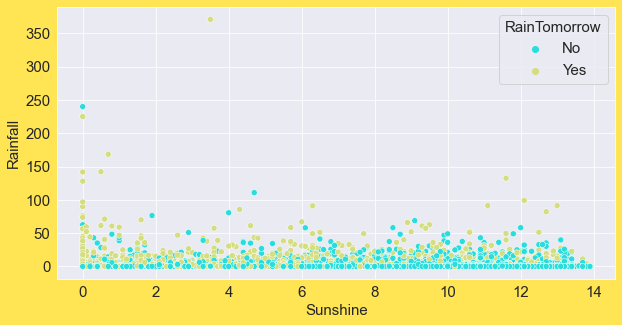

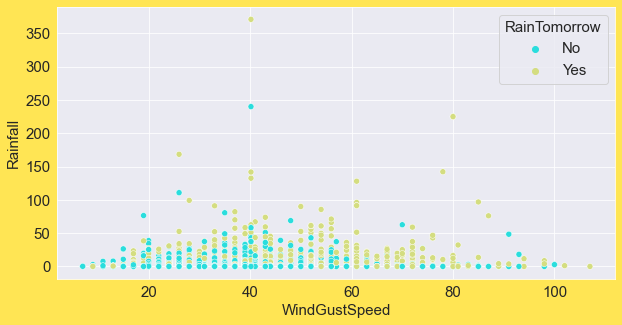

...

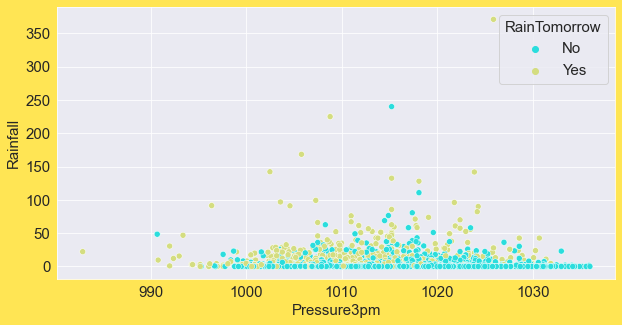

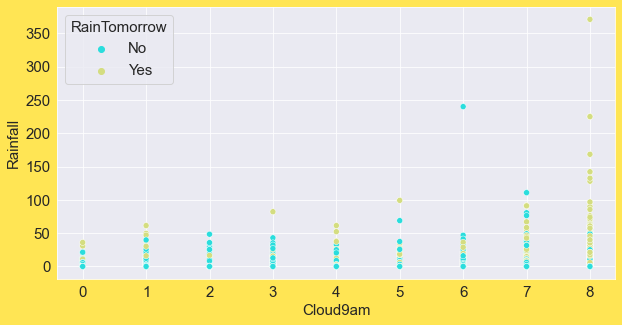

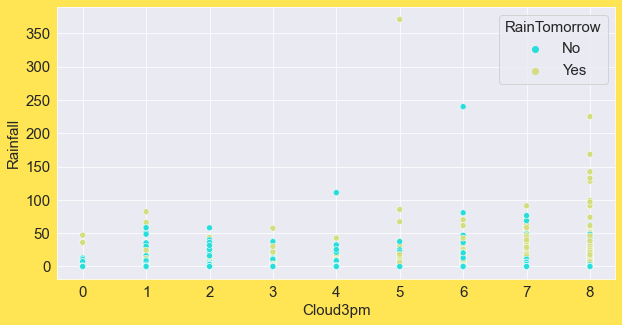

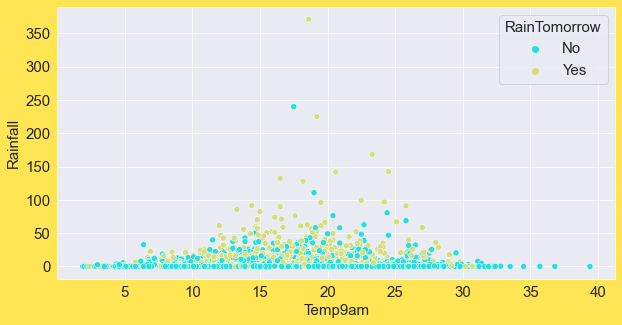

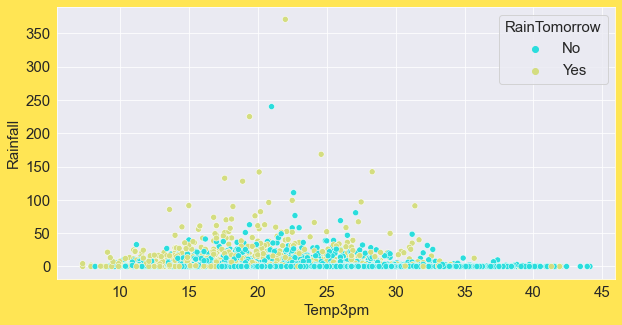

In [141]:
# plotting scatter plots to look at the pattern with respect to both the targets
# plotting barplots to see the patterns with both the target columns
for i in cont_cols:
    plt.figure(figsize=(10,5))
    sns.scatterplot(x=rain[i],y=rain['Rainfall'],hue='RainTomorrow',data=rain,palette='rainbow')
    plt.show()


Observations:-
    
-> We can observe that only if the min temperture in higher than 15 degrees celsius there is a higher chance of rainfall.

-> There is higher rainfall when the Maxtemp is above 20 degrees celsius.

-> Rainfall is high whe the evaporation is in the range between 0-20.

-> The highest rainfall in a day was when the sunshine is inthe range 2-4.

-> Chance of rainfall increases with the windspeed.


In [142]:
# We have observed that the timeline or the date of the data is not on an order
# for the effective visualization purpose we have ordered them ascending order
# which means the date will follow an order now
rain_chronoloical = rain.sort_values(by ='Date',ascending=True)

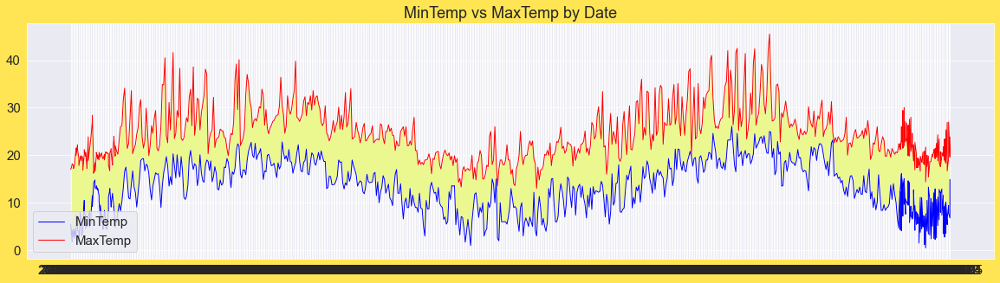

In [143]:
# Checking the Max and Min temperature trend from the last three years
# Changing the datatype of the Date to datetime
rain["Date"] = pd.to_datetime(rain["Date"])
# using data from last 3 years.
Minmaxtemp_years = rain_chronoloical.iloc[-1250:,:]
plt.figure(figsize=[20,5])
plt.plot(Minmaxtemp_years['Date'],Minmaxtemp_years['MinTemp'],color='blue',linewidth=1, label= 'MinTemp')
plt.plot(Minmaxtemp_years['Date'],Minmaxtemp_years['MaxTemp'],color='red',linewidth=1, label= 'MaxTemp')
plt.fill_between(Minmaxtemp_years['Date'],Minmaxtemp_years['MinTemp'],Minmaxtemp_years['MaxTemp'], facecolor = '#EBF78F')
plt.title('MinTemp vs MaxTemp by Date')
plt.legend(loc='lower left')
plt.show()

-> We can observe that that the MinTemp and MaxTemp relatively increases and decreases every year. As you can see that, December to February is summer; March to May is autumn; June to August is winter; and September to November is spring.

-> The weather conditions are always opposite in the two hemispheres. As, the Australia is situated in the southern hemisphere. The seasons are bit different.

-> There was a steady rise in both Max and Min temperatures in the last quarter of the year 2015.

In [144]:
# checking the df 
rain.head()

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,3.0,13.8,W,44.0,W,WNW,20.0,24.0,71.0,22.0,1007.7,1007.1,8.0,8.0,16.9,21.8,No,No
1,2008-12-02,Albury,7.4,25.1,0.0,2.2,7.6,WNW,44.0,NNW,WSW,4.0,22.0,44.0,25.0,1010.6,1007.8,1.0,4.0,17.2,24.3,No,No
2,2008-12-03,Albury,12.9,25.7,0.0,4.6,7.7,WSW,46.0,W,WSW,19.0,26.0,38.0,30.0,1007.6,1008.7,2.0,2.0,21.0,23.2,No,No
3,2008-12-04,Albury,9.2,28.0,0.0,1.8,8.0,NE,24.0,SE,E,11.0,9.0,45.0,16.0,1017.6,1012.8,8.0,7.0,18.1,26.5,No,No
4,2008-12-05,Albury,17.5,32.3,1.0,3.8,11.9,W,41.0,ENE,NW,7.0,20.0,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No


In [145]:
# Seperating the year month and day features from the Date
rain["year"] = rain["Date"].dt.year
rain["month"] = rain["Date"].dt.month
rain["day"] = rain["Date"].dt.day

In [146]:
# We will drop the original date columns as it is not needed for the model building
rain.drop(['Date'],axis=1,inplace=True)

In [147]:
rain.sample(4)

# We can see date column is removed and year day and month columns have been added

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,year,month,day
859,Albury,3.8,16.1,0.0,1.0,10.0,SSE,44.000000,ESE,SSE,7.0,24.000000,60.0,43.00000,1017.900000,1016.800000,5.0,1.0,11.4,15.600000,No,No,2011,5,9
4335,Wollongong,15.8,24.3,0.0,7.6,9.8,SE,52.000000,SE,ENE,13.0,13.000000,65.0,62.00000,1012.800000,1010.100000,1.0,7.0,20.4,24.200000,No,Yes,2009,1,16
1650,Newcastle,8.0,23.3,0.0,3.8,7.9,N,40.174469,N,SE,0.0,18.533662,62.0,51.24979,1017.640233,1015.236075,1.0,0.0,17.4,22.442934,No,No,2013,10,19
1430,CoffsHarbour,8.5,23.8,0.0,2.8,10.5,WNW,52.000000,N,WNW,22.0,22.000000,46.0,23.00000,1010.500000,1007.500000,1.0,3.0,17.6,22.100000,No,No,2010,8,15


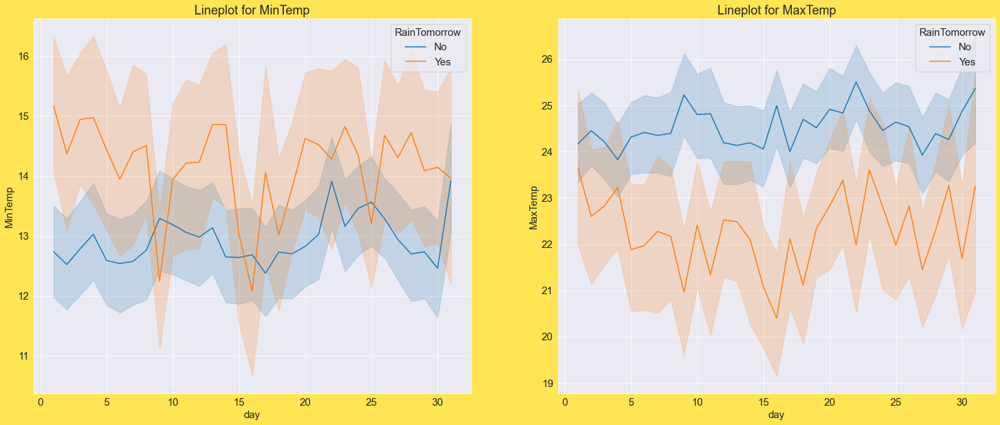

In [148]:
# plotting the lineplots
fig, axes = plt.subplots(1, 2, figsize=(25, 10))

# Mintemp
sns.lineplot(ax=axes[0],x="day",y="MinTemp",hue="RainTomorrow",data=rain)
axes[0].set_title('Lineplot for MinTemp')
# Maxtemp
sns.lineplot(ax=axes[1],x="day",y="MaxTemp",hue="RainTomorrow",data=rain)
axes[1].set_title('Lineplot for MaxTemp')
plt.show()

By the above plot we can say that if difference between min and max temperature is low then probability of rain occuring tomorrow is high.

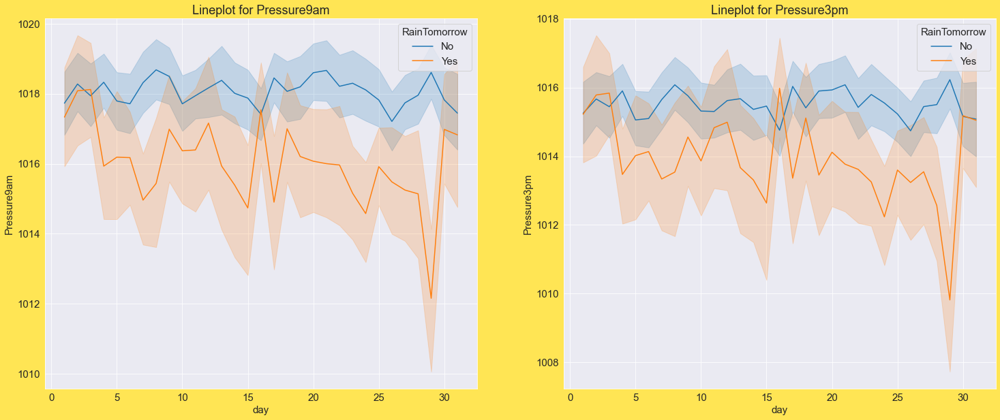

In [149]:
fig, axes = plt.subplots(1, 2, figsize=(25, 10))

# Pressure9am
sns.lineplot(ax=axes[0],x="day",y="Pressure9am",hue="RainTomorrow",data=rain)
axes[0].set_title('Lineplot for Pressure9am')
# Pressure3pm
sns.lineplot(ax=axes[1],x="day",y="Pressure3pm",hue="RainTomorrow",data=rain)
axes[1].set_title('Lineplot for Pressure3pm')
plt.show()

We can observe that  if difference of pressure at 3pm and 9am is low then probability of rain occuring tomorrow is also low.

### Encoding the Target variable

In [150]:
# Before further analysis we need to encode one of our target categorical feature RainTomorrow
# Here we are encoding the categorical features which are having only 2 unique categories
# We can use label encoding for target and features with binary categories as well.
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()

# We have already filtered the binary categorical varaibles
for i in binary_categorical_features:
    rain[i] = le.fit_transform(rain[i])


In [151]:
# checking the feature
rain['RainTomorrow'].head()

# We can see it is encoded

0    0
1    0
2    0
3    0
4    0
Name: RainTomorrow, dtype: int32

In [152]:
# checking the % of chance if it rains tomorrow
for i in cat_cols:
    print(rain.groupby(i)['RainTomorrow'].mean()*100)
    print('\n')

Location
Adelaide        21.951220
Albury          21.940463
Brisbane        23.316062
CoffsHarbour    30.441899
Darwin          12.800000
Melbourne       25.197628
Newcastle       24.087591
Penrith         24.066390
PerthAirport    20.099668
Uluru            0.000000
Williamtown     24.846356
Wollongong      26.582278
Name: RainTomorrow, dtype: float64


WindGustDir
E      12.177122
ENE    15.479115
ESE    21.649485
N      24.619457
NE     23.295455
NNE    24.203822
NNW    29.500000
NW     26.541555
S      27.650728
SE     22.368421
SSE    25.403226
SSW    29.213483
SW     25.450902
W      20.210526
WNW    24.806202
WSW    26.593407
Name: RainTomorrow, dtype: float64


WindDir9am
E      12.771739
ENE    14.454976
ESE    24.696356
N      26.622951
NE     20.707071
NNE    27.067669
NNW    26.400000
NW     20.973154
S      22.074468
SE     18.789144
SSE    20.783133
SSW    24.523810
SW     28.992248
W      26.686217
WNW    27.765237
WSW    23.711340
Name: RainTomorrow, dtype: float64


W

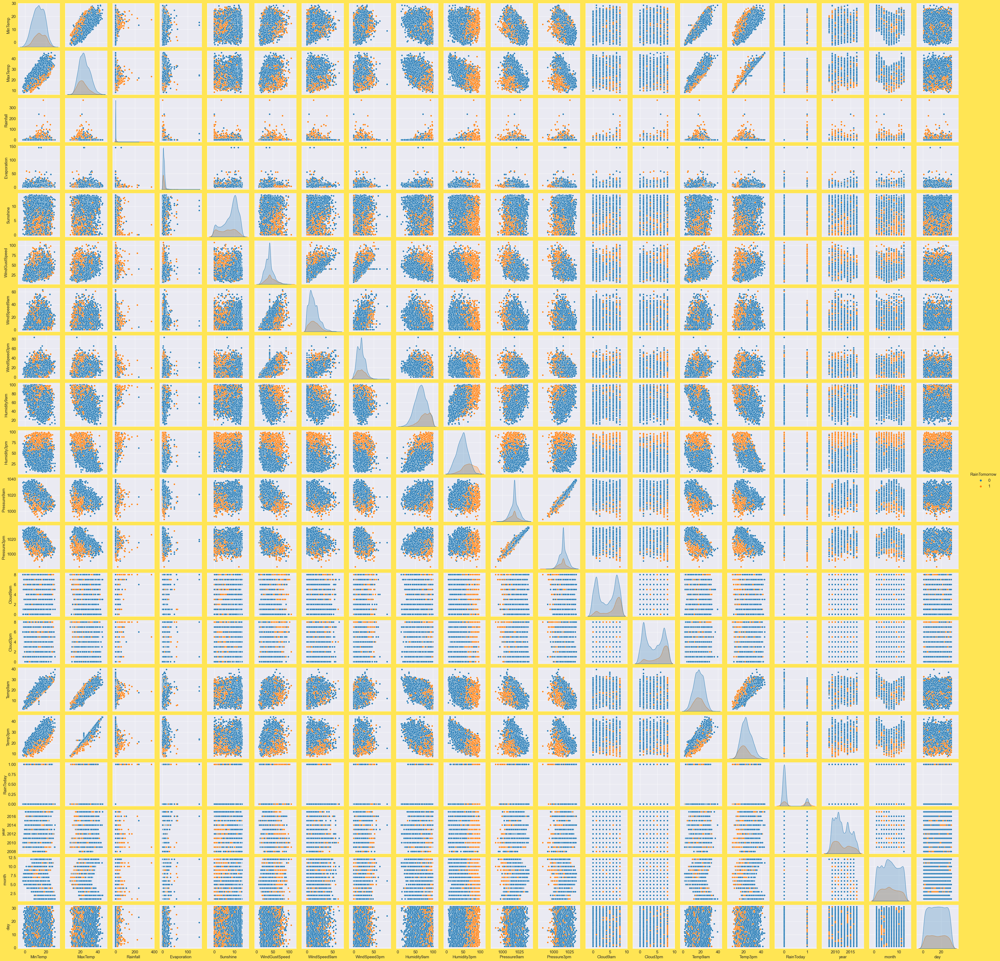

In [153]:
# plotting a pairplot with respect to the target
sns.pairplot(rain,hue='RainTomorrow')

In [154]:
# here we are going to create 2 duplicates of  the dataframe rain 
# one for creating a classification model for predicting RainTomorrow
# Other for creating a regression model for predicting mm of Rainfall in a day.

rain_tomorrow = rain.copy()
rainfall = rain.copy()

## Checking and treating outliers

In [155]:
cont_cols

['MinTemp',
 'MaxTemp',
 'Evaporation',
 'Sunshine',
 'WindGustSpeed',
 'WindSpeed9am',
 'WindSpeed3pm',
 'Humidity9am',
 'Humidity3pm',
 'Pressure9am',
 'Pressure3pm',
 'Cloud9am',
 'Cloud3pm',
 'Temp9am',
 'Temp3pm']

In [156]:
# creating a function for ploting outliers
def outlier_check(rain_tomorrow,cont_cols):
    # creating a  copy of dataframe
    data = rain_tomorrow[cont_cols].copy()
    # subplots 
    fig, axes = plt.subplots(nrows=len(data.columns)//2, ncols=2,figsize=(15,20))
    fig.subplots_adjust(hspace=0.7)
    
    # our main distplot
    for ax, feature in zip(axes.flatten(), data.columns):
        sns.boxplot(data[feature],ax=ax)
        ax.set_title(f'Outliers in {feature}')
    plt.show()
    
# We can see there are many outliers in Rainfall as well
# We should first remove outliers from the columns and Rainfall as well for only classification model
# For regression model we should not touch Rainfall as it will be our target variable

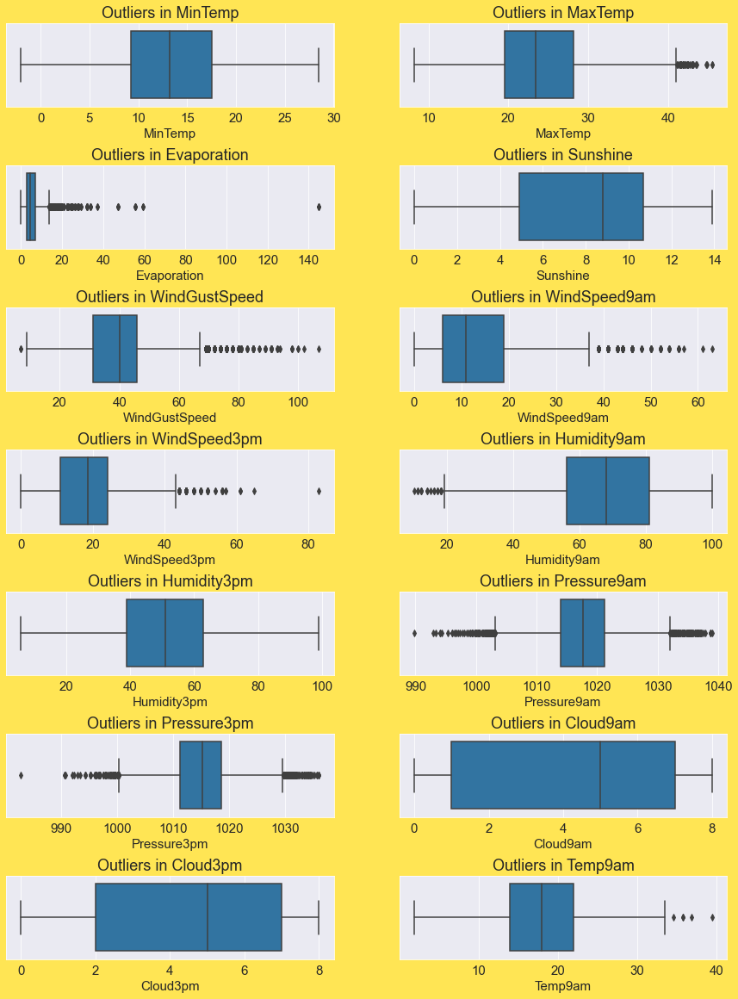

In [157]:
outlier_check(rain_tomorrow,cont_cols)

In [158]:
# Removing the outliers using zscore method
# using zscore method
from scipy.stats import zscore

outlier_cols = rain_tomorrow[['MinTemp','MaxTemp','Evaporation','Sunshine','WindGustSpeed','WindSpeed9am','WindSpeed3pm','Humidity9am','Humidity3pm','Pressure9am','Pressure3pm','Cloud9am','Cloud3pm','Temp9am','Temp3pm']]

z=np.abs(zscore(outlier_cols))

print(np.where(z>3))

(array([  12,   12,   20,   44,   44,   52,   52,   60,   60,   61,   61,
         62,   62,   62,   67,   67,   68,   68,  123,  123,  159,  168,
        198,  214,  267,  270,  296,  381,  381,  404,  405,  405,  406,
        406,  407,  407,  466,  466,  466,  521,  563,  567,  568,  568,
        569,  602,  603,  632,  683,  683,  748,  748,  795,  809,  884,
        980,  980, 1189, 1527, 1535, 1587, 1644, 1648, 1665, 1749, 1765,
       1782, 1809, 1898, 1903, 1936, 1945, 2016, 2027, 2028, 2043, 2074,
       2164, 2165, 2186, 2193, 2219, 2219, 2230, 2244, 2500, 2505, 2527,
       2527, 2571, 2708, 2746, 2761, 2835, 2855, 2859, 2863, 2869, 2877,
       2883, 2891, 2902, 2905, 2911, 2919, 2933, 2939, 2947, 2953, 2961,
       2967, 2972, 2975, 2989, 3051, 3055, 3058, 3059, 3059, 3060, 3066,
       3067, 3067, 3067, 3068, 3070, 3082, 3082, 3082, 3089, 3089, 3099,
       3099, 3141, 3153, 3153, 3157, 3164, 3167, 3169, 3172, 3172, 3178,
       3206, 3212, 3212, 3213, 3221, 3227, 3234, 3

In [159]:
# removing outliers
rain_tomorrow_df = rain_tomorrow[(z<3).all(axis=1)]

In [160]:
# checking the % of dataloss after removing the outliers

print("shape before and after")
print("shape before: ",rain_tomorrow.shape)
print("shape after: ",rain_tomorrow_df.shape)
print("Percentage Loss: ",(rain_tomorrow.shape[0]-rain_tomorrow_df.shape[0])/rain_tomorrow.shape[0]*100)

# We can see there is 4% data loss which is optimal

shape before and after
shape before:  (7724, 25)
shape after:  (7398, 25)
Percentage Loss:  4.220611082340756


In [161]:
# CHECKING WITH THE iqr method as well
Q1=outlier_cols.quantile(0.25)
Q3=outlier_cols.quantile(0.75)
IQR=Q3 - Q1

rain_tomorrow_quant = rain_tomorrow[~((rain_tomorrow < (Q1 - 1.5 * IQR)) |(rain_tomorrow > (Q3 + 1.5 * IQR))).any(axis=1)]

In [162]:
# checking the % of dataloss after removing the outliers

print("shape before and after")
print("shape before: ",rain_tomorrow.shape)
print("shape after: ",rain_tomorrow_quant.shape)
print("Percentage Loss: ",(rain_tomorrow.shape[0]-rain_tomorrow_quant.shape[0])/rain_tomorrow.shape[0]*100)

# We can see there is 11% data loss by using IQR method so we will stick to zscore method

shape before and after
shape before:  (7724, 25)
shape after:  (6851, 25)
Percentage Loss:  11.302433972035216


In [163]:
rain_tomorrow_df.head()

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,year,month,day
0,Albury,13.4,22.9,0.6,3.0,13.8,W,44.0,W,WNW,20.0,24.0,71.0,22.0,1007.7,1007.1,8.0,8.0,16.9,21.8,0,0,2008,12,1
1,Albury,7.4,25.1,0.0,2.2,7.6,WNW,44.0,NNW,WSW,4.0,22.0,44.0,25.0,1010.6,1007.8,1.0,4.0,17.2,24.3,0,0,2008,12,2
2,Albury,12.9,25.7,0.0,4.6,7.7,WSW,46.0,W,WSW,19.0,26.0,38.0,30.0,1007.6,1008.7,2.0,2.0,21.0,23.2,0,0,2008,12,3
3,Albury,9.2,28.0,0.0,1.8,8.0,NE,24.0,SE,E,11.0,9.0,45.0,16.0,1017.6,1012.8,8.0,7.0,18.1,26.5,0,0,2008,12,4
4,Albury,17.5,32.3,1.0,3.8,11.9,W,41.0,ENE,NW,7.0,20.0,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,0,0,2008,12,5


In [164]:
# checking the outliers again
def outlier_check(rain_tomorrow_df,cont_cols):
    # creating a  copy of dataframe
    data = rain_tomorrow_df[cont_cols].copy()
    # subplots 
    fig, axes = plt.subplots(nrows=len(data.columns)//2, ncols=2,figsize=(15,20))
    fig.subplots_adjust(hspace=0.7)
    
    # our main distplot
    for ax, feature in zip(axes.flatten(), data.columns):
        sns.boxplot(data[feature],ax=ax)
        ax.set_title(f'Outliers in {feature}')
    plt.show()
    
# We can observe that the outliers have been removed

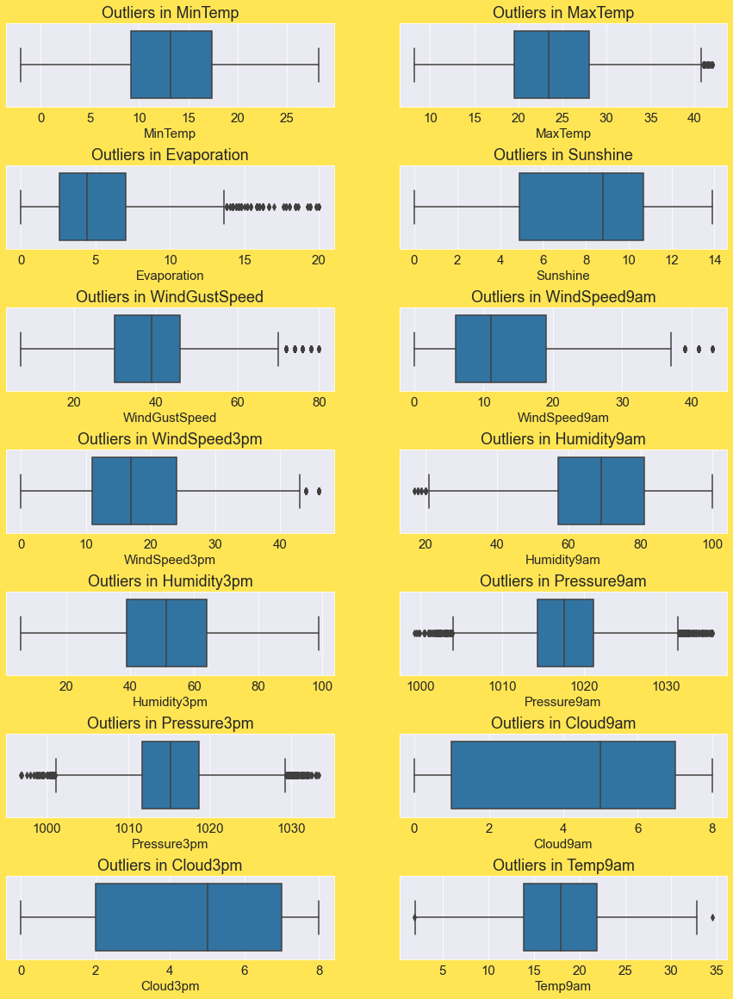

In [165]:
outlier_check(rain_tomorrow_df,cont_cols)

## Checking and removing the skewness

In [170]:
rain_tomorrow_df.skew().sort_values()

Sunshine         -0.557393
Cloud9am         -0.278320
Humidity9am      -0.246068
Cloud3pm         -0.180834
MinTemp          -0.103581
Temp9am          -0.057588
day               0.006885
Pressure9am       0.037713
Pressure3pm       0.047022
month             0.056776
Humidity3pm       0.117027
WindSpeed3pm      0.315403
MaxTemp           0.324020
year              0.340524
Temp3pm           0.345650
WindGustSpeed     0.487392
WindSpeed9am      0.676951
Evaporation       1.055517
RainToday         1.255169
RainTomorrow      1.263199
Rainfall         13.816757
dtype: float64

In [171]:
# checking the contiuous columns
rain_tomorrow_df[cont_cols].skew().sort_values()

Sunshine        -0.557393
Cloud9am        -0.278320
Humidity9am     -0.246068
Cloud3pm        -0.180834
MinTemp         -0.103581
Temp9am         -0.057588
Pressure9am      0.037713
Pressure3pm      0.047022
Humidity3pm      0.117027
WindSpeed3pm     0.315403
MaxTemp          0.324020
Temp3pm          0.345650
WindGustSpeed    0.487392
WindSpeed9am     0.676951
Evaporation      1.055517
dtype: float64

In [172]:
# plotting a distribution plot
def skewness_check(rain_tomorrow_df,cont_cols):
    # creating a  copy of dataframe
    data = rain_tomorrow_df[cont_cols].copy()
    # subplots 
    fig, axes = plt.subplots(nrows=len(data.columns)//2, ncols=2,figsize=(15,20))
    fig.subplots_adjust(hspace=0.7)
    
    # our main distplot
    for ax, feature in zip(axes.flatten(), data.columns):
        sns.distplot(data[feature],ax=ax)
        ax.set_title(f'Distribution of {feature}')
    plt.show()
    
    


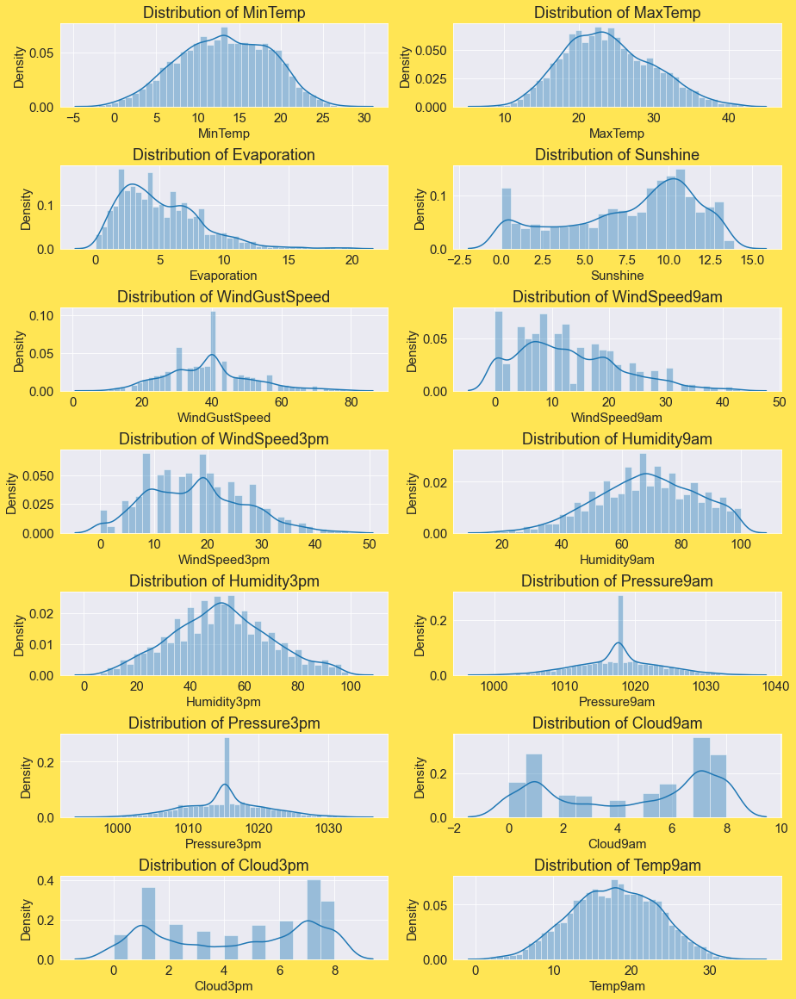

In [173]:
skewness_check(rain_tomorrow_df,cont_cols)

# We can see there is high amount of skewness present in some columns

In [174]:
rain_tomorrow_df[cont_cols].skew().sort_values(ascending=False)

# keeping the skewness threshold to +- 0.3
# We will having to remove skewness from 'Evaporation','Sunshine','WindSpeed9am' and 'WindGustSpeed'

Evaporation      1.055517
WindSpeed9am     0.676951
WindGustSpeed    0.487392
Temp3pm          0.345650
MaxTemp          0.324020
WindSpeed3pm     0.315403
Humidity3pm      0.117027
Pressure3pm      0.047022
Pressure9am      0.037713
Temp9am         -0.057588
MinTemp         -0.103581
Cloud3pm        -0.180834
Humidity9am     -0.246068
Cloud9am        -0.278320
Sunshine        -0.557393
dtype: float64

In [175]:
skewed_cols = ['Evaporation','Sunshine','WindSpeed9am','WindGustSpeed']
skewed_cols

['Evaporation', 'Sunshine', 'WindSpeed9am', 'WindGustSpeed']

In [176]:
# using powertransformer method to remove skewness
from sklearn.preprocessing import PowerTransformer
pt = PowerTransformer(method='yeo-johnson')

In [177]:
# fitting the power transformer 
rain_tomorrow_df[skewed_cols] = pt.fit_transform(rain_tomorrow_df[skewed_cols].values)

In [178]:
# checking skewness again
rain_tomorrow_df[skewed_cols].skew().sort_values()

Sunshine        -0.400366
WindSpeed9am    -0.122453
Evaporation     -0.015063
WindGustSpeed    0.003675
dtype: float64

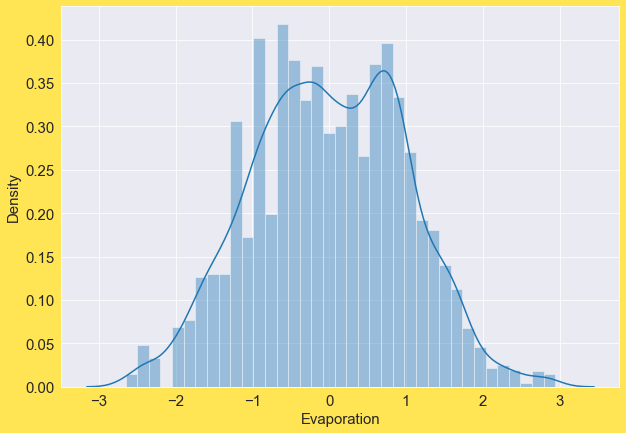

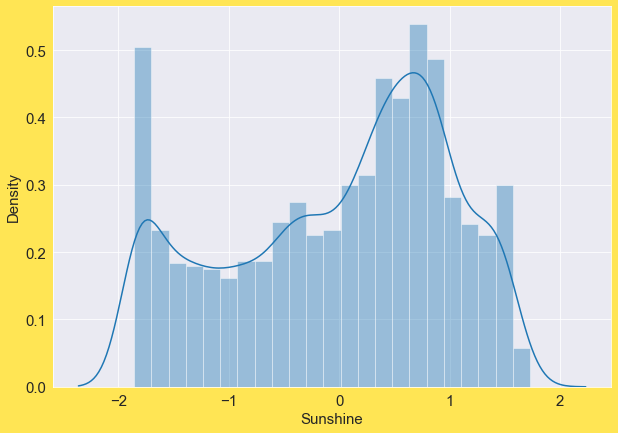

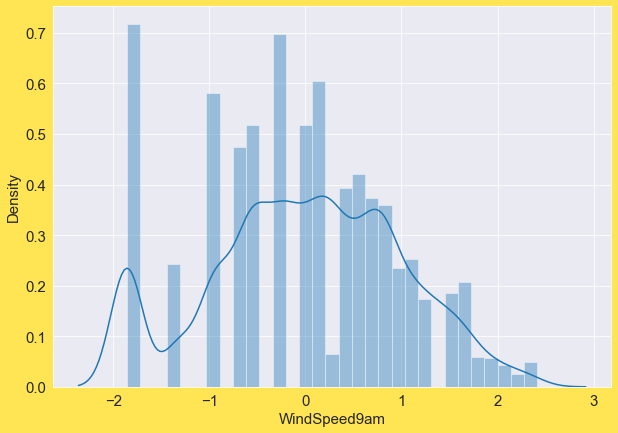

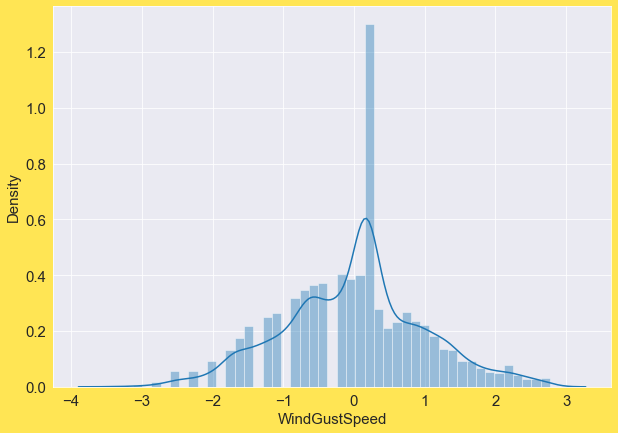

In [179]:
# checking plots of the skewed_cols after transformation
for i in skewed_cols:
    sns.distplot(rain_tomorrow_df[i])
    plt.show()

In [180]:
# encoding the rest of the features
# Removing RainToday from cat_cols as it is already encoded
cat_cols.remove('RainToday')
cat_cols

['Location', 'WindGustDir', 'WindDir9am', 'WindDir3pm']

In [181]:
# using onehot encoding to encode these nominal categorical features
from sklearn.preprocessing import OneHotEncoder
ohe = OneHotEncoder(drop='first') # We are dropping one dummy column from each encoded feature to avoid multicollinearity

df_object = rain_tomorrow_df.select_dtypes('object')
ohe.fit(df_object)

codes = ohe.transform(df_object).toarray()
feature_names = ohe.get_feature_names(cat_cols)

rain_en = pd.concat([rain_tomorrow_df.select_dtypes(exclude='object'),
pd.DataFrame(codes,columns=feature_names).astype(int)], axis=1)

In [183]:
print('Shape Before Encoding ',rain_tomorrow_df.shape)
print('\n')
print('Shape After Encoding ',rain_en.shape)

# We got 77 new columns

Shape Before Encoding  (7398, 25)


Shape After Encoding  (8410, 77)


In [184]:
rain_en = rain_en.dropna()

## Correlation

In [101]:
rain_en.corr().T

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,year,month,day,Location_Albury,Location_Brisbane,Location_CoffsHarbour,Location_Darwin,Location_Melbourne,Location_Newcastle,Location_Penrith,Location_PerthAirport,Location_Uluru,Location_Williamtown,Location_Wollongong,WindGustDir_ENE,WindGustDir_ESE,WindGustDir_N,WindGustDir_NE,WindGustDir_NNE,WindGustDir_NNW,WindGustDir_NW,WindGustDir_S,WindGustDir_SE,WindGustDir_SSE,WindGustDir_SSW,WindGustDir_SW,WindGustDir_W,WindGustDir_WNW,WindGustDir_WSW,WindDir9am_ENE,WindDir9am_ESE,WindDir9am_N,WindDir9am_NE,WindDir9am_NNE,WindDir9am_NNW,WindDir9am_NW,WindDir9am_S,WindDir9am_SE,WindDir9am_SSE,WindDir9am_SSW,WindDir9am_SW,WindDir9am_W,WindDir9am_WNW,WindDir9am_WSW,WindDir3pm_ENE,WindDir3pm_ESE,WindDir3pm_N,WindDir3pm_NE,WindDir3pm_NNE,WindDir3pm_NNW,WindDir3pm_NW,WindDir3pm_S,WindDir3pm_SE,WindDir3pm_SSE,WindDir3pm_SSW,WindDir3pm_SW,WindDir3pm_W,WindDir3pm_WNW,WindDir3pm_WSW
MinTemp,1.000000,0.704168,0.103699,0.197163,0.027361,0.257269,0.157698,0.182906,-0.102944,0.130845,-0.391058,-0.373005,0.081218,0.057932,0.887583,0.670751,0.111740,0.127157,0.039043,-0.267554,0.021103,-0.202109,-0.022436,0.002105,0.013784,0.000198,0.031393,-0.073618,0.109634,0.037901,-0.005529,0.142649,-0.001259,-0.043115,0.013479,0.015733,0.007267,-0.005534,0.000808,0.031161,-0.006514,-0.005035,0.032275,0.004811,-0.049996,-0.036354,0.019337,0.039294,-0.022881,-0.035382,0.059483,0.027129,-0.020918,-0.013637,-0.002887,-0.036427,0.019670,0.040416,0.010827,-0.019888,-0.012184,0.014392,-0.032236,-0.029507,-0.008059,0.013619,0.008199,0.022356,-0.019876,0.020312,0.018166,0.007269,-0.000641,0.032457,-0.027002,-0.027668,-0.002132
MaxTemp,0.704168,1.000000,-0.075713,0.253628,0.199013,0.147057,-0.019505,0.084169,-0.357242,-0.389652,-0.324295,-0.392130,-0.183652,-0.174340,0.851819,0.972109,-0.188042,-0.127076,0.095070,-0.171037,0.025339,-0.031648,-0.057239,-0.036529,0.061569,-0.153528,0.027099,-0.002977,0.108516,0.083498,-0.002482,0.085147,0.002515,-0.016872,-0.025362,0.022311,0.003017,-0.004683,0.015887,0.006828,0.017770,-0.023069,0.023751,0.008459,-0.025621,-0.016145,0.004587,0.043434,0.027151,-0.064653,0.057261,0.013292,-0.011092,-0.034140,0.026999,0.020973,0.044430,0.032724,-0.026571,-0.043767,-0.025194,-0.002621,-0.022619,-0.008521,-0.041823,0.020384,-0.010267,0.017494,-0.001800,-0.008656,0.025543,-0.003964,-0.006099,0.030228,-0.010944,-0.009865,0.002440
Rainfall,0.103699,-0.075713,1.000000,-0.035722,-0.104823,0.078827,0.069021,0.028426,0.220536,0.234245,-0.035537,0.002447,0.151697,0.119260,0.008030,-0.079573,0.448252,0.212174,0.009109,-0.021004,-0.012125,-0.029784,0.002250,0.051947,-0.002519,-0.013063,0.024056,-0.014725,-0.022284,-0.017828,0.007081,0.012839,0.013160,-0.006474,0.026792,0.003823,0.001217,-0.017717,0.002578,-0.007039,-0.000765,0.024417,0.009716,-0.019723,-0.006486,-0.015741,-0.016331,0.001264,0.000048,0.021128,-0.011256,0.002662,0.022074,-0.001131,0.009813,-0.017264,0.003984,0.013169,-0.013968,-0.014295,0.001497,-0.002845,-0.010807,0.013491,-0.004651,0.010361,0.010540,0.010185,0.018155,-0.012526,0.006717,0.019843,-0.020461,-0.018017,0.005152,-0.017664,-0.027049
Evaporation,0.197163,0.253628,-0.035722,1.000000,0.163731,0.125261,0.073567,0.078181,-0.192976,-0.128191,-0.164247,-0.168314,-0.055745,-0.075698,0.241183,0.244254,-0.095228,-0.063329,0.059219,-0.016564,0.002963,0.012687,-0.004561,-0.111525,0.047156,-0.075824,-0.000175,-0.000718,0.044083,0.071635,0.058565,0.028363,0.005539,0.011280,-0.033545,0.022232,-0.008329,-0.001000,0.026547,0.009568,0.011480,-0.031347,-0.003545,0.007866,-0.016445,0.008713,-0.010327,0.032739,0.034722,-0.031566,0.020255,0.010315,-0.007468,-0.004377,0.029439,-0.009158,0.011533,-0.003106,-0.024260,-0.023971,-0.003466,-0.007632,-0.019953,0.005769,-0.015006,-0.020756,-0.020137,0.032686,0.004682,0.002056,0.004623,-0.002087,-0.011745,0.017677,-0.0

<AxesSubplot:>

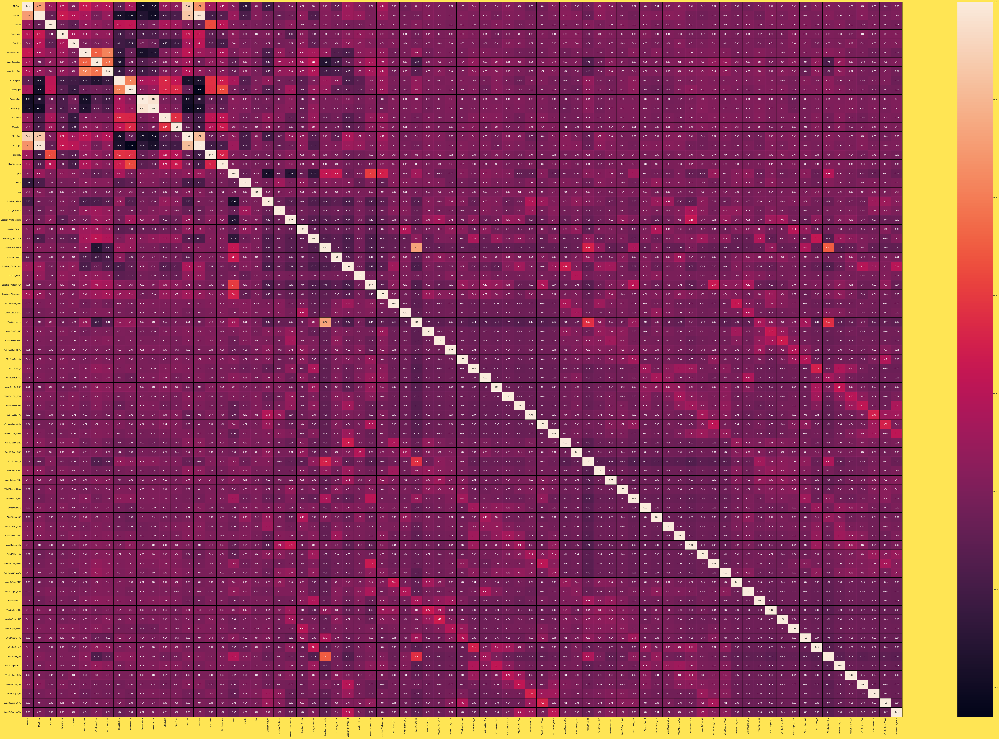

In [102]:
# plotting a heatmap to see the correlation visually
plt.figure(figsize=(150,100))
sns.heatmap(rain_en.corr(),annot=True,linewidths=1.5,linecolor='black',fmt='.2f')
# Saving the figure


Observations:-
    
-> Sunshine has a negative correlation of 16% with the target column(being considered) which can be considered as good bond

-> Temp3pm has a negative correlation of 9% with the target column(being considered) which can be considered as weak bond

-> Pressure9am has a negative correlation of 7% with the target column(being considered) which can be considered as weak bond

-> MaxTemp has a negative correlation of 9% with the target column(being considered) which can be considered as weak bond

-> Pressure3pm has a negative correlation of 3% with the target column(being considered) which can be considered as weak bond

-> Temp9am has a negative correlation of 0% with the target column(being considered) which can be considered as NO BOND

-> Location has a positive correlation of 0% with the target column(being considered) which can be considered as NO BOND bond

-> Evaporation has a positive correlation of 2% with the target column(being considered) which can be considered as weak bond

-> WindSpeed3pm has a positive correlation of 2% with the target column(being considered) which can be considered as weak bond

-> WindDir3pm has a positive correlation of 4% with the target column(being considered) which can be considered as weak bond

-> WindGustDir has a positive correlation of 4% with the target column(being considered) which can be considered as weak bond

-> WindSpeed9am has a positive correlation of 5% with the target column(being considered) which can be considered as weak bond

-> WindGustSpeed positive correlation of 9% with the target column(being considered) which can be considered as fair bond

-> MinTemp positive correlation of 9% with the target column(being considered) which can be considered as fair bond

-> WindDir9am has a positive correlation of 9% with the target column(being considered) which can be considered as weak bond

-> Cloud3pm positive correlation of 15% with the target column(being considered) which can be considered as good bond

-> Cloud9am positive correlation of 19% with the target column(being considered) which can be considered as good bond

-> RainTomorrow positive correlation of 22% with the target column(being considered) which can be considered as good bond

-> Humidity9am positive correlation of 23% with the target column(being considered) which can be considered as good bond

-> Humidity3pm positive correlation of 24% with the target column(being considered) which can be considered as good bond

-> RainToday positive correlation of 46% with the target column(being considered) which can be considered as good bond

-> Feature with Maximum correlation = RainToday

-> Features with Minimum correlation = Most of the encoded Location columns and Temp9am

In [103]:
# lets look at the correlation of features with respect to the target RainTomorrow
rain_en.corr()['RainTomorrow'].sort_values()

Sunshine                -0.182737
Temp3pm                 -0.170204
MaxTemp                 -0.127076
Pressure9am             -0.107713
Pressure3pm             -0.082125
Evaporation             -0.063329
Location_Uluru          -0.033491
Location_PerthAirport   -0.032006
WindDir3pm_WSW          -0.028093
WindGustDir_WNW         -0.026479
Location_Albury         -0.026297
WindDir9am_NE           -0.021400
month                   -0.021210
WindDir9am_S            -0.020439
WindGustDir_SW          -0.017645
Location_Williamtown    -0.017004
day                     -0.016219
WindGustDir_SSW         -0.013611
WindDir3pm_W            -0.011474
WindDir9am_ESE          -0.010515
WindDir3pm_NW           -0.010097
WindDir3pm_WNW          -0.009536
WindDir9am_NNE          -0.008194
WindGustDir_S           -0.007768
WindDir3pm_N            -0.007027
WindDir3pm_ESE          -0.006640
Location_Brisbane       -0.006287
WindDir9am_SSE          -0.005937
WindDir3pm_S            -0.003377
WindDir3pm_NNE

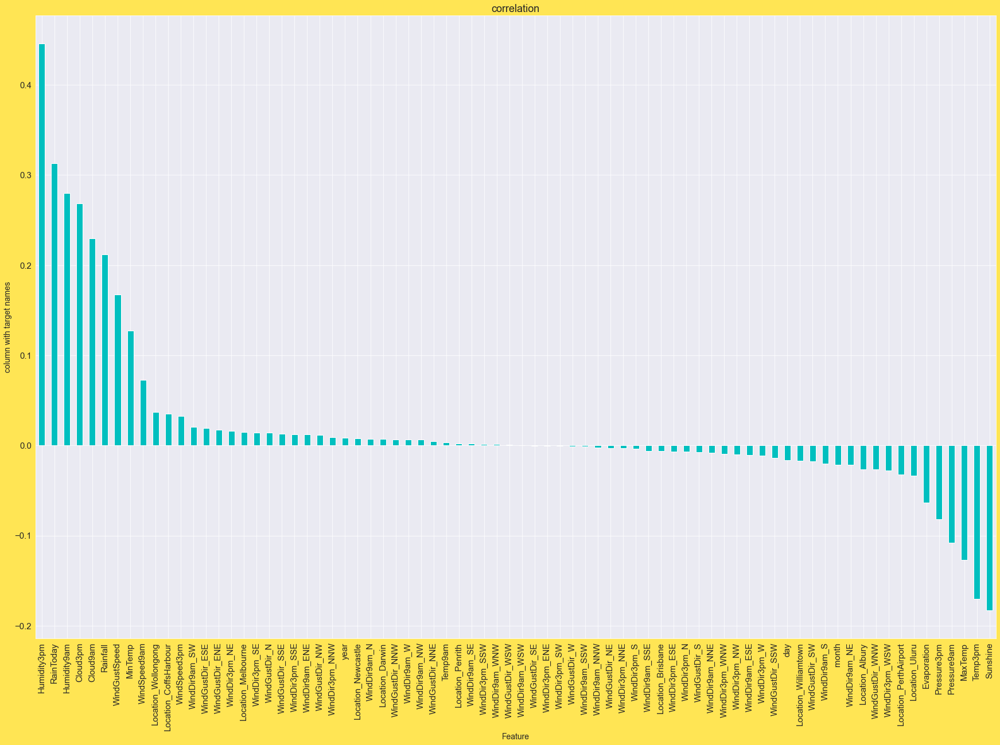

In [104]:
# plotting the same using a barplot
plt.figure(figsize=(30,20))
rain_en.corr()['RainTomorrow'].sort_values(ascending=False).drop(['RainTomorrow']).plot(kind='bar',color='c')
plt.xlabel('Feature',fontsize=14)
plt.ylabel('column with target names',fontsize=14)
plt.title('correlation',fontsize=18)
plt.show()

## Seperating the features(x) and Target(y)

In [105]:
x = rain_en.drop(['RainTomorrow'],axis=1)
y = rain_en['RainTomorrow']

## Scaling the data

In [106]:
# inorder to check the multicollinearity we have to scale the data
# importing StandardScaler
from sklearn.preprocessing import StandardScaler
sc=StandardScaler()
x = pd.DataFrame(sc.fit_transform(x),columns=x.columns)

## Checking Multicollinearity

In [107]:
# importing vif 
from statsmodels.stats.outliers_influence import variance_inflation_factor

In [108]:
def vif_calc():
    vif=pd.DataFrame()
    vif["vif_Features"]=[variance_inflation_factor(x.values, i) for i in range(x.shape[1])]
    vif["Features"]=x.columns
    return vif

In [109]:
vif_calc()

# We have got high vif score in Temperature,Pressure and LocationPerthAirport columns
# lets drop the highest vif scores one by one and check if the score is reducoing

,vif_Features,Features
0,10.118686,MinTemp
1,23.515106,MaxTemp
2,1.296666,Rainfall
3,1.150289,Evaporation
4,1.169597,Sunshine
5,2.365113,WindGustSpeed
6,2.325466,WindSpeed9am
7,2.115326,WindSpeed3pm
8,4.254654,Humidity9am
9,5.475002,Humidity3pm


In [110]:
# let's first remove temp_3pm and run the function again
x.drop(['Temp3pm'],axis=1,inplace=True)

In [111]:
vif_calc()

,vif_Features,Features
0,10.073610,MinTemp
1,9.249687,MaxTemp
2,1.293919,Rainfall
3,1.150247,Evaporation
4,1.169288,Sunshine
5,2.358379,WindGustSpeed
6,2.325438,WindSpeed9am
7,2.113142,WindSpeed3pm
8,3.777768,Humidity9am
9,3.700722,Humidity3pm


In [114]:
# removing temp9am as well
x.drop(['Temp9am'],axis=1,inplace=True)

In [115]:
vif_calc()

,vif_Features,Features
0,4.970712,MinTemp
1,5.402042,MaxTemp
2,1.293764,Rainfall
3,1.150225,Evaporation
4,1.168529,Sunshine
5,2.324942,WindGustSpeed
6,2.295308,WindSpeed9am
7,2.079842,WindSpeed3pm
8,2.536831,Humidity9am
9,3.085240,Humidity3pm


In [116]:
# Now we still have Pressure columns with high vif
# removing Pressure3pm
x.drop(['Pressure3pm'],axis=1,inplace=True)

In [117]:
vif_calc()

,vif_Features,Features
0,4.758413,MinTemp
1,4.933899,MaxTemp
2,1.292230,Rainfall
3,1.149445,Evaporation
4,1.168329,Sunshine
5,2.322992,WindGustSpeed
6,2.293704,WindSpeed9am
7,2.056072,WindSpeed3pm
8,2.531137,Humidity9am
9,3.081561,Humidity3pm


In [118]:
# Now removing Location_PerthAirport
x.drop(['Location_PerthAirport'],axis=1,inplace=True)

In [119]:
vif_calc()

# Now  We can observe that the multicolllinearity is resolved

,vif_Features,Features
0,4.755541,MinTemp
1,4.933832,MaxTemp
2,1.291887,Rainfall
3,1.149031,Evaporation
4,1.166939,Sunshine
5,2.321177,WindGustSpeed
6,2.285298,WindSpeed9am
7,2.050839,WindSpeed3pm
8,2.514906,Humidity9am
9,3.081358,Humidity3pm


## Treating imbalance data

<AxesSubplot:xlabel='RainTomorrow', ylabel='count'>

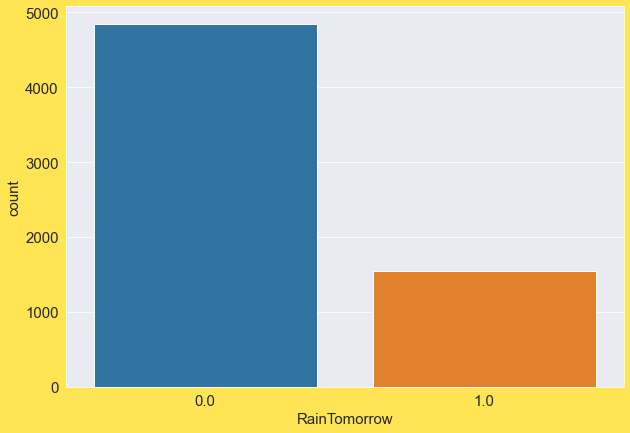

In [120]:
# Remember we have imbalance data in our target RainTomorrow
sns.countplot(y)
# We can see that there are more categories of No than Yes
# We have to balance the data

In [121]:
# Balancing the data using SMOTE by Oversampling method imported from IMBLEARN 
from imblearn.over_sampling import SMOTE
SM = SMOTE()
x, y = SM.fit_resample(x,y)

<AxesSubplot:xlabel='RainTomorrow', ylabel='count'>

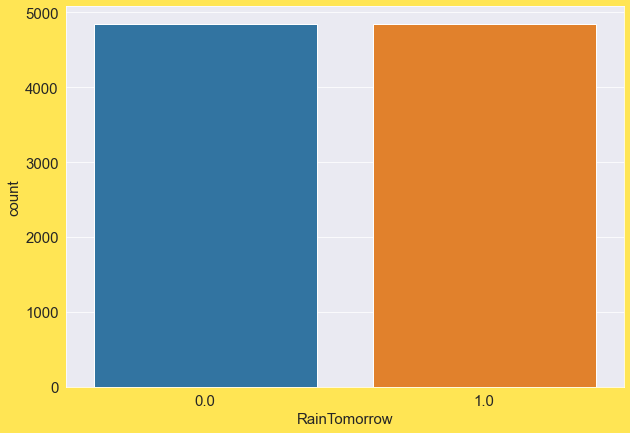

In [122]:
# checking the count again
sns.countplot(y)

# Now we can see it is balanced

## Model Building

In [123]:
# importing all the necessary models and metrics
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier 
from sklearn.linear_model import SGDClassifier
from xgboost import XGBClassifier
from sklearn.ensemble import RandomForestClassifier,AdaBoostClassifier,GradientBoostingClassifier,ExtraTreesClassifier


from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score,confusion_matrix,classification_report

from sklearn.model_selection import GridSearchCV
from sklearn.pipeline import Pipeline

In [124]:
# Creating instances for models
lor = LogisticRegression()
svc = SVC()
dtc = DecisionTreeClassifier()
knc = KNeighborsClassifier()
sgdc = SGDClassifier()
xgbc = XGBClassifier()
rfc = RandomForestClassifier()
abc = AdaBoostClassifier()
gbc = GradientBoostingClassifier()
etc = ExtraTreesClassifier()

## Logistic Regression

In [126]:
# finding the best random state for logistic regression
lor = LogisticRegression()
for i in range(0,500):
    x_train,x_test,y_train,y_test = train_test_split(x,y,test_size=0.30,random_state=i)
    lor.fit(x_train,y_train)
    pred_train = lor.predict(x_train)
    pred_test = lor.predict(x_test)
    if round(accuracy_score(y_train,pred_train)*100,1) == round(accuracy_score(y_test,pred_test)*100,1):
        print('At random state',i,'The model performs very well')
        print('At random state:-',i)
        print('Training accuracy score is ', round(accuracy_score(y_train,pred_train)*100,1))
        print('Testing accuracy score is ', round(accuracy_score(y_test,pred_test)*100,1), '\n\n')

At random state 13 The model performs very well
At random state:- 13
Training accuracy score is  78.1
Testing accuracy score is  78.1 


At random state 56 The model performs very well
At random state:- 56
Training accuracy score is  78.2
Testing accuracy score is  78.2 


At random state 59 The model performs very well
At random state:- 59
Training accuracy score is  78.1
Testing accuracy score is  78.1 


At random state 78 The model performs very well
At random state:- 78
Training accuracy score is  78.2
Testing accuracy score is  78.2 


At random state 97 The model performs very well
At random state:- 97
Training accuracy score is  78.1
Testing accuracy score is  78.1 


At random state 120 The model performs very well
At random state:- 120
Training accuracy score is  77.9
Testing accuracy score is  77.9 


At random state 230 The model performs very well
At random state:- 230
Training accuracy score is  78.3
Testing accuracy score is  78.3 


At random state 250 The model perform

In [127]:
# We have got 78.3 accuracy at random state 230
# At random state 349 the model performs well
x_train,x_test,y_train,y_test = train_test_split(x,y,test_size=.30,random_state=230)

In [131]:
# Running the model with best random state
lor.fit(x_train,y_train)
pred_train_lor = lor.predict(x_train)
pred_test_lor = lor.predict(x_test)
print('Accuracy Score of lor: ',accuracy_score(y_test,pred_test_lor))
print('\n')
print('Confusion Matrix: ',confusion_matrix(y_test,pred_test_lor))
print('\n')
print('Classification Report: ',classification_report(y_test,pred_test_lor))


# getting 78% accuracy with logistic regression

Accuracy Score of lor:  0.7831325301204819


Confusion Matrix:  [[1178  294]
 [ 336 1097]]


Classification Report:                precision    recall  f1-score   support

         0.0       0.78      0.80      0.79      1472
         1.0       0.79      0.77      0.78      1433

    accuracy                           0.78      2905
   macro avg       0.78      0.78      0.78      2905
weighted avg       0.78      0.78      0.78      2905



In [132]:
# lets check the cv score of lor
lss = accuracy_score(y_test,pred_test_lor) # creating an instance for acccuracy score
from sklearn.model_selection import cross_val_score

In [141]:
# running a for loop to find the best cv value which gives best score
for j in range(65,71):
    lsscore = cross_val_score(lor,x,y,cv=j)
    print(lsscore)
    lsc = lsscore.mean()
    print('At cv:- ',j)
    print('Cross validation score is:- ',lsc*100)
    print('accuracy_score is:- ',lss*100)
    print('\n')
    
# We can see that the cv score is almost same as the accuracy score
# So our model is running well

[0.88590604 0.81208054 0.75838926 0.86577181 0.83221477 0.73154362
 0.67785235 0.77181208 0.67785235 0.66442953 0.76510067 0.61744966
 0.53691275 0.77181208 0.7114094  0.69798658 0.76510067 0.63758389
 0.67785235 0.75167785 0.61073826 0.62416107 0.61744966 0.85234899
 0.83892617 0.73825503 0.82550336 0.87248322 0.75838926 0.84563758
 0.7852349  0.74496644 0.73154362 0.55704698 0.73825503 0.74496644
 0.73825503 0.7852349  0.77852349 0.69127517 0.53020134 0.65100671
 0.81879195 0.85234899 0.82550336 0.69798658 0.79865772 0.76510067
 0.69798658 0.66442953 0.7114094  0.6442953  0.7852349  0.89261745
 0.87248322 0.75838926 0.80536913 0.89261745 0.70469799 0.81879195
 0.83221477 0.88590604 0.68243243 0.78378378 0.66216216]
At cv:-  65
Cross validation score is:-  74.65284851190891
accuracy_score is:-  78.3132530120482


[0.88435374 0.80272109 0.75510204 0.87755102 0.82312925 0.7414966
 0.66666667 0.78231293 0.68707483 0.65986395 0.74829932 0.65986395
 0.51020408 0.78911565 0.7414966  0.68707

In [142]:
# selecting cv = 69
lsscore_selected = cross_val_score(lor,x,y,cv=69).mean()
print('The cv score of logistcic Regression is ',lsscore_selected,'\nThe accuracy score of logistic regression is: ',lss)

# Accuracy is  78% for LOR

The cv score of logistcic Regression is  0.7475191988605495 
The accuracy score of logistic regression is:  0.7831325301204819


## DecisionTreeClassifier

In [143]:
# creating a parameter grid to search best parameter using GridSearchCV
paramgrid_dtc = {'criterion':["gini", "entropy", "log_loss"],'splitter':["best", "random"],'min_samples_split':[2,3,4,5,6,7,8],'min_samples_leaf':[0.5,1,1.5,2,2.5,3,3.5,4]}
print(paramgrid_dtc)

{'criterion': ['gini', 'entropy', 'log_loss'], 'splitter': ['best', 'random'], 'min_samples_split': [2, 3, 4, 5, 6, 7, 8], 'min_samples_leaf': [0.5, 1, 1.5, 2, 2.5, 3, 3.5, 4]}


In [144]:
# creating a parameter grid to search best parameter using GridSearchCV
dtc_search = GridSearchCV(dtc,param_grid=paramgrid_dtc,error_score='raise')

In [145]:
# fitting the GRid to training data
dtc_search.fit(x_train,y_train)

GridSearchCV(error_score='raise', estimator=DecisionTreeClassifier(),
             param_grid={'criterion': ['gini', 'entropy', 'log_loss'],
                         'min_samples_leaf': [0.5, 1, 1.5, 2, 2.5, 3, 3.5, 4],
                         'min_samples_split': [2, 3, 4, 5, 6, 7, 8],
                         'splitter': ['best', 'random']})

In [146]:
print(dtc_search.best_score_) # bestscore
print(dtc_search.best_estimator_)
print(dtc_search.best_params_) # best params 

0.8130480357900925
DecisionTreeClassifier(criterion='entropy')
{'criterion': 'entropy', 'min_samples_leaf': 1, 'min_samples_split': 2, 'splitter': 'best'}


In [147]:
# running the model using best parameters
dtc = DecisionTreeClassifier(criterion='entropy',splitter='best',min_samples_leaf=1,min_samples_split=2) 
# using the best parameters
dtc.fit(x_train,y_train)
pred_dtc_test= dtc.predict(x_test)
pred_dtc_train = dtc.predict(x_train)
print('Training score of dtc',accuracy_score(pred_dtc_train,y_train))
print('Accuracy Score of dtc',accuracy_score(pred_dtc_test,y_test))
print('Confusion Matrix of dtc',confusion_matrix(pred_dtc_test,y_test))
print('Classification report of Dtc',classification_report(pred_dtc_test,y_test))
print('\n')


# getting 83% with dtc

Training score of dtc 1.0
Accuracy Score of dtc 0.8302925989672978
Confusion Matrix of dtc [[1232  253]
 [ 240 1180]]
Classification report of Dtc               precision    recall  f1-score   support

         0.0       0.84      0.83      0.83      1485
         1.0       0.82      0.83      0.83      1420

    accuracy                           0.83      2905
   macro avg       0.83      0.83      0.83      2905
weighted avg       0.83      0.83      0.83      2905





In [152]:
# Checking the cross validation of dtc
dtca = accuracy_score(pred_dtc_test,y_test)
for j in range(45,51):
    dtcscore = cross_val_score(dtc,x,y,cv=j)
    print(dtcscore)
    dsc = dtcscore.mean()
    print('At cv:- ',j)
    print('Cross validation score of DTC is:- ',dsc*100)
    print('accuracy_score of DTC is:- ',dtca*100)
    print('\n')

[0.72222222 0.74537037 0.79166667 0.73148148 0.64814815 0.69444444
 0.7037037  0.82325581 0.75348837 0.79534884 0.70697674 0.71162791
 0.65116279 0.71162791 0.67906977 0.79534884 0.84651163 0.81860465
 0.85581395 0.91162791 0.86976744 0.9255814  0.8372093  0.8372093
 0.90232558 0.89302326 0.89302326 0.80465116 0.7627907  0.90697674
 0.81860465 0.82790698 0.8372093  0.83255814 0.79069767 0.89302326
 0.82790698 0.92093023 0.80465116 0.90232558 0.86511628 0.89302326
 0.89302326 0.77209302 0.9255814 ]
At cv:-  45
Cross validation score of DTC is:-  81.18824767920373
accuracy_score of DTC is:-  83.02925989672978


[0.69668246 0.74881517 0.74881517 0.71090047 0.68720379 0.67772512
 0.73933649 0.83412322 0.75829384 0.81990521 0.68720379 0.72037915
 0.60189573 0.62559242 0.69668246 0.76303318 0.87677725 0.83412322
 0.81042654 0.90995261 0.90047393 0.87677725 0.87619048 0.82380952
 0.85238095 0.9        0.9047619  0.87142857 0.87142857 0.80952381
 0.88095238 0.80952381 0.83333333 0.8        0.7

In [153]:
# the cv score at 48 and accuracy score is almost same, so we can say that the model is working well
# cv= 48 for DecisionTree
dtcscore_selected = cross_val_score(dtc,x,y,cv=48).mean()
print('The cv score of DecisionTree is ',dtcscore_selected,'\nThe accuracy score of DecisionTree is: ',dtca)

# DTC =  83%

The cv score of DecisionTree is  0.8132214340837068 
The accuracy score of DecisionTree is:  0.8302925989672978


## SupportVectorClassifier

In [154]:
# Creating parameter grid for  SVC
paramgrid_svc = {'C':[0.1,0.2,0.3],
                 'kernel':['rbf','poly','sigmoid'],
                 'degree':[3,4,5,6],'gamma':['scale','auto'],'decision_function_shape':['ovo','ovr'],'cache_size':[100,150,200,250],'shrinking':[True,False]}
print(paramgrid_svc)

{'C': [0.1, 0.2, 0.3], 'kernel': ['rbf', 'poly', 'sigmoid'], 'degree': [3, 4, 5, 6], 'gamma': ['scale', 'auto'], 'decision_function_shape': ['ovo', 'ovr']}


In [155]:
svc_search = GridSearchCV(svc,param_grid=paramgrid_svc,error_score='raise')

In [156]:
svc_search.fit(x_train,y_train)

GridSearchCV(error_score='raise', estimator=SVC(),
             param_grid={'C': [0.1, 0.2, 0.3],
                         'decision_function_shape': ['ovo', 'ovr'],
                         'degree': [3, 4, 5, 6], 'gamma': ['scale', 'auto'],
                         'kernel': ['rbf', 'poly', 'sigmoid']})

In [157]:
print(svc_search.best_score_)
print(svc_search.best_estimator_)
print(svc_search.best_params_) # best params

0.8189470877009655
SVC(C=0.3, decision_function_shape='ovo')
{'C': 0.3, 'decision_function_shape': 'ovo', 'degree': 3, 'gamma': 'scale', 'kernel': 'rbf'}


In [161]:
# running the model using the best params
svc = SVC(C=1.5,degree=3,gamma='scale',kernel='rbf',cache_size=150,decision_function_shape='ovo',shrinking=True) # using the best parameters
svc.fit(x_train,y_train)
pred_svc_test= svc.predict(x_test)
pred_svc_train = svc.predict(x_train)
print('Training score of svc',accuracy_score(pred_svc_train,y_train))
print('Accuracy Score of svc',accuracy_score(pred_svc_test,y_test))
print('Confusion Matrix of svc',confusion_matrix(pred_svc_test,y_test))
print('Classification report of svc',classification_report(pred_svc_test,y_test))
print('\n')

# We are getting around 87 % accuracy with SVC

Training score of svc 0.9371403275785746
Accuracy Score of svc 0.8777969018932874
Confusion Matrix of svc [[1276  159]
 [ 196 1274]]
Classification report of svc               precision    recall  f1-score   support

         0.0       0.87      0.89      0.88      1435
         1.0       0.89      0.87      0.88      1470

    accuracy                           0.88      2905
   macro avg       0.88      0.88      0.88      2905
weighted avg       0.88      0.88      0.88      2905





In [165]:
# checking the cv score for SVC
svca = accuracy_score(y_test,pred_svc_test) 
for j in range(55,61):
    svccore = cross_val_score(svc,x,y,cv=j)
    print(svccore)
    svcc = svccore.mean()
    print('At cv:- ',j)
    print('Cross validation score is:- ',svcc*100)
    print('accuracy_score is:- ',svca*100)
    print('\n') # cv and accuracy is almost same

[0.89265537 0.85310734 0.86363636 0.88068182 0.82954545 0.77840909
 0.82954545 0.76704545 0.78977273 0.78977273 0.64204545 0.80681818
 0.70454545 0.80113636 0.6875     0.71022727 0.78409091 0.67613636
 0.77840909 0.90340909 0.92045455 0.89772727 0.92613636 0.93181818
 0.89204545 0.96022727 0.88636364 0.86931818 0.75568182 0.79545455
 0.91477273 0.93181818 0.86931818 0.82386364 0.8125     0.80681818
 0.90909091 0.94886364 0.78409091 0.90909091 0.80681818 0.80113636
 0.86363636 0.85795455 0.90909091 0.96590909 0.89204545 0.85227273
 0.92613636 0.89204545 0.94318182 0.90909091 0.89772727 0.85795455
 0.97727273]
At cv:-  55
Cross validation score is:-  84.84766774057991
accuracy_score is:-  87.77969018932875


[0.89017341 0.84393064 0.87283237 0.88439306 0.84393064 0.75144509
 0.8265896  0.76300578 0.78034682 0.80924855 0.6416185  0.78612717
 0.76878613 0.80924855 0.69942197 0.66473988 0.79190751 0.68786127
 0.73410405 0.86705202 0.94797688 0.89017341 0.87283237 0.94219653
 0.9017341  0.93

In [166]:
# selecting cv = 56
svcscore_selected = cross_val_score(svc,x,y,cv=56).mean()
print('The cv score of SVC is ',svcscore_selected,'\nThe accuracy score of SVC is: ',svca)


# 87% from SVC

The cv score of SVC is  0.8490358487123846 
The accuracy score of SVC is:  0.8777969018932874


## KNeighborsClassifier

In [168]:
# paragrid for KNC
paramgrid_knc = {'n_neighbors':[x for x in range(5,10)],'algorithm':['auto','ball_tree','kd_tree'],
                 'leaf_size':[l for l in range(30,36)],'p':[2,3,4,6]}
# writing a list comprehension for leaf_size and n_neighbors instead of writing all the values

In [169]:
knc_search = GridSearchCV(knc,param_grid=paramgrid_knc)

In [171]:
knc_search.fit(x_train,y_train)

GridSearchCV(estimator=KNeighborsClassifier(),
             param_grid={'algorithm': ['auto', 'ball_tree', 'kd_tree'],
                         'leaf_size': [30, 31, 32, 33, 34, 35],
                         'n_neighbors': [5, 6, 7, 8, 9], 'p': [2, 3, 4, 6]})

In [172]:
# getting the best params and score
print(knc_search.best_score_)
print(knc_search.best_estimator_)
print(knc_search.best_params_)

0.7490015130239798
KNeighborsClassifier(n_neighbors=6)
{'algorithm': 'auto', 'leaf_size': 30, 'n_neighbors': 6, 'p': 2}


In [173]:
# running the model using the best params
knc = KNeighborsClassifier(algorithm='auto',leaf_size=30,n_neighbors=6,p=2) # using the best parameters
knc.fit(x_train,y_train)
pred_knc_test= knc.predict(x_test)
pred_knc_train = knc.predict(x_train)
print('Training score of knc: ',accuracy_score(pred_knc_train,y_train))
print('Accuracy Score of knc: ',accuracy_score(pred_knc_test,y_test))
print('Confusion Matrix of knc: ',confusion_matrix(pred_knc_test,y_test))
print('Classification report of knc: ',classification_report(pred_knc_test,y_test))
print('\n')

# getting 77% accuracy

Training score of knc:  0.8494909251881363
Accuracy Score of knc:  0.7710843373493976
Confusion Matrix of knc:  [[1021  214]
 [ 451 1219]]
Classification report of knc:                precision    recall  f1-score   support

         0.0       0.69      0.83      0.75      1235
         1.0       0.85      0.73      0.79      1670

    accuracy                           0.77      2905
   macro avg       0.77      0.78      0.77      2905
weighted avg       0.78      0.77      0.77      2905





In [176]:
# checking the cv score
knca = accuracy_score(y_test,pred_knc_test) 
for j in range(55,61):
    knccore = cross_val_score(knc,x,y,cv=j)
    print(knccore)
    kncc = knccore.mean()
    print('At cv:- ',j)
    print('Cross validation score is:- ',kncc*100)
    print('accuracy_score is:- ',knca*100)
    print('\n') # cv and accuracy is almost same

[0.78531073 0.79096045 0.76704545 0.77840909 0.75568182 0.67045455
 0.77272727 0.65909091 0.72727273 0.71022727 0.59090909 0.66477273
 0.71022727 0.76136364 0.69318182 0.60795455 0.72159091 0.69318182
 0.75       0.76136364 0.78409091 0.73295455 0.76136364 0.77272727
 0.77840909 0.81818182 0.84090909 0.75568182 0.65340909 0.71022727
 0.78977273 0.8125     0.75568182 0.67045455 0.71590909 0.69318182
 0.77840909 0.77272727 0.70454545 0.80113636 0.77272727 0.63068182
 0.65340909 0.8125     0.85227273 0.85227273 0.80681818 0.75568182
 0.82386364 0.80113636 0.85227273 0.85227273 0.78977273 0.67045455
 0.75568182]
At cv:-  55
Cross validation score is:-  74.8287575290657
accuracy_score is:-  77.10843373493977


[0.78612717 0.80346821 0.76300578 0.75722543 0.76878613 0.65317919
 0.76878613 0.65317919 0.70520231 0.76300578 0.57803468 0.64739884
 0.68208092 0.84393064 0.68208092 0.60115607 0.68786127 0.68786127
 0.72254335 0.76300578 0.78612717 0.75144509 0.78034682 0.73410405
 0.80346821 0.803

In [177]:
# selecting cv = 60 and we are getting accuracy and cv score almost same , which means our model is working well
kncscore_selected = cross_val_score(knc,x,y,cv=60).mean()
print('The cv score of KNeighborsC is ',kncscore_selected,'\nThe accuracy score of KNeighborsC is: ',knca)

# 77% accuracy from KNeighborsC

The cv score of KNeighborsC is  0.7528167574061293 
The accuracy score of KNeighborsC is:  0.7710843373493976


## SGDClassifier

In [178]:
parametergrid_sgdc = {'loss':['hinge','log_loss','log','modified_huber','squared_hinge'],
                     'penalty':['l2','l1','elasticnet'],'alpha':[0.1,.001,0.0001,1,10],'max_iter':[1000,1200,1500],
                     'l1_ratio':[0.15,0.30,0.75]}

In [179]:
sgdc_search = GridSearchCV(sgdc,param_grid=parametergrid_sgdc)

In [180]:
# fitting the cv to train data
sgdc_search.fit(x_train,y_train)

GridSearchCV(estimator=SGDClassifier(),
             param_grid={'alpha': [0.1, 0.001, 0.0001, 1, 10],
                         'l1_ratio': [0.15, 0.3, 0.75],
                         'loss': ['hinge', 'log_loss', 'log', 'modified_huber',
                                  'squared_hinge'],
                         'max_iter': [1000, 1200, 1500],
                         'penalty': ['l2', 'l1', 'elasticnet']})

In [181]:
# getting best prams 
print(sgdc_search.best_score_)
print(sgdc_search.best_estimator_)
print(sgdc_search.best_params_)

0.7776299948840195
SGDClassifier(alpha=0.001, l1_ratio=0.75, max_iter=1200, penalty='elasticnet')
{'alpha': 0.001, 'l1_ratio': 0.75, 'loss': 'hinge', 'max_iter': 1200, 'penalty': 'elasticnet'}


In [182]:
# running the model using the best params
sgdc = SGDClassifier(alpha=0.001,loss='log',max_iter=1300,penalty='elasticnet',l1_ratio=0.75,learning_rate='optimal') # using the best parameters
sgdc.fit(x_train,y_train)
pred_sgdc_test= sgdc.predict(x_test)
pred_sgdc_train = sgdc.predict(x_train)
print('Training score of SGDClassifier: ',accuracy_score(pred_sgdc_train,y_train))
print('Accuracy Score of SGDClassifier: ',accuracy_score(pred_sgdc_test,y_test))
print('Confusion Matrix of SGDClassifier: ',confusion_matrix(pred_sgdc_test,y_test))
print('Classification report of SGDClassifier: ',classification_report(pred_sgdc_test,y_test))
print('\n')

# sgdc is giving 77%

Training score of SGDClassifier:  0.7824996311052088
Accuracy Score of SGDClassifier:  0.7790017211703959
Confusion Matrix of SGDClassifier:  [[1171  341]
 [ 301 1092]]
Classification report of SGDClassifier:                precision    recall  f1-score   support

         0.0       0.80      0.77      0.78      1512
         1.0       0.76      0.78      0.77      1393

    accuracy                           0.78      2905
   macro avg       0.78      0.78      0.78      2905
weighted avg       0.78      0.78      0.78      2905





In [183]:
# checking the cv score
sgdca = accuracy_score(y_test,pred_sgdc_test) 
for j in range(65,71):
    sgdccore = cross_val_score(sgdc,x,y,cv=j)
    print(sgdccore)
    sgdcc = sgdccore.mean()
    print('At cv:- ',j)
    print('Cross validation score is:- ',sgdcc*100)
    print('accuracy_score is:- ',sgdca*100)
    print('\n') # cv and accuracy is almost same

[0.87919463 0.79865772 0.7114094  0.85234899 0.82550336 0.76510067
 0.65771812 0.75167785 0.67114094 0.65771812 0.79865772 0.59060403
 0.60402685 0.81208054 0.73154362 0.7114094  0.74496644 0.63087248
 0.66442953 0.73154362 0.61744966 0.63087248 0.65100671 0.81879195
 0.8590604  0.73825503 0.7852349  0.86577181 0.76510067 0.82550336
 0.79865772 0.72483221 0.7114094  0.55704698 0.70469799 0.77852349
 0.73825503 0.75838926 0.75167785 0.70469799 0.52348993 0.63758389
 0.81879195 0.84563758 0.85234899 0.67114094 0.81879195 0.76510067
 0.69127517 0.7114094  0.71812081 0.65100671 0.77852349 0.89932886
 0.8590604  0.74496644 0.81208054 0.89261745 0.72483221 0.80536913
 0.86577181 0.88590604 0.64189189 0.80405405 0.87837838]
At cv:-  65
Cross validation score is:-  74.88202709679221
accuracy_score is:-  77.90017211703959


[0.85034014 0.82312925 0.76190476 0.8707483  0.82993197 0.74829932
 0.71428571 0.79591837 0.71428571 0.60544218 0.7414966  0.6462585
 0.49659864 0.78231293 0.74829932 0.6802

In [184]:
# selecting cv = 70
sgdcscore_selected = cross_val_score(sgdc,x,y,cv=70).mean()
print('The cv score of SGDClassifier is ',sgdcscore_selected,'\nThe accuracy score of SGDClassifier is: ',sgdca)

# % with sgdc and cv score is almost same so our model is working well
# getting 77% accuracy after cv

The cv score of SGDClassifier is  0.749388563683215 
The accuracy score of SGDClassifier is:  0.7790017211703959


## XGBClassifier

In [185]:
# Using XGBoostClasssifier 
# We are not doing hyperparameter tuning to this.
xgbc = XGBClassifier() 
xgbc.fit(x_train,y_train)
pred_xgbc_test= xgbc.predict(x_test)
pred_xgbc_train = xgbc.predict(x_train)
print('Training score of SGDClassifier: ',accuracy_score(pred_xgbc_train,y_train))
print('Accuracy Score of SGDClassifier: ',accuracy_score(pred_xgbc_test,y_test))
print('Confusion Matrix of SGDClassifier: ',confusion_matrix(pred_xgbc_test,y_test))
print('Classification report of SGDClassifier: ',classification_report(pred_xgbc_test,y_test))
print('\n')

#getting 90% accuracy with XGBoostClassifier

Training score of SGDClassifier:  0.9989670945846245
Accuracy Score of SGDClassifier:  0.9049913941480207
Confusion Matrix of SGDClassifier:  [[1357  161]
 [ 115 1272]]
Classification report of SGDClassifier:                precision    recall  f1-score   support

           0       0.92      0.89      0.91      1518
           1       0.89      0.92      0.90      1387

    accuracy                           0.90      2905
   macro avg       0.90      0.91      0.90      2905
weighted avg       0.91      0.90      0.91      2905





In [187]:
# checking the cv score
xgbca = accuracy_score(y_test,pred_xgbc_test) 
for j in range(70,77):
    xgbccore = cross_val_score(xgbc,x,y,cv=j)
    print(xgbccore)
    xgbcc = xgbccore.mean()
    print('At cv:- ',j)
    print('Cross validation score is:- ',xgbcc*100)
    print('accuracy_score is:- ',xgbca*100)
    print('\n') # cv and accuracy is almost same

[0.69784173 0.78417266 0.67625899 0.72661871 0.69064748 0.76978417
 0.55395683 0.60431655 0.61151079 0.64748201 0.75539568 0.79856115
 0.74820144 0.66906475 0.72661871 0.6618705  0.66906475 0.76258993
 0.73381295 0.57553957 0.68345324 0.70503597 0.73188406 0.82608696
 0.86956522 0.97101449 0.95652174 0.86231884 0.92028986 0.98550725
 0.96376812 0.97826087 0.99275362 0.95652174 0.97101449 0.95652174
 0.85507246 0.89855072 0.97101449 0.97101449 0.96376812 0.98550725
 0.94202899 0.9057971  0.89855072 0.97101449 0.96376812 0.94202899
 0.89130435 0.91304348 0.92028986 0.91304348 0.89130435 0.89130435
 0.99275362 0.9057971  0.92028986 0.97826087 0.97826087 0.91304348
 0.9057971  0.98550725 0.96376812 0.97101449 0.98550725 0.97101449
 0.99275362 0.83333333 0.94927536 0.95652174]
At cv:-  70
Cross validation score is:-  85.83590270640632
accuracy_score is:-  90.49913941480206


[0.72262774 0.7810219  0.69343066 0.72992701 0.69343066 0.72992701
 0.58394161 0.57664234 0.61313869 0.60583942 0.744

In [188]:
# selecting cv = 74
xgbcscore_selected = cross_val_score(xgbc,x,y,cv=74).mean()
print('The cv score of XGBClassifier is ',xgbcscore_selected,'\nThe accuracy score of XGBClassifier is: ',xgbca)

# % with sgdc and cv score is almost same so our model is working well
# getting 90% accuracy after cv

The cv score of XGBClassifier is  0.8641848248718478 
The accuracy score of XGBClassifier is:  0.9049913941480207


# Ensemeble Methods

## RandomForestClassifier

In [189]:
# framing the parameters
# no of trees in random forest
n_estimators = [int(x) for x in range(100,300,50)]

# method of measuring the quality of split 
criterion = ['gini','entropy','log_loss']

# features to consider for best split
max_features = ["sqrt", "log2", None]

# max depth of the tree
max_depth = [2,4,6]

min_samples_split = [2,5,7,3,4]

min_samples_leaf = [2,3,4,5]

class_weight = ["balanced", "balanced_subsample"]

bootstrap = [True,False]

In [190]:
# creating the paramgrid
param_grid = {'n_estimators':n_estimators,
             'criterion':criterion,
             'max_features':max_features,
             'max_depth':max_depth,
             'class_weight':class_weight,
             'bootstrap':bootstrap}
print(param_grid)

{'n_estimators': [100, 150, 200, 250], 'criterion': ['gini', 'entropy', 'log_loss'], 'max_features': ['sqrt', 'log2', None], 'max_depth': [2, 4, 6], 'class_weight': ['balanced', 'balanced_subsample'], 'bootstrap': [True, False]}


In [191]:
rfc_search = GridSearchCV(rfc,param_grid=param_grid,error_score='raise')

In [192]:
rfc_search.fit(x_train,y_train)

GridSearchCV(error_score='raise', estimator=RandomForestClassifier(),
             param_grid={'bootstrap': [True, False],
                         'class_weight': ['balanced', 'balanced_subsample'],
                         'criterion': ['gini', 'entropy', 'log_loss'],
                         'max_depth': [2, 4, 6],
                         'max_features': ['sqrt', 'log2', None],
                         'n_estimators': [100, 150, 200, 250]})

In [193]:
print(rfc_search.best_score_)
print(rfc_search.best_estimator_)
print(rfc_search.best_params_) # we got the best score and best params

0.8171767407939565
RandomForestClassifier(class_weight='balanced_subsample', criterion='log_loss',
                       max_depth=6, max_features=None, n_estimators=250)
{'bootstrap': True, 'class_weight': 'balanced_subsample', 'criterion': 'log_loss', 'max_depth': 6, 'max_features': None, 'n_estimators': 250}


In [194]:
# running the model using the best params
rfc = RandomForestClassifier(criterion='entropy',max_depth=6, max_features='log2',min_samples_leaf=3,min_samples_split=7,n_estimators=150,bootstrap=False,class_weight='balanced') # using the best parameters
rfc.fit(x_train,y_train)
pred_rfc_test= rfc.predict(x_test)
pred_rfc_train = rfc.predict(x_train)
print('Training score of RandomForestClassifier: ',accuracy_score(pred_rfc_train,y_train))
print('Accuracy Score of RandomForestClassifier: ',accuracy_score(pred_rfc_test,y_test))
print('Confusion Matrix of RandomForestClassifier: ',confusion_matrix(pred_rfc_test,y_test))
print('Classification report of RandomForestClassifier: ',classification_report(pred_rfc_test,y_test))
print('\n')

# getting 81% accuracy

Training score of RandomForestClassifier:  0.8258816585509813
Accuracy Score of RandomForestClassifier:  0.8196213425129087
Confusion Matrix of RandomForestClassifier:  [[1224  276]
 [ 248 1157]]
Classification report of RandomForestClassifier:                precision    recall  f1-score   support

         0.0       0.83      0.82      0.82      1500
         1.0       0.81      0.82      0.82      1405

    accuracy                           0.82      2905
   macro avg       0.82      0.82      0.82      2905
weighted avg       0.82      0.82      0.82      2905





In [195]:
# checking the cv score
rfca = accuracy_score(y_test,pred_rfc_test) 
for j in range(70,75):
    rfccore = cross_val_score(rfc,x,y,cv=j)
    print(rfccore)
    rfcc = rfccore.mean()
    print('At cv:- ',j)
    print('Cross validation score is:- ',rfcc*100)
    print('accuracy_score is:- ',rfca*100)
    print('\n') # cv and accuracy is almost same

[0.77697842 0.81294964 0.72661871 0.8057554  0.84172662 0.77697842
 0.69784173 0.74820144 0.64028777 0.63309353 0.6618705  0.8057554
 0.71223022 0.70503597 0.74100719 0.69064748 0.70503597 0.8057554
 0.69784173 0.64028777 0.58992806 0.70503597 0.73188406 0.72463768
 0.85507246 0.88405797 0.89855072 0.84782609 0.82608696 0.89855072
 0.86231884 0.84782609 0.86231884 0.84782609 0.74637681 0.78985507
 0.72463768 0.76811594 0.84057971 0.84057971 0.84782609 0.83333333
 0.72463768 0.72463768 0.73188406 0.84782609 0.89130435 0.86956522
 0.73188406 0.73913043 0.81884058 0.69565217 0.7173913  0.81884058
 0.88405797 0.73188406 0.84057971 0.88405797 0.94202899 0.87681159
 0.80434783 0.89130435 0.86956522 0.91304348 0.92028986 0.91304348
 0.89130435 0.76086957 0.89130435 0.94202899]
At cv:-  70
Cross validation score is:-  79.5246287442096
accuracy_score is:-  81.96213425129088


[0.7810219  0.81021898 0.72262774 0.80291971 0.86131387 0.76642336
 0.67883212 0.75182482 0.67153285 0.62043796 0.656934

In [196]:
# selecting cv = 71
# we are getting the cv score and accuracy almost same so our model is working well
rfcscore_selected = cross_val_score(rfc,x,y,cv=71).mean()
print('The cv score of RandomForestClassifier is ',rfcscore_selected,'\nThe accuracy score of RandomForestClassifier is: ',rfca)
# getting 81% with rfc

The cv score of RandomForestClassifier is  0.7957686004390451 
The accuracy score of RandomForestClassifier is:  0.8196213425129087


## AdaBoostClassifier

In [197]:
parametergrid_abc = {'n_estimators':[x for x in range(50,61)],'algorithm':['SAMME','SAMME.R'],'learning_rate':[0.5,1.0,1.5]}

In [198]:
abc_search = GridSearchCV(abc,param_grid=parametergrid_abc,error_score='raise')

In [199]:
abc_search.fit(x_train,y_train)

GridSearchCV(error_score='raise', estimator=AdaBoostClassifier(),
             param_grid={'algorithm': ['SAMME', 'SAMME.R'],
                         'learning_rate': [0.5, 1.0, 1.5],
                         'n_estimators': [50, 51, 52, 53, 54, 55, 56, 57, 58,
                                          59, 60]})

In [200]:
print(abc_search.best_score_)
print(abc_search.best_estimator_)
print(abc_search.best_params_) # we got the best score and best params

0.838129837050583
AdaBoostClassifier(learning_rate=1.5, n_estimators=60)
{'algorithm': 'SAMME.R', 'learning_rate': 1.5, 'n_estimators': 60}


In [201]:
# running the model using the best params
abc = AdaBoostClassifier(algorithm='SAMME.R',learning_rate=1.5,n_estimators=60) # using the best parameters
abc.fit(x_train,y_train)
pred_abc_test= abc.predict(x_test)
pred_abc_train = abc.predict(x_train)
print('Training score of AdaBoostClassifier: ',accuracy_score(pred_abc_train,y_train))
print('Accuracy Score of AdaBoostClassifier: ',accuracy_score(pred_abc_test,y_test))
print('Confusion Matrix of AdaBoostClassifier: ',confusion_matrix(pred_abc_test,y_test))
print('Classification report of AdaBoostClassifier: ',classification_report(pred_abc_test,y_test))
print('\n')

# we are getting 84% accuracy with AdaBoostClassifier

Training score of AdaBoostClassifier:  0.8542127785155673
Accuracy Score of AdaBoostClassifier:  0.8457831325301205
Confusion Matrix of AdaBoostClassifier:  [[1271  247]
 [ 201 1186]]
Classification report of AdaBoostClassifier:                precision    recall  f1-score   support

         0.0       0.86      0.84      0.85      1518
         1.0       0.83      0.86      0.84      1387

    accuracy                           0.85      2905
   macro avg       0.85      0.85      0.85      2905
weighted avg       0.85      0.85      0.85      2905





In [202]:
# checking the cv score
abca = accuracy_score(y_test,pred_abc_test) 
for j in range(70,76):
    abccore = cross_val_score(abc,x,y,cv=j)
    print(abccore)
    abcc = abccore.mean()
    print('At cv:- ',j)
    print('Cross validation score is:- ',abcc*100)
    print('accuracy_score is:- ',abca*100)
    print('\n') # cv and accuracy is almost same

[0.72661871 0.75539568 0.79136691 0.76258993 0.71942446 0.73381295
 0.62589928 0.51798561 0.65467626 0.60431655 0.63309353 0.68345324
 0.68345324 0.66906475 0.62589928 0.64748201 0.61151079 0.64028777
 0.62589928 0.61870504 0.58273381 0.74820144 0.87681159 0.80434783
 0.84057971 0.84782609 0.85507246 0.78985507 0.91304348 0.94927536
 0.89130435 0.84782609 0.97101449 0.92753623 0.86231884 0.92028986
 0.7826087  0.85507246 0.84057971 0.86231884 0.86956522 0.9057971
 0.78985507 0.83333333 0.91304348 0.91304348 0.94927536 0.9057971
 0.79710145 0.85507246 0.93478261 0.79710145 0.84057971 0.86956522
 0.97101449 0.80434783 0.84782609 0.93478261 0.94202899 0.92028986
 0.7826087  0.96376812 0.91304348 0.93478261 0.94202899 0.9057971
 0.94202899 0.6884058  0.95652174 0.93478261]
At cv:-  70
Cross validation score is:-  81.2250323964431
accuracy_score is:-  84.57831325301206


[0.72262774 0.75182482 0.79562044 0.80291971 0.69343066 0.76642336
 0.62043796 0.55474453 0.69343066 0.55474453 0.6715328

In [204]:
# selecting cv = 72
# we are getting cv score and accuracy almost same, so our model is working well 84%
abcscore_selected = cross_val_score(abc,x,y,cv=72).mean()
print('The cv score of AdaBoostClassifier is ',abcscore_selected,'\nThe accuracy score of AdaBoostClassifier is: ',abca)

The cv score of AdaBoostClassifier is  0.8187833978256864 
The accuracy score of AdaBoostClassifier is:  0.8457831325301205


## GradientBoostingClassifier

In [205]:
parametergrid_gbc = {'loss':['log_loss','deviance','exponential'],'n_estimators':[int(x) for x in range(100,300,50)],
                    'criterion':['friedman_mse','squared_error','mse'],'subsample':[0.1,0.2,0.3,0.4],
                    'min_samples_split':[2,3,4,5,6],'min_samples_leaf':[1,2,3,4,5]} 

In [206]:
# creating a gridsearch cv
gbc_search = GridSearchCV(gbc,param_grid=parametergrid_gbc,error_score='raise')

In [207]:
gbc_search.fit(x_train,y_train)

GridSearchCV(error_score='raise', estimator=GradientBoostingClassifier(),
             param_grid={'criterion': ['friedman_mse', 'squared_error', 'mse'],
                         'loss': ['log_loss', 'deviance', 'exponential'],
                         'min_samples_leaf': [1, 2, 3, 4, 5],
                         'min_samples_split': [2, 3, 4, 5, 6],
                         'n_estimators': [100, 150, 200, 250],
                         'subsample': [0.1, 0.2, 0.3, 0.4]})

In [208]:
print(gbc_search.best_score_)
print(gbc_search.best_estimator_)
print(gbc_search.best_params_) # we got the best score and best params

0.8826914410737029
GradientBoostingClassifier(criterion='mse', min_samples_split=6,
                           n_estimators=250, subsample=0.4)
{'criterion': 'mse', 'loss': 'log_loss', 'min_samples_leaf': 1, 'min_samples_split': 6, 'n_estimators': 250, 'subsample': 0.4}


In [209]:
# running the model using the best params
gbc = GradientBoostingClassifier(loss='deviance',n_estimators=250,criterion='mse',subsample=0.4,min_samples_split=5,min_samples_leaf=5) # using the best parameters
gbc.fit(x_train,y_train)
pred_gbc_test= gbc.predict(x_test)
pred_gbc_train = gbc.predict(x_train)
print('Training score of GradientBoostingClassifier: ',accuracy_score(pred_gbc_train,y_train))
print('Accuracy Score of GradientBoostingClassifier: ',accuracy_score(pred_gbc_test,y_test))
print('Confusion Matrix of GradientBoostingClassifier: ',confusion_matrix(pred_gbc_test,y_test))
print('Classification report of GradientBoostingClassifier: ',classification_report(pred_gbc_test,y_test))
print('\n')

# getting 88% accuracy

Training score of GradientBoostingClassifier:  0.9271063892577837
Accuracy Score of GradientBoostingClassifier:  0.8898450946643718
Confusion Matrix of GradientBoostingClassifier:  [[1343  191]
 [ 129 1242]]
Classification report of GradientBoostingClassifier:                precision    recall  f1-score   support

         0.0       0.91      0.88      0.89      1534
         1.0       0.87      0.91      0.89      1371

    accuracy                           0.89      2905
   macro avg       0.89      0.89      0.89      2905
weighted avg       0.89      0.89      0.89      2905





In [210]:
# checking the cv score
gbca = accuracy_score(y_test,pred_gbc_test) 
for j in range(70,75):
    gbccore = cross_val_score(gbc,x,y,cv=j)
    print(gbccore)
    gbcc = gbccore.mean()
    print('At cv:- ',j)
    print('Cross validation score is:- ',gbcc*100)
    print('accuracy_score is:- ',gbca*100)
    print('\n') # cv and accuracy is almost same

[0.71223022 0.8057554  0.71942446 0.75539568 0.71942446 0.82014388
 0.58992806 0.61151079 0.64748201 0.62589928 0.67625899 0.71223022
 0.68345324 0.66906475 0.61870504 0.67625899 0.65467626 0.69784173
 0.70503597 0.62589928 0.65467626 0.71942446 0.82608696 0.83333333
 0.9057971  0.95652174 0.96376812 0.88405797 0.95652174 0.96376812
 0.94927536 0.94202899 0.97826087 0.94202899 0.86956522 0.92028986
 0.83333333 0.87681159 0.93478261 0.94202899 0.93478261 0.94202899
 0.85507246 0.8115942  0.84782609 0.94927536 0.97826087 0.94927536
 0.87681159 0.92753623 0.93478261 0.9057971  0.86956522 0.82608696
 0.97101449 0.82608696 0.95652174 0.97101449 0.97101449 0.93478261
 0.86956522 0.97826087 0.93478261 0.96376812 0.97101449 0.98550725
 0.97826087 0.84782609 0.97101449 0.97101449]
At cv:-  70
Cross validation score is:-  84.69875031651698
accuracy_score is:-  88.98450946643717


[0.72992701 0.78832117 0.74452555 0.75912409 0.78832117 0.75912409
 0.57664234 0.60583942 0.67153285 0.59124088 0.708

In [211]:
# selecting cv = 73
gbcscore_selected = cross_val_score(gbc,x,y,cv=73).mean()
print('The cv score of GradientBoostingClassifier is ',abcscore_selected,'\nThe accuracy score of GradientBoostingClassifier is: ',gbca)
# # we are getting 88% accuracy

The cv score of GradientBoostingClassifier is  0.8187833978256864 
The accuracy score of GradientBoostingClassifier is:  0.8898450946643718


## Model Selection

In [212]:
models = pd.DataFrame({'Model Name':['Logistic Regression','DecisionTreeClassifier','RandomForestClassifier','AdaBoostClassifier','KNeighborsClassifier','SGDClassifier','SupportVectorClassifier','GradientBoostingClassifier','XGBoostClassifier'],
                       'Accuracy':[lss,dtca,rfca,abca,knca,sgdca,svca,gbca,xgbca],
                       'CV_Score':[lsscore_selected,dtcscore_selected,rfcscore_selected,abcscore_selected,kncscore_selected,sgdcscore_selected,svcscore_selected,gbcscore_selected,xgbcscore_selected]})
models


# Selecting XGBoostClassifier as our best because the accuracy is high and the difference of cv score is also optimal

,Model Name,Accuracy,CV_Score
0,Logistic Regression,0.783133,0.747519
1,DecisionTreeClassifier,0.830293,0.813221
2,RandomForestClassifier,0.819621,0.795769
3,AdaBoostClassifier,0.845783,0.818783
4,KNeighborsClassifier,0.771084,0.752817
5,SGDClassifier,0.779002,0.749389
6,SupportVectorClassifier,0.877797,0.849036
7,GradientBoostingClassifier,0.889845,0.852937
8,XGBoostClassifier,0.904991,0.864185


## Plotting AUCROC plot

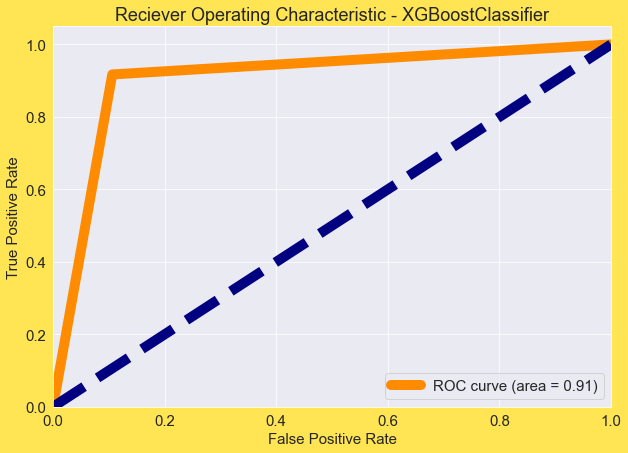

In [214]:
from sklearn.metrics import roc_curve, auc
fpr, tpr, thresholds = roc_curve(pred_xgbc_test,y_test)
roc_auc = auc(fpr,tpr)

plt.figure()
plt.plot(fpr,tpr,color = 'darkorange',lw=10,label = 'ROC curve (area = %0.2f)' % roc_auc)
plt.plot([0,1],[0,1],color = 'navy',lw = 10, linestyle = '--')
plt.xlim([0.0,1.0]) # limitation
plt.ylim([0.0,1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Reciever Operating Characteristic - XGBoostClassifier')
plt.legend(loc='lower right') 
plt.show()

# we can say that our model is working 91% using XGBoostClassifier

## Saving the Model

In [215]:
import pickle
filename = 'tomorrowrainpred.pkl'
pickle.dump(xgbc,open(filename,'wb'))

In [216]:
import numpy as np
a = np.array(y_test)
predicted = np.array(xgbc.predict(x_test))
df_com = pd.DataFrame({'Original':a,'Predicted':predicted},index = range(len(a)))
df_com.sample(20)
# comparison of predicted and original target values

,Original,Predicted
1653,1.0,1
2515,0.0,0
1115,0.0,0
1360,0.0,1
773,0.0,0
2623,1.0,1
1165,0.0,0
2152,1.0,1
576,0.0,0
550,1.0,1


## Now let's go ahead and Create a Regression Model to predict the mm of Rainfall

In [211]:
# We have already created a deep copy of the post imputed data frame
# To use it for doing all the necessary preprocessing techniques and create Regression model
rainfall.head()

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,year,month,day
0,Albury,13.4,22.9,0.6,3.0,13.8,W,44.0,W,WNW,20.0,24.0,71.0,22.0,1007.7,1007.1,8.0,8.0,16.9,21.8,0,0,2008,12,1
1,Albury,7.4,25.1,0.0,2.2,7.6,WNW,44.0,NNW,WSW,4.0,22.0,44.0,25.0,1010.6,1007.8,1.0,4.0,17.2,24.3,0,0,2008,12,2
2,Albury,12.9,25.7,0.0,4.6,7.7,WSW,46.0,W,WSW,19.0,26.0,38.0,30.0,1007.6,1008.7,2.0,2.0,21.0,23.2,0,0,2008,12,3
3,Albury,9.2,28.0,0.0,1.8,8.0,NE,24.0,SE,E,11.0,9.0,45.0,16.0,1017.6,1012.8,8.0,7.0,18.1,26.5,0,0,2008,12,4
4,Albury,17.5,32.3,1.0,3.8,11.9,W,41.0,ENE,NW,7.0,20.0,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,0,0,2008,12,5


In [261]:
rainfall.dtypes

Location          object
MinTemp          float64
MaxTemp          float64
Rainfall         float64
Evaporation      float64
Sunshine         float64
WindGustDir       object
WindGustSpeed    float64
WindDir9am        object
WindDir3pm        object
WindSpeed9am     float64
WindSpeed3pm     float64
Humidity9am      float64
Humidity3pm      float64
Pressure9am      float64
Pressure3pm      float64
Cloud9am         float64
Cloud3pm         float64
Temp9am          float64
Temp3pm          float64
RainToday          int32
RainTomorrow       int32
year               int64
month              int64
day                int64
dtype: object

In [262]:
# removing the outliers
cont_cols.append()

['MinTemp',
 'MaxTemp',
 'Evaporation',
 'Sunshine',
 'WindGustSpeed',
 'WindSpeed9am',
 'WindSpeed3pm',
 'Humidity9am',
 'Humidity3pm',
 'Pressure9am',
 'Pressure3pm',
 'Cloud9am',
 'Cloud3pm',
 'Temp9am',
 'Temp3pm']

In [266]:
# creating a function for ploting outliers
def outlier_check(rainfall,cont_cols):
    # creating a  copy of dataframe
    data = rainfall[cont_cols].copy()
    # subplots 
    fig, axes = plt.subplots(nrows=len(data.columns)//2, ncols=2,figsize=(15,20))
    fig.subplots_adjust(hspace=0.7)
    
    # our main distplot
    for ax, feature in zip(axes.flatten(), data.columns):
        sns.boxplot(data[feature],ax=ax)
        ax.set_title(f'Outliers in {feature}')
    plt.show()
    
# We can see there are many outliers in Rainfall as well but we aren't going to treat it beacause it is our target variable
# We should first remove outliers from the columns and Rainfall as well for only classification model
# For regression model we should not touch Rainfall as it will be our target variable

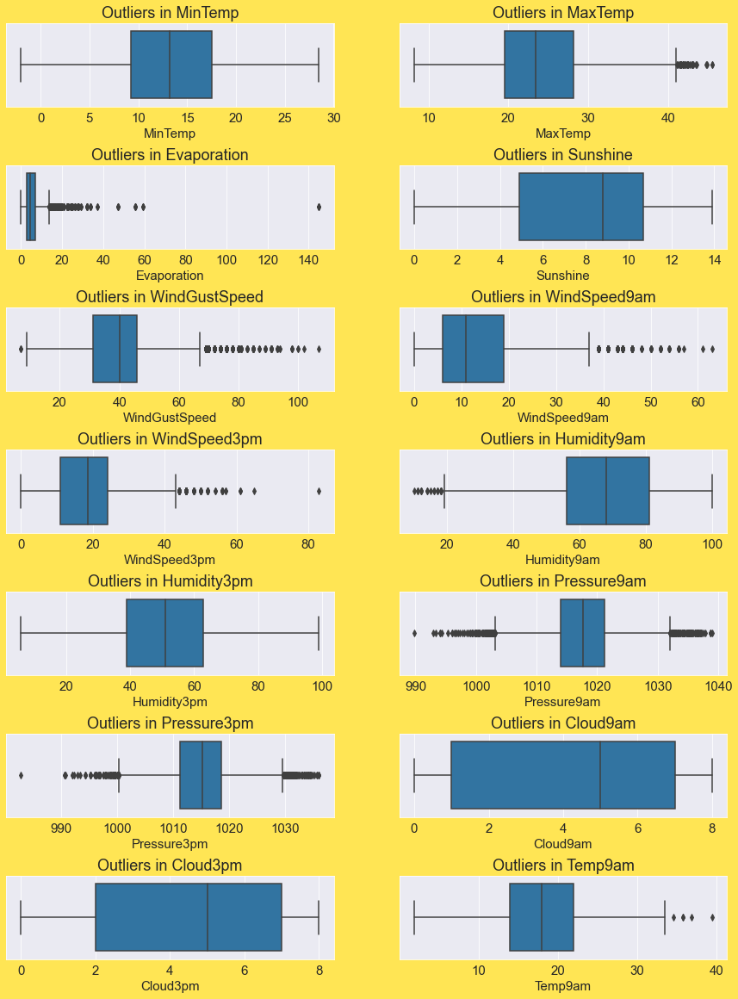

In [267]:
outlier_check(rainfall,cont_cols)

In [268]:
# Removing the outliers using zscore method
# using zscore method
from scipy.stats import zscore

outlier_cols = rainfall[['MinTemp','MaxTemp','Evaporation','Sunshine','WindGustSpeed','WindSpeed9am','WindSpeed3pm','Humidity9am','Humidity3pm','Pressure9am','Pressure3pm','Cloud9am','Cloud3pm','Temp9am','Temp3pm']]

z=np.abs(zscore(outlier_cols))

print(np.where(z>3))


(array([  12,   12,   20,   44,   44,   52,   52,   60,   60,   61,   61,
         62,   62,   62,   67,   67,   68,   68,  123,  123,  159,  168,
        198,  214,  267,  270,  296,  381,  381,  404,  405,  405,  406,
        406,  407,  407,  466,  466,  466,  521,  563,  567,  568,  568,
        569,  602,  603,  632,  683,  683,  748,  748,  795,  809,  884,
        980,  980, 1189, 1527, 1535, 1587, 1644, 1648, 1665, 1749, 1765,
       1782, 1809, 1898, 1903, 1936, 1945, 2016, 2027, 2028, 2043, 2074,
       2164, 2165, 2186, 2193, 2219, 2219, 2230, 2244, 2500, 2505, 2527,
       2527, 2571, 2708, 2746, 2761, 2835, 2855, 2859, 2863, 2869, 2877,
       2883, 2891, 2902, 2905, 2911, 2919, 2933, 2939, 2947, 2953, 2961,
       2967, 2972, 2975, 2989, 3051, 3055, 3058, 3059, 3059, 3060, 3066,
       3067, 3067, 3067, 3068, 3070, 3082, 3082, 3082, 3089, 3089, 3099,
       3099, 3141, 3153, 3153, 3157, 3164, 3167, 3169, 3172, 3172, 3178,
       3206, 3212, 3212, 3213, 3221, 3227, 3234, 3

In [269]:
# removing outliers
rainfall_df = rainfall[(z<3).all(axis=1)]

In [270]:
# checking the % of dataloss after removing the outliers

print("shape before and after")
print("shape before: ",rainfall.shape)
print("shape after: ",rainfall_df.shape)
print("Percentage Loss: ",(rainfall.shape[0]-rainfall_df.shape[0])/rainfall.shape[0]*100)

# We can see there is 4% data loss which is optimal

shape before and after
shape before:  (7724, 25)
shape after:  (7398, 25)
Percentage Loss:  4.220611082340756


In [274]:
# checking and treating the skewness
rainfall_df.skew().sort_values(ascending=False)

# We can see that Evaporation,Sunshine and WindSpeed9am are highly skewed

Rainfall         13.816757
RainTomorrow      1.263199
RainToday         1.255169
Evaporation       1.055517
WindSpeed9am      0.676951
WindGustSpeed     0.487392
Temp3pm           0.345650
year              0.340524
MaxTemp           0.324020
WindSpeed3pm      0.315403
Humidity3pm       0.117027
month             0.056776
Pressure3pm       0.047022
Pressure9am       0.037713
day               0.006885
Temp9am          -0.057588
MinTemp          -0.103581
Cloud3pm         -0.180834
Humidity9am      -0.246068
Cloud9am         -0.278320
Sunshine         -0.557393
dtype: float64

In [276]:
# plotting a distribution plot
def skewness_check(rainfall_df,cont_cols):
    # creating a  copy of dataframe
    data = rainfall_df[cont_cols].copy()
    # subplots 
    fig, axes = plt.subplots(nrows=len(data.columns)//2, ncols=2,figsize=(15,20))
    fig.subplots_adjust(hspace=0.7)
    
    # our main distplot
    for ax, feature in zip(axes.flatten(), data.columns):
        sns.distplot(data[feature],ax=ax)
        ax.set_title(f'Distribution of {feature}')
    plt.show()

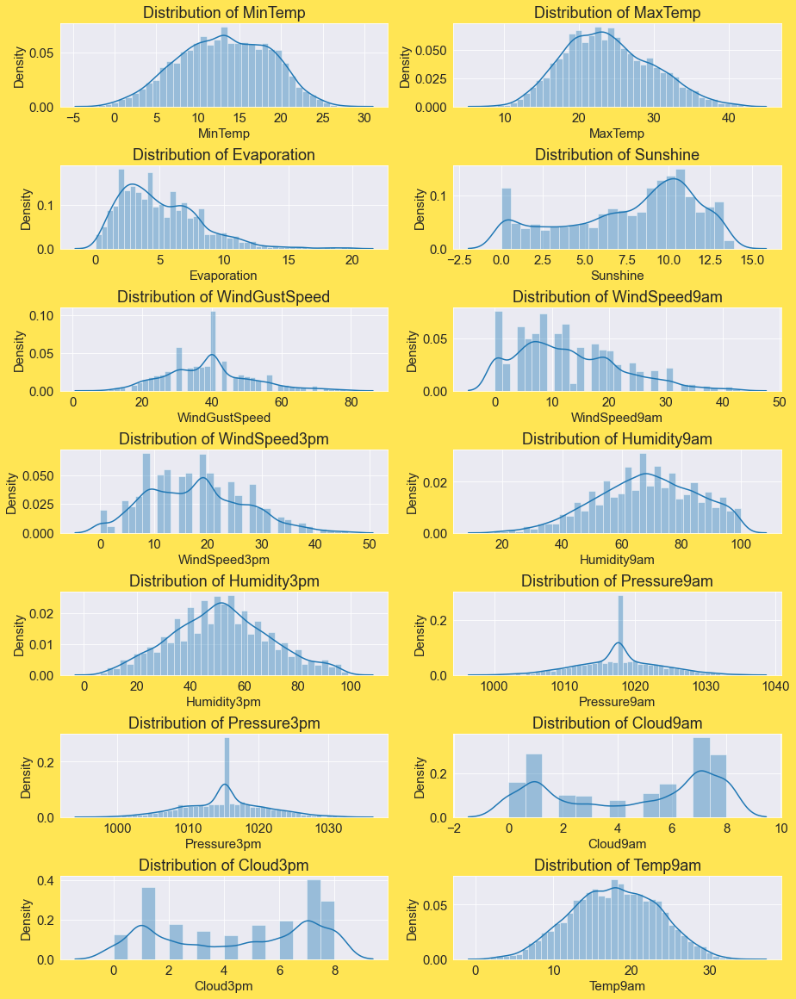

In [277]:
skewness_check(rainfall_df,cont_cols)

In [278]:
#  seperating the skewed columns
skewed_cols =  ['Evaporation','Sunshine','WindSpeed9am']

In [282]:
# using power transform method to remove skewness
from sklearn.preprocessing import PowerTransformer
sc = PowerTransformer(method='yeo-johnson')

In [283]:
rainfall_df[skewed_cols] = sc.fit_transform(rainfall_df[skewed_cols].values)

In [284]:
# checking if the skewness is reduced
rainfall_df[skewed_cols].skew().sort_values()

# We can see that skewness is reduced

Sunshine       -0.075718
WindSpeed9am    0.065087
Evaporation     0.080879
dtype: float64

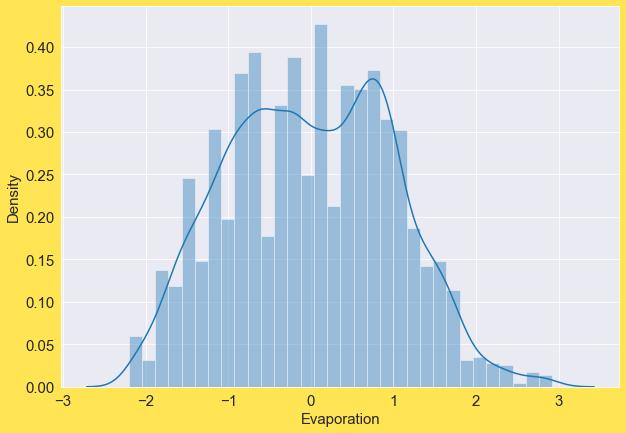

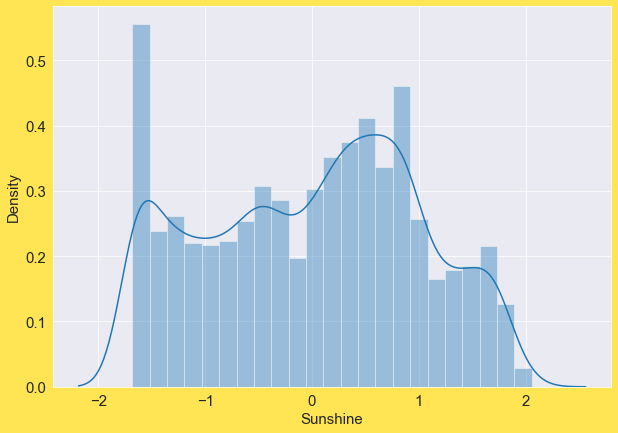

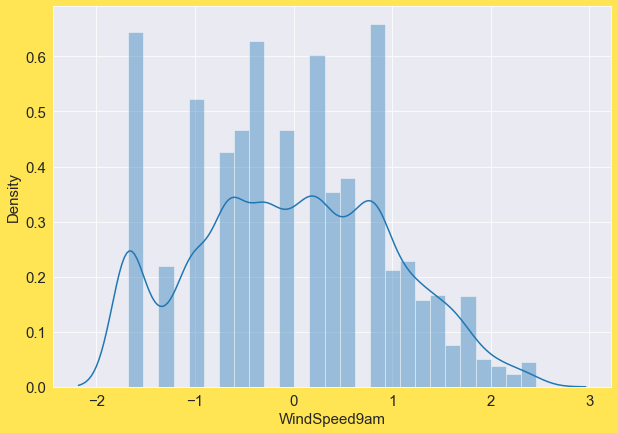

In [285]:
# checking visually
for i in skewed_cols:
    sns.distplot(rainfall_df[i])
    plt.show()
    
# We can see that the distribution has become almost normal

In [286]:
## Encoding the categorical features
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()

In [287]:
cat_cols

['Location', 'WindGustDir', 'WindDir9am', 'WindDir3pm']

In [294]:
# Encoding the features
for i in cat_cols:
    rainfall_df[i] = le.fit_transform(rainfall_df[i])

In [295]:
# check if the features are encoded
rainfall_df.head()

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,year,month,day
0,1,13.4,22.9,0.6,-0.611532,2.011852,13,44.0,13,14,0.865342,24.0,71.0,22.0,1007.7,1007.1,8.0,8.0,16.9,21.8,0,0,2008,12,1
1,1,7.4,25.1,0.0,-0.994280,-0.220527,14,44.0,6,15,-1.030573,22.0,44.0,25.0,1010.6,1007.8,1.0,4.0,17.2,24.3,0,0,2008,12,2
2,1,12.9,25.7,0.0,0.050648,-0.193900,15,46.0,13,15,0.777309,26.0,38.0,30.0,1007.6,1008.7,2.0,2.0,21.0,23.2,0,0,2008,12,3
3,1,9.2,28.0,0.0,-1.197674,-0.111846,4,24.0,9,0,-0.054810,9.0,45.0,16.0,1017.6,1012.8,8.0,7.0,18.1,26.5,0,0,2008,12,4
4,1,17.5,32.3,1.0,-0.262442,1.215056,13,41.0,1,7,-0.585895,20.0,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,0,0,2008,12,5


In [297]:
# CHECKING Correlation

In [298]:
rainfall_df.corr().T

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,year,month,day
Location,1.000000,0.101348,0.048205,0.002508,0.070634,0.044945,-0.031615,0.262006,-0.039250,-0.019602,0.262737,0.244168,0.002309,0.056122,-0.020504,-0.005794,0.039408,0.028798,0.098449,0.044666,0.003065,0.004238,0.476604,-0.088208,-0.005265
MinTemp,0.101348,1.000000,0.715713,0.093338,0.255047,0.056507,-0.157001,0.234904,-0.038531,-0.156200,0.166331,0.192179,-0.109723,0.107148,-0.440359,-0.435002,0.080649,0.048986,0.888376,0.683870,0.085147,0.102048,0.023231,-0.248534,0.013173
MaxTemp,0.048205,0.715713,1.000000,-0.086038,0.323224,0.254388,-0.233092,0.142680,-0.209264,-0.183177,0.027617,0.105736,-0.385662,-0.406168,-0.346015,-0.425045,-0.201102,-0.197285,0.862437,0.974607,-0.213129,-0.152928,0.097119,-0.167568,0.018631
Rainfall,0.002508,0.093338,-0.086038,1.000000,-0.041338,-0.113201,0.031503,0.088048,0.088476,0.033306,0.060600,0.027415,0.227232,0.239621,-0.050572,-0.009047,0.157111,0.127077,-0.003226,-0.090130,0.455929,0.220656,0.001809,-0.020182,-0.013552
Evaporation,0.070634,0.255047,0.323224,-0.041338,1.000000,0.222254,-0.076732,0.152506,-0.064319,-0.023588,0.110419,0.106684,-0.250366,-0.166923,-0.199043,-0.212975,-0.072543,-0.103788,0.307537,0.312336,-0.121909,-0.088757,0.063890,-0.020220,0.001735
Sunshine,0.044945,0.056507,0.254388,-0.113201,0.222254,1.000000,-0.074002,0.026959,-0.060949,-0.037840,0.034539,0.048985,-0.267581,-0.286578,-0.030329,-0.069784,-0.297157,-0.286264,0.184226,0.266692,-0.151311,-0.214344,0.049265,-0.005466,-0.004725
WindGustDir,-0.031615,-0.157001,-0.233092,0.031503,-0.076732,-0.074002,1.000000,0.014419,0.391781,0.501932,0.085476,0.113202,0.027365,0.039721,-0.098845,-0.016133,0.101350,0.074536,-0.183814,-0.244863,0.108411,0.043708,-0.087404,0.036013,0.021044
WindGustSpeed,0.262006,0.234904,0.142680,0.088048,0.152506,0.026959,0.014419,1.000000,-0.058013,0.096961,0.536334,0.616702,-0.251846,-0.079864,-0.374061,-0.332645,0.007993,0.047330,0.206558,0.109399,0.078586,0.177050,-0.009816,0.042375,-0.001179
WindDir9am,-0.039250,-0.038531,-0.209264,0.088476,-0.064319,-0.060949,0.391781,-0.058013,1.000000,0.225304,0.139261,0.064345,0.009991,0.115784,-0.007180,0.073966,0.072924,0.067654,-0.092120,-0.216351,0.145528,0.040588,-0.027733,0.016474,-0.010562
WindDir3pm,-0.019602,-0.156200,-0.183177,0.033306,-0.023588,-0.037840,0.501932,0.096961,0.225304,1.000000,0.053507,0.093567,-0.012678,-0.021452,-0.133027,-0.043453,0.053208,0.044975,-0.170367,-0.194934,0.088063,0.005206,0.004498,0.033778,0.004168


<AxesSubplot:>

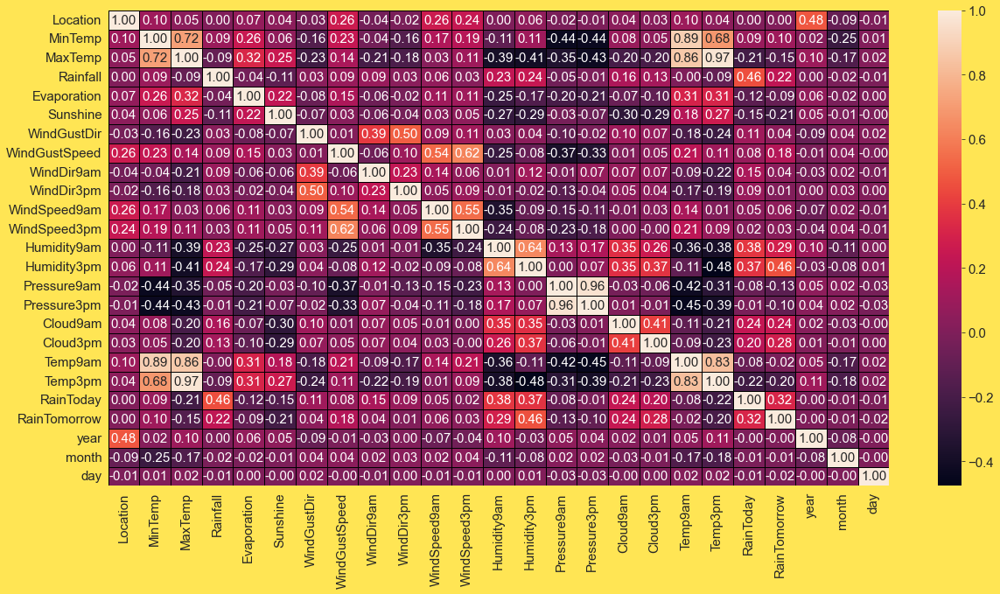

In [299]:
# plotting a heatmap
plt.figure(figsize=(20,10))
sns.heatmap(rainfall_df.corr(),annot=True,linewidths=0.5,linecolor='black',fmt='.2f')

Observations:- 
    
-> Sunshine has a negative correlation of 16% with the target column(being considered) which can be considered as good bond

-> Temp3pm has a negative correlation of 9% with the target column(being considered) which can be considered as weak bond

-> Pressure9am has a negative correlation of 7% with the target column(being considered) which can be considered as weak bond

-> MaxTemp has a negative correlation of 9% with the target column(being considered) which can be considered as weak bond

-> Pressure3pm has a negative correlation of 3% with the target column(being considered) which can be considered as weak bond

-> Temp9am has a negative correlation of 0% with the target column(being considered) which can be considered as NO BOND

-> Date has a positive correlation of 0% with the target column(being considered) which can be considered as NO bond

-> Location has a positive correlation of 0% with the target column(being considered) which can be considered as NO BOND bond

-> Evaporation has a positive correlation of 2% with the target column(being considered) which can be considered as weak bond

-> WindSpeed3pm has a positive correlation of 2% with the target column(being considered) which can be considered as weak bond

-> WindDir3pm has a positive correlation of 4% with the target column(being considered) which can be considered as weak bond

-> WindGustDir has a positive correlation of 4% with the target column(being considered) which can be considered as weak bond

-> WindSpeed9am has a positive correlation of 5% with the target column(being considered) which can be considered as weak bond

-> WindGustSpeed positive correlation of 9% with the target column(being considered) which can be considered as fair bond

-> MinTemp positive correlation of 9% with the target column(being considered) which can be considered as fair bond

-> WindDir9am has a positive correlation of 9% with the target column(being considered) which can be considered as weak bond

-> Cloud3pm positive correlation of 15% with the target column(being considered) which can be considered as good bond

-> Cloud9am positive correlation of 19% with the target column(being considered) which can be considered as good bond

-> RainTomorrow positive correlation of 22% with the target column(being considered) which can be considered as good bond

-> Humidity9am positive correlation of 23% with the target column(being considered) which can be considered as good bond.

-> Humidity3pm positive correlation of 24% with the target column(being considered) which can be considered as good bond

-> RainToday positive correlation of 46% with the target column(being considered) which can be considered as good bond

-> Feature with Maximum correlation = RainToday

-> Features with Minimum correlation = Location, Date and Temp9am



In [300]:
# checking the correlation with respect to Rainfall
rainfall_df.corr()['Rainfall'].sort_values(ascending=False)

# Rainfall today is the highest correlated variable

Rainfall         1.000000
RainToday        0.455929
Humidity3pm      0.239621
Humidity9am      0.227232
RainTomorrow     0.220656
Cloud9am         0.157111
Cloud3pm         0.127077
MinTemp          0.093338
WindDir9am       0.088476
WindGustSpeed    0.088048
WindSpeed9am     0.060600
WindDir3pm       0.033306
WindGustDir      0.031503
WindSpeed3pm     0.027415
Location         0.002508
year             0.001809
Temp9am         -0.003226
Pressure3pm     -0.009047
day             -0.013552
month           -0.020182
Evaporation     -0.041338
Pressure9am     -0.050572
MaxTemp         -0.086038
Temp3pm         -0.090130
Sunshine        -0.113201
Name: Rainfall, dtype: float64

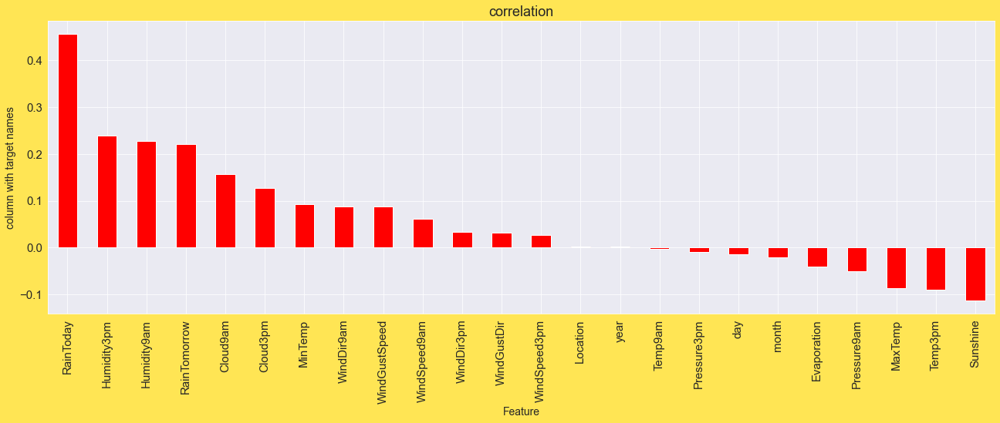

In [301]:
# plotting a barplot to see the same
# Checking the correlation of features with the target colun
plt.figure(figsize=(22,7))
rainfall_df.corr()['Rainfall'].sort_values(ascending=False).drop(['Rainfall']).plot(kind='bar',color='red')
plt.xlabel('Feature',fontsize=14)
plt.ylabel('column with target names',fontsize=14)
plt.title('correlation',fontsize=18)
plt.show()

# dropping

In [302]:
# Seperating the target y
x = rainfall_df.drop(['Rainfall'],axis=1)
y = rainfall_df['Rainfall']

In [303]:
# inorder to check the multicollinearity we have to scale the data
# importing StandardScaler
from sklearn.preprocessing import StandardScaler
sc=StandardScaler()
x = pd.DataFrame(sc.fit_transform(x),columns=x.columns)


In [304]:
# Checking Multicollinearity
from statsmodels.stats.outliers_influence import variance_inflation_factor

In [305]:
# writing a function to return column names and its vif score
def vif_calc():
    vif=pd.DataFrame()
    vif["vif_Features"]=[variance_inflation_factor(x.values, i) for i in range(x.shape[1])]
    vif["Features"]=x.columns
    return vif

In [306]:
vif_calc()

,vif_Features,Features
0,1.588281,Location
1,8.555500,MinTemp
2,25.875203,MaxTemp
3,1.198031,Evaporation
4,1.240013,Sunshine
5,1.598755,WindGustDir
6,2.264054,WindGustSpeed
7,1.332889,WindDir9am
8,1.476772,WindDir3pm
9,1.975006,WindSpeed9am


In [307]:
# dropping MaxTemp and Temp3pm
# And let's check the vif score again
x.drop(['Temp3pm','MaxTemp'],axis=1,inplace=True)

In [308]:
# checking the vif again
vif_calc()

,vif_Features,Features
0,1.586995,Location
1,8.510631,MinTemp
2,1.191170,Evaporation
3,1.238438,Sunshine
4,1.592349,WindGustDir
5,2.248031,WindGustSpeed
6,1.317799,WindDir9am
7,1.475528,WindDir3pm
8,1.963196,WindSpeed9am
9,1.939155,WindSpeed3pm


In [310]:
# Removing the pressure 3 pm as well
x.drop(['Pressure3pm'],axis=1,inplace=True)

In [311]:
vif_calc()

# Multicollinearity is resolved 

,vif_Features,Features
0,1.586204,Location
1,8.400153,MinTemp
2,1.191164,Evaporation
3,1.236752,Sunshine
4,1.584477,WindGustDir
5,2.246376,WindGustSpeed
6,1.288379,WindDir9am
7,1.421665,WindDir3pm
8,1.963148,WindSpeed9am
9,1.921071,WindSpeed3pm


## Model Building

In [319]:
# importing the necessary models,metrics and the methods
from sklearn.linear_model import LinearRegression
from sklearn.svm import SVR
from sklearn.tree import DecisionTreeRegressor
from sklearn.neighbors import KNeighborsRegressor 
from sklearn.linear_model import SGDRegressor
from xgboost import XGBRegressor
from sklearn.ensemble import RandomForestRegressor,AdaBoostRegressor,GradientBoostingRegressor,ExtraTreesRegressor


from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score,mean_squared_error,mean_absolute_error

from sklearn.model_selection import GridSearchCV
from sklearn.pipeline import Pipeline

In [320]:
# creating short instances of the models
lr = LinearRegression()

dtr = DecisionTreeRegressor()

knr = KNeighborsRegressor()

svr = SVR()

sgdr = SGDRegressor()

xgbr = XGBRegressor()

rfr = RandomForestRegressor()

abr = AdaBoostRegressor()

gbr = GradientBoostingRegressor()


## Linear Regression

In [322]:
# CHECKING THE RANDOM STATE FOR LINEAR REGRESSION
lr = LinearRegression()
for i in range(0,500):
    x_train,x_test,y_train,y_test = train_test_split(x,y,test_size=0.30,random_state=i)
    lr.fit(x_train,y_train)
    pred_train = lr.predict(x_train)
    pred_test = lr.predict(x_test)
    if round(r2_score(y_train,pred_train)*100,1) == round(r2_score(y_test,pred_test)*100,1):
        print('At random state',i,'The model performs very well')
        print('At random state:-',i)
        print('Training r2 score is ', round(r2_score(y_train,pred_train)*100,1))
        print('Testing r2 score is ', round(r2_score(y_test,pred_test)*100,1), '\n\n')
        

At random state 0 The model performs very well
At random state:- 0
Training r2 score is  22.6
Testing r2 score is  22.6 


At random state 139 The model performs very well
At random state:- 139
Training r2 score is  22.7
Testing r2 score is  22.7 


At random state 267 The model performs very well
At random state:- 267
Training r2 score is  22.6
Testing r2 score is  22.6 


At random state 351 The model performs very well
At random state:- 351
Training r2 score is  22.6
Testing r2 score is  22.6 




In [323]:
# selecting 412 as best random state
x_train,x_test,y_train,y_test = train_test_split(x,y,test_size=.30,random_state=139)

In [324]:
lr.fit(x_train,y_train)
pred_lr = lr.predict(x_test)
print('Accuracy Score:-',r2_score(y_test,pred_lr))
print('Mean Squared Error:-',mean_squared_error(y_test,pred_lr))
print('Mean Absolute Error:-',mean_absolute_error(y_test,pred_lr))
print('Root Mean Squared Error',np.sqrt(mean_squared_error(y_test,pred_lr)))


# getting very least accuracy

Accuracy Score:- 0.22697312247031654
Mean Squared Error:- 79.45498560205249
Mean Absolute Error:- 3.227236486047765
Root Mean Squared Error 8.913752610548068


In [325]:
# checking Cross Validation for linear regression
from sklearn.model_selection import cross_val_score
lrs = r2_score(y_test,pred_lr)

In [326]:
for i in range(5,15):
    lrcscore = cross_val_score(lr,x,y,cv=i)
    print(lrcscore)
    lsc = lrcscore.mean()
    print('At cv:- ',i)
    print('Cross validation score is:- ',lsc*100)
    print('r2_score is:- ',lrs*100)
    print('\n')

[0.17373638 0.19593789 0.24807062 0.23797569 0.3531064 ]
At cv:-  5
Cross validation score is:-  24.17653972831994
r2_score is:-  22.697312247031654


[0.16259146 0.21663214 0.20526728 0.24914286 0.29214094 0.33308794]
At cv:-  6
Cross validation score is:-  24.314377162463728
r2_score is:-  22.697312247031654


[0.33329069 0.15204346 0.16719243 0.24586113 0.22222547 0.30747358
 0.31796212]
At cv:-  7
Cross validation score is:-  24.94355551160545
r2_score is:-  22.697312247031654


[0.32460426 0.15171165 0.17959827 0.1970502  0.30910119 0.24192921
 0.39716825 0.31553654]
At cv:-  8
Cross validation score is:-  26.458744668249786
r2_score is:-  22.697312247031654


[0.29597232 0.14835454 0.17990592 0.21128536 0.22835053 0.23573923
 0.27089967 0.40870716 0.31932665]
At cv:-  9
Cross validation score is:-  25.53934871196124
r2_score is:-  22.697312247031654


[0.28043264 0.14772428 0.19000208 0.20899927 0.21748587 0.34756752
 0.17797632 0.26946921 0.45741473 0.31216692]
At cv:-  10
Cross

In [327]:
# selecting best cv 4
lrcscore_selected = cross_val_score(lr,x,y,cv=4).mean()
print('The cv score of Linear Regression is ',lrcscore_selected,'\nThe accuracy score of Linear Regression is: ',lrs)

# getting 22% accuracy with linear reg

The cv score of Linear Regression is  0.24309324025442275 
The accuracy score of Linear Regression is:  0.22697312247031654


## DecisionTreeRegressor

In [328]:
# creating parameter grid for dtr
param_grid_dtr = {'criterion':["squared_error", "friedman_mse", "absolute_error","poisson"],
             'splitter':["best", "random"],'max_depth':[2,8,10,None],'max_features':[0.25,0.5,1.0],'min_samples_split':[0.25,0.5,1.0]}

In [329]:
dtr_search = GridSearchCV(dtr,param_grid=param_grid_dtr,error_score='raise')

In [330]:
dtr_search.fit(x_train,y_train)

GridSearchCV(error_score='raise', estimator=DecisionTreeRegressor(),
             param_grid={'criterion': ['squared_error', 'friedman_mse',
                                       'absolute_error', 'poisson'],
                         'max_depth': [2, 8, 10, None],
                         'max_features': [0.25, 0.5, 1.0],
                         'min_samples_split': [0.25, 0.5, 1.0],
                         'splitter': ['best', 'random']})

In [331]:
print(dtr_search.best_score_)
print(dtr_search.best_estimator_)
print(dtr_search.best_params_)

# getting the bestparams

0.24484152622123187
DecisionTreeRegressor(max_features=0.5, min_samples_split=0.25,
                      splitter='random')
{'criterion': 'squared_error', 'max_depth': None, 'max_features': 0.5, 'min_samples_split': 0.25, 'splitter': 'random'}


In [333]:
# Running the model with bestparams
dtr = DecisionTreeRegressor(criterion='squared_error',max_depth=None,max_features=0.5,min_samples_split=0.25,splitter='random') # using the best parameters
dtr.fit(x_train,y_train)
pred_dtr_test= dtr.predict(x_test)
pred_dtr_train = dtr.predict(x_train)
print('Training score of dtr',r2_score(pred_dtr_train,y_train))
print('Accuracy Score of dtr',r2_score(pred_dtr_test,y_test))
print('Mean Squared Error of dtr',mean_squared_error(pred_dtr_test,y_test))
print('Mean Absolute Error of dtr',mean_absolute_error(pred_dtr_test,y_test))
print('Root Mean Squared Error of dtr',np.sqrt(mean_squared_error(pred_dtr_test,y_test)))
print('\n')



Training score of dtr -2.9154429692368717
Accuracy Score of dtr -2.468010635481101
Mean Squared Error of dtr 80.23546144399265
Mean Absolute Error of dtr 2.5702528266175153
Root Mean Squared Error of dtr 8.95742493376264




In [334]:
# checking the cv score for dtr
from sklearn.model_selection import cross_val_score
dtra = r2_score(y_test,pred_dtr_test)

In [335]:
for i in range(5,10):
    dtrscore = cross_val_score(dtr,x,y,cv=i)
    print(dtrscore)
    dtrc = dtrscore.mean()
    print('At cv:- ',i)
    print('Cross validation score is:- ',dtrc*100)
    print('r2_score is:- ',dtra*100)
    print('\n') 
    

[0.15528351 0.18921352 0.09982277 0.093323   0.33687706]
At cv:-  5
Cross validation score is:-  17.490397111289155
r2_score is:-  21.93797814293389


[0.14355763 0.20988195 0.18499013 0.27144819 0.29645752 0.30986248]
At cv:-  6
Cross validation score is:-  23.60329842125143
r2_score is:-  21.93797814293389


[0.29962778 0.12471674 0.15647616 0.23215832 0.24400334 0.16071449
 0.17082819]
At cv:-  7
Cross validation score is:-  19.836071880071596
r2_score is:-  21.93797814293389


[0.30402702 0.06909973 0.18683263 0.04802824 0.30820186 0.24250379
 0.42015118 0.28468978]
At cv:-  8
Cross validation score is:-  23.29417782744962
r2_score is:-  21.93797814293389


[0.26650272 0.04325255 0.16203265 0.16997972 0.21101948 0.09303306
 0.27315158 0.29531115 0.27611878]
At cv:-  9
Cross validation score is:-  19.893352050164502
r2_score is:-  21.93797814293389




In [336]:
# selecting best cv = 9
dtrscore_selected = cross_val_score(dtr,x,y,cv=9).mean()
print('The cv score of DecisionTreeRegressor is ',dtrscore_selected,'\nThe accuracy score of DecisionTreeRegressor is: ',dtra)

# 21% from DTR

The cv score of DecisionTreeRegressor is  0.19805060939300714 
The accuracy score of DecisionTreeRegressor is:  0.2193797814293389


## KNeighborsRegressor

In [337]:
# paramgrid for KNR
param_grid_knr = {'n_neighbors':[2,3,4,5,6,7,8,9,10],'weights':['uniform','distance'],'algorithm':['auto', 'ball_tree','kd_tree','brute'],'leaf_size':[25,30,35,40]}

In [338]:
knr_search = GridSearchCV(knr,param_grid=param_grid_knr)

In [339]:
knr_search.fit(x_train,y_train)

GridSearchCV(estimator=KNeighborsRegressor(),
             param_grid={'algorithm': ['auto', 'ball_tree', 'kd_tree', 'brute'],
                         'leaf_size': [25, 30, 35, 40],
                         'n_neighbors': [2, 3, 4, 5, 6, 7, 8, 9, 10],
                         'weights': ['uniform', 'distance']})

In [340]:
print(knr_search.best_score_)
print(knr_search.best_estimator_)
print(knr_search.best_params_)

0.2980500142356508
KNeighborsRegressor(leaf_size=25, n_neighbors=10, weights='distance')
{'algorithm': 'auto', 'leaf_size': 25, 'n_neighbors': 10, 'weights': 'distance'}


In [342]:
# running the model with bestparams
knr = KNeighborsRegressor(algorithm='auto',leaf_size=25,n_neighbors=10,weights='distance')# using the best parameters
knr.fit(x_train,y_train)
pred_knr_test= knr.predict(x_test)
pred_knr_train = knr.predict(x_train)
print('Training score of knr',r2_score(pred_knr_train,y_train))
print('Accuracy Score of knr',r2_score(pred_knr_test,y_test))
print('Mean Squared Error of knr',mean_squared_error(pred_knr_test,y_test))
print('Mean Absolute Error of knr',mean_absolute_error(pred_knr_test,y_test))
print('Root Mean Squared Error of knr',np.sqrt(mean_squared_error(pred_knr_test,y_test)))
print('\n')

Training score of knr 0.9999999999999947
Accuracy Score of knr -1.1534993424204427
Mean Squared Error of knr 73.11764239085669
Mean Absolute Error of knr 2.376659102189099
Root Mean Squared Error of knr 8.550885474081424




In [343]:
# checking the Cross Validation score
from sklearn.model_selection import cross_val_score
knra = r2_score(y_test,pred_knr_test)
for i in range(5,10):
    knrscore = cross_val_score(knr,x,y,cv=i)
    print(knrscore)
    knrc = knrscore.mean()
    print('At cv:- ',i)
    print('Cross validation score is:- ',knrc*100)
    print('r2_score is:- ',knra*100)
    print('\n') 

[0.20760604 0.24801716 0.34551389 0.18778603 0.48025413]
At cv:-  5
Cross validation score is:-  29.383544950968936
r2_score is:-  28.86298781447909


[0.20755564 0.1024875  0.23877907 0.39119698 0.24268878 0.47929641]
At cv:-  6
Cross validation score is:-  27.700073068250152
r2_score is:-  28.86298781447909


[0.36378276 0.13472714 0.27023223 0.35281985 0.19591568 0.26011795
 0.49130299]
At cv:-  7
Cross validation score is:-  29.555694275334083
r2_score is:-  28.86298781447909


[0.36639146 0.17675821 0.11895963 0.29210907 0.49550147 0.16527975
 0.35519666 0.53326423]
At cv:-  8
Cross validation score is:-  31.293255951680788
r2_score is:-  28.86298781447909


[0.34977802 0.18343369 0.11055694 0.36993297 0.41963101 0.37155584
 0.21706156 0.33308641 0.54292658]
At cv:-  9
Cross validation score is:-  32.19958900159119
r2_score is:-  28.86298781447909




In [344]:
# selecting best cv 6
knrscore_selected = cross_val_score(knr,x,y,cv=6).mean()
print('The cv score of KNeighborsRegressor is ',knrscore_selected,'\nThe accuracy score of KNeighborsRegressor is: ',knra)

# 28% accuracy

The cv score of KNeighborsRegressor is  0.27700073068250153 
The accuracy score of KNeighborsRegressor is:  0.2886298781447909


## SuportVectorRegressor

In [345]:
# creating parametrs for svr
param_grid_svr = {'kernel':['linear', 'poly', 'rbf'],'degree':[4,5,6],'gamma':['scale','auto'],'coef0':[0.3,0.4,0.5]}

In [346]:
svr_search = GridSearchCV(svr,param_grid=param_grid_svr)

In [347]:
svr_search.fit(x_train,y_train)

GridSearchCV(estimator=SVR(),
             param_grid={'coef0': [0.3, 0.4, 0.5], 'degree': [4, 5, 6],
                         'gamma': ['scale', 'auto'],
                         'kernel': ['linear', 'poly', 'rbf']})

In [348]:
print(svr_search.best_score_)
print(svr_search.best_estimator_)
print(svr_search.best_params_)
# getting the best params 

0.36723008456878
SVR(coef0=0.5, degree=6, gamma='auto', kernel='poly')
{'coef0': 0.5, 'degree': 6, 'gamma': 'auto', 'kernel': 'poly'}


In [352]:
# using the best params
svr = SVR(coef0=0.5,degree=6,gamma='auto',kernel='poly')
svr.fit(x_train,y_train)
pred_svr_test= svr.predict(x_test)
pred_svr_train = svr.predict(x_train)
print('Training score of svr',r2_score(pred_svr_train,y_train))
print('Accuracy Score of svr',r2_score(pred_svr_test,y_test))
print('Mean Squared Error of svr',mean_squared_error(pred_svr_test,y_test))
print('Mean Absolute Error of svr',mean_absolute_error(pred_svr_test,y_test))
print('Root Mean Squared Error of svr',np.sqrt(mean_squared_error(pred_svr_test,y_test)))
print('\n')

Training score of svr 0.001061172353225448
Accuracy Score of svr -2.072510446362916
Mean Squared Error of svr 75.61074197110851
Mean Absolute Error of svr 2.390562021899526
Root Mean Squared Error of svr 8.695443747797379




In [353]:
# checking cv score
from sklearn.model_selection import cross_val_score
svra = r2_score(y_test,pred_svr_test)
for i in range(5,10):
    svrscore = cross_val_score(svr,x,y,cv=i)
    print(svrscore)
    svrc = svrscore.mean()
    print('At cv:- ',i)
    print('Cross validation score is:- ',svrc*100)
    print('r2_score is:- ',svra*100)
    print('\n') 

[0.19401459 0.33377277 0.44989853 0.17562504 0.51803533]
At cv:-  5
Cross validation score is:-  33.42692529362212
r2_score is:-  26.437421980831953


[0.1959327  0.18481961 0.53765453 0.3378691  0.2447004  0.5372808 ]
At cv:-  6
Cross validation score is:-  33.97095226369305
r2_score is:-  26.437421980831953


[0.3545968  0.15863959 0.35858581 0.4864158  0.03805161 0.2458966
 0.57163688]
At cv:-  7
Cross validation score is:-  31.626044002352188
r2_score is:-  26.437421980831953


[0.31503447 0.17149325 0.16436078 0.59017478 0.44878005 0.16730573
 0.25921415 0.58755594]
At cv:-  8
Cross validation score is:-  33.798989524714884
r2_score is:-  26.437421980831953


[0.29406303 0.17932644 0.10276453 0.54531367 0.58518574 0.26443743
 0.2540313  0.22679287 0.59094936]
At cv:-  9
Cross validation score is:-  33.80960401115043
r2_score is:-  26.437421980831953




In [354]:
# selecting best cv # We can see that support vector regressor is not working  well
svrscore_selected = cross_val_score(svr,x,y,cv=4).mean()
print('The cv score of SupportVectorRegressor is ',svrscore_selected,'\nThe accuracy score of SuppportVectorRegressor is: ',svra)


The cv score of SupportVectorRegressor is  0.32680888900489535 
The accuracy score of SuppportVectorRegressor is:  0.26437421980831954


## SGDRegressor

In [355]:
# paramgrid for sgdr
paramgrid_sgdr = {'loss':['squared_error','huber','epsilon_insensitive','squared_epsilon_insensitive'],'penalty':['l2', 'l1', 'elasticnet'],
                 'alpha':[0.01,0.001,0.0001,1,10],'l1_ratio':[0.15,0.30,0.45,0.75,1.0],'fit_intercept':[True,False],'max_iter':[1000,1200,1300,1500,1700,2000]}

In [356]:
sgdr_search = GridSearchCV(sgdr,param_grid=paramgrid_sgdr)

In [357]:
sgdr_search.fit(x_train,y_train)

GridSearchCV(estimator=SGDRegressor(),
             param_grid={'alpha': [0.01, 0.001, 0.0001, 1, 10],
                         'fit_intercept': [True, False],
                         'l1_ratio': [0.15, 0.3, 0.45, 0.75, 1.0],
                         'loss': ['squared_error', 'huber',
                                  'epsilon_insensitive',
                                  'squared_epsilon_insensitive'],
                         'max_iter': [1000, 1200, 1300, 1500, 1700, 2000],
                         'penalty': ['l2', 'l1', 'elasticnet']})

In [358]:
print(sgdr_search.best_score_)
print(sgdr_search.best_estimator_)
print(sgdr_search.best_params_)
# getting the best params

0.26331104821083723
SGDRegressor(alpha=0.001, l1_ratio=0.45, max_iter=1300, penalty='l1')
{'alpha': 0.001, 'fit_intercept': True, 'l1_ratio': 0.45, 'loss': 'squared_error', 'max_iter': 1300, 'penalty': 'l1'}


In [361]:
# using the best params
sgdr = SGDRegressor(alpha=0.001,l1_ratio=0.45, loss='squared_error',penalty='l1',fit_intercept=True,max_iter=1300)
sgdr.fit(x_train,y_train)
pred_sgdr_test= sgdr.predict(x_test)
pred_sgdr_train = sgdr.predict(x_train)
print('Training score of sgdr',r2_score(pred_sgdr_train,y_train))
print('Accuracy Score of sgdr',r2_score(pred_sgdr_test,y_test))
print('Mean Squared Error of sgdr',mean_squared_error(pred_sgdr_test,y_test))
print('Mean Absolute Error of sgdr',mean_absolute_error(pred_sgdr_test,y_test))
print('Root Mean Squared Error of sgdr',np.sqrt(mean_squared_error(pred_sgdr_test,y_test)))
print('\n')


Training score of sgdr -2.3315351303307974
Accuracy Score of sgdr -1.986765666446277
Mean Squared Error of sgdr 79.87455015400614
Mean Absolute Error of sgdr 3.337051106377009
Root Mean Squared Error of sgdr 8.937256298999495




In [362]:
# checking cv score
from sklearn.model_selection import cross_val_score
sgdra = r2_score(y_test,pred_sgdr_test)
for i in range(5,10):
    sgdrscore = cross_val_score(sgdr,x,y,cv=i)
    print(sgdrscore)
    sgdrc = sgdrscore.mean()
    print('At cv:- ',i)
    print('Cross validation score is:- ',sgdrc*100)
    print('r2_score is:- ',sgdra*100)
    print('\n') 

[0.16568146 0.19586482 0.25143757 0.21031227 0.35053444]
At cv:-  5
Cross validation score is:-  23.47661115622736
r2_score is:-  22.28911297160382


[0.16734199 0.21698865 0.20434074 0.22969979 0.29160327 0.32914687]
At cv:-  6
Cross validation score is:-  23.985355219108236
r2_score is:-  22.28911297160382


[0.33384834 0.157956   0.16874672 0.24378388 0.0132938  0.3097868
 0.31769646]
At cv:-  7
Cross validation score is:-  22.07302870631656
r2_score is:-  22.28911297160382


[0.32439361 0.13860757 0.16077321 0.19238072 0.28582286 0.24639484
 0.38974185 0.31090589]
At cv:-  8
Cross validation score is:-  25.612757011230407
r2_score is:-  22.28911297160382


[0.30136968 0.14839036 0.18660724 0.20953191 0.22685099 0.24622841
 0.26560774 0.39398528 0.31427491]
At cv:-  9
Cross validation score is:-  25.476072542763962
r2_score is:-  22.28911297160382




In [363]:
# selecting best cv 7
sgdrscore_selected = cross_val_score(sgdr,x,y,cv=7).mean()
print('The cv score of SGDRegressor is ',sgdrscore_selected,'\nThe accuracy score of SGDRegressor is: ',sgdra)


The cv score of SGDRegressor is  0.2442067220221813 
The accuracy score of SGDRegressor is:  0.2228911297160382


### Ensemble Methods

## RandomForestRegressor

In [364]:
#  paramgrid for RFR
param_grid_rfr = {'n_estimators':[x for x in range(100,200,10)],'criterion':["squared_error","absolute_error","poisson"],'min_samples_split':[2,4,6,7,0.18],
                 'max_features':["sqrt","log2",None],'bootstrap':[True,False],'min_samples_leaf':[1,2,3,4,0.18]}

In [365]:
rfr_search = GridSearchCV(rfr,param_grid=param_grid_rfr)

In [368]:
# running the model with best params
rfr = RandomForestRegressor(n_estimators=100,max_features=None,min_samples_leaf=2,min_samples_split=4,bootstrap=True,criterion='squared_error')
rfr.fit(x_train,y_train)
pred_rfr_test= rfr.predict(x_test)
pred_rfr_train = rfr.predict(x_train)
print('Training score of rfr',r2_score(pred_rfr_train,y_train))
print('Accuracy Score of rfr',r2_score(pred_rfr_test,y_test))
print('Mean Squared Error of rfr',mean_squared_error(pred_rfr_test,y_test))
print('Mean Absolute Error of rfr',mean_absolute_error(pred_rfr_test,y_test))
print('Root Mean Squared Error of rfr',np.sqrt(mean_squared_error(pred_rfr_test,y_test)))
print('\n')


Training score of rfr 0.5662350655715366
Accuracy Score of rfr -0.5836575051879525
Mean Squared Error of rfr 77.61888341479282
Mean Absolute Error of rfr 2.4156193951701597
Root Mean Squared Error of rfr 8.810157967641262




In [369]:
# checking cv score
from sklearn.model_selection import cross_val_score
rfra = r2_score(y_test,pred_rfr_test)
for i in range(5,10):
    rfrscore = cross_val_score(rfr,x,y,cv=i)
    print(rfrscore)
    rfrc = rfrscore.mean()
    print('At cv:- ',i)
    print('Cross validation score is:- ',rfrc*100)
    print('r2_score is:- ',rfra*100)
    print('\n') 

[0.20140643 0.35358898 0.35785164 0.10393888 0.1157999 ]
At cv:-  5
Cross validation score is:-  22.65171663927407
r2_score is:-  24.483677608359088


[0.2046574  0.19029245 0.46127299 0.46275428 0.23467723 0.02310512]
At cv:-  6
Cross validation score is:-  26.279324295665106
r2_score is:-  24.483677608359088


[0.40881801 0.1505093  0.39214057 0.53465541 0.09497908 0.24491908
 0.0405815 ]
At cv:-  7
Cross validation score is:-  26.665756485817116
r2_score is:-  24.483677608359088


[ 0.36646561  0.16111016  0.1504888   0.52191668  0.57523417  0.20789205
 -0.43147515  0.42763331]
At cv:-  8
Cross validation score is:-  24.740820278971942
r2_score is:-  24.483677608359088


[ 0.35296434  0.16785449  0.12704436  0.61283209  0.6419044   0.43585536
  0.27877163 -0.4643831   0.44134506]
At cv:-  9
Cross validation score is:-  28.824318050173908
r2_score is:-  24.483677608359088




In [370]:
# selecting best cv 8
rfrscore_selected = cross_val_score(rfr,x,y,cv=8).mean()
print('The cv score of RandomForestRegressor is ',rfrscore_selected,'\nThe accuracy score of RandomForestRegressor is: ',rfra)

# 24% accuracy

The cv score of RandomForestRegressor is  0.26427136135437534 
The accuracy score of RandomForestRegressor is:  0.2448367760835909


## AdaBoostRegressor

In [371]:
# creating parametergrid for AdaBoostR
param_grid_abr = {'loss':['linear', 'square', 'exponential'],'n_estimators':[50,60,80],'learning_rate':[0.5,1.5]}

In [372]:
abr_search = GridSearchCV(abr,param_grid=param_grid_abr)

In [373]:
abr_search.fit(x_train,y_train)

GridSearchCV(estimator=AdaBoostRegressor(),
             param_grid={'learning_rate': [0.5, 1.5],
                         'loss': ['linear', 'square', 'exponential'],
                         'n_estimators': [50, 60, 80]})

In [374]:
print(abr_search.best_score_)
print(abr_search.best_estimator_)
print(abr_search.best_params_)

# getting the best params

0.31255953609629195
AdaBoostRegressor(learning_rate=0.5, loss='square')
{'learning_rate': 0.5, 'loss': 'square', 'n_estimators': 50}


In [376]:
# using the best params
abr = AdaBoostRegressor(learning_rate=0.5,loss='square',n_estimators=50)
abr.fit(x_train,y_train)
pred_abr_test= abr.predict(x_test)
pred_abr_train = abr.predict(x_train)
print('Training score of abr',r2_score(pred_abr_train,y_train))
print('Accuracy Score of abr',r2_score(pred_abr_test,y_test))
print('Mean Squared Error of abr',mean_squared_error(pred_abr_test,y_test))
print('Mean Absolute Error of abr',mean_absolute_error(pred_abr_test,y_test))
print('Root Mean Squared Error of abr',np.sqrt(mean_squared_error(pred_abr_test,y_test)))
print('\n')


Training score of abr 0.4268521014186575
Accuracy Score of abr -1.9244872517586042
Mean Squared Error of abr 83.36808435639067
Mean Absolute Error of abr 3.078542926920462
Root Mean Squared Error of abr 9.130612485282171




In [377]:
# checking cv score
from sklearn.model_selection import cross_val_score
abra = r2_score(y_test,pred_abr_test)
for i in range(5,10):
    abrscore = cross_val_score(abr,x,y,cv=i)
    print(abrscore)
    abrc = abrscore.mean()
    print('At cv:- ',i)
    print('Cross validation score is:- ',abrc*100)
    print('r2_score is:- ',abra*100)
    print('\n') 

[ 0.16505821  0.35279623 -0.0129087  -0.12754834  0.21066249]
At cv:-  5
Cross validation score is:-  11.761197625546318
r2_score is:-  18.89021255579063


[ 0.16786063  0.16271414  0.27112337 -0.05671516  0.04959934  0.40552585]
At cv:-  6
Cross validation score is:-  16.668469393905795
r2_score is:-  18.89021255579063


[ 0.2026265   0.14797734  0.31389968  0.34171596 -0.26851113  0.09360224
  0.304967  ]
At cv:-  7
Cross validation score is:-  16.23253687688606
r2_score is:-  18.89021255579063


[ 0.12903149  0.14919167 -0.04202499  0.25798368 -0.10870531  0.03775805
  0.08733028  0.31699321]
At cv:-  8
Cross validation score is:-  10.3444759661434
r2_score is:-  18.89021255579063


[ 0.18985099  0.14543475 -0.09926694  0.16733425  0.41803566 -0.04109036
 -0.00617012 -0.14936784  0.41065341]
At cv:-  9
Cross validation score is:-  11.504597823358326
r2_score is:-  18.89021255579063




In [378]:
# selecting best cv 6
abrscore_selected = cross_val_score(abr,x,y,cv=6).mean()
print('The cv score of AdaBoostRegressor is ',abrscore_selected,'\nThe accuracy score of AdaBoostRegressor is: ',abra)


The cv score of AdaBoostRegressor is  0.14808526868272778 
The accuracy score of AdaBoostRegressor is:  0.1889021255579063


## Model Selection

In [379]:
models = pd.DataFrame({'Model Name':['Linear Regression','DecisionTreeRegressor','RandomForestRegressor','AdaBoostRegressor','KNeighborsRegressor','SGDRegressor','SupportVectorRegressor'],
                       'Accuracy':[lrs,dtra,rfra,abra,knra,sgdra,svra],
                       'CV_Score':[lrcscore_selected,dtrscore_selected,rfrscore_selected,abrscore_selected,knrscore_selected,sgdrscore_selected,svrscore_selected]})
models

,Model Name,Accuracy,CV_Score
0,Linear Regression,0.226973,0.243093
1,DecisionTreeRegressor,0.219380,0.198051
2,RandomForestRegressor,0.244837,0.264271
3,AdaBoostRegressor,0.188902,0.148085
4,KNeighborsRegressor,0.288630,0.277001
5,SGDRegressor,0.222891,0.244207
6,SupportVectorRegressor,0.264374,0.326809


In [380]:
# We got all the very low accuracy score for all the models
# Selecting KNeighborsRegressor

## SAVING THE MODEL

In [381]:
import pickle
filename='Rainfall_pred.pkl'
pickle.dump(knr,open(filename,'wb'))

In [382]:
import numpy as np
a = np.array(y_test)
predicted = np.array(knr.predict(x_test))
df_com = pd.DataFrame({'Original':a,'Predicted':predicted},index = range(len(a)))
df_com.sample(20)
# comparison of predicted and original value

,Original,Predicted
752,2.1,9.085600
523,0.0,0.000000
1246,5.0,12.162199
1836,14.2,7.485719
344,0.0,0.000000
1209,0.0,0.000000
185,0.0,0.040970
1901,0.0,0.000000
639,5.6,5.956573
1674,0.0,0.000000
